<table width="100%">
<tr>
    <td>
        <h1 style="text-align: left; font-size:300%;">
            DrugRepurposing
        </h1>
        <h1 style="text-align: left; font-size:150%;">
            Automated drug repurposing workflow for rare diseases – using Flask, Monarch API, DGIdb API and XGboost
        </h1> 
    </td>
    <td width="33%">
        <div style="text-align: right">
            <b> A GitHub repository by Niccolò Bianchi</b> <br>
            <a href="https://github.com/NCMBianchi/DrugRepurposing">github.com/NCMBianchi/DrugRepurposing</a><br>
            forked from Carmen Reep's and Nuria Queralt Rosinach's works<br>
        </div>
    </td>
</tr>
</table>

This notebook is meant to implement variations of the functions originally stored in the 'Monarch.py' file, in order to solve some of the issues that do not allow the tool to run.

Once a new pipeline is developed, a new version of the 'Monarch.py' file will be implemented. Step by step all other parts of the entire pipeline involving steps in 'DGIdb.py', 'drugsimilarity.py' and so on will be tested here as well.

![](./PIPELINE_images/github_header.png)

## 1. SETUP

The first step just returns the kernel and Python version to be sure about using the appropriate one -while also setting up some basic logging functions.

In [1]:
import sys,os,platform,datetime,logging,builtins,time,multiprocessing,copy
python_executable = sys.executable
python_version = platform.python_version()
num_cores = multiprocessing.cpu_count()

# this toggle can be used to run based on data downloaded and computed in another day: this can save time
date_toggle = 1
date_override = datetime.date(2024, 7, 31)

In [2]:
# timestamp
if date_toggle == 0:
    today = datetime.date.today()
elif date_toggle == 1:
    today = date_override
actual_today = datetime.date.today()
date_str = today.strftime('%Y-%m-%d')
curr_year = int(str(today)[:4])
overall_start_time = time.time()
formatted_start_time = datetime.datetime.now().strftime("%H:%M:%S")
print(f"'DrugRepurposing' pipeline started at {formatted_start_time}.\n")

# directory set-up
base_data_directory = os.path.join(os.getcwd(), 'drugapp', 'data')
today_directory = os.path.join(base_data_directory, date_str)
os.makedirs(today_directory, exist_ok=True)
disease_name_label = None
## just a placeholder: the aim is to replace it after running run_monarch_api()
## on the first seed

# logging configuration
platform_filename = "running_platform.txt"
platform_file_path = os.path.join(today_directory, platform_filename)
log_filename = "logfile.log"
log_file_path = os.path.join(today_directory, log_filename)
input_filename = "inputs.txt"
input_file_path = os.path.join(today_directory, input_filename)
logger = logging.getLogger()
logger.setLevel(logging.DEBUG)  # highest level to capture all logs
file_handler = logging.FileHandler(log_file_path)
file_handler.setLevel(logging.DEBUG)
file_handler.setFormatter(logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s'))
console_handler = logging.StreamHandler()
console_handler.setLevel(logging.ERROR)  # only log errors to the console
console_handler.setFormatter(logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s'))
if not logger.handlers:
    logger.addHandler(file_handler)
    logger.addHandler(console_handler)

def current_function_name():
    return inspect.currentframe().f_back.f_code.co_name

# 'w' instead of 'a' here to always overwrite when making a new run
with open(platform_file_path, 'w') as file:
    file.write(f"Run date (real): {actual_today}\n\n")
    file.write(f"Python kernel: {python_executable}\n")
    file.write(f"Python version: {python_version}\n")
    file.write(f"The current machine has {num_cores} CPU cores.\n")
    file.write("\n\n")

print("Python kernel:", python_executable)
print("Python version:", python_version)
print(f"The current machine has {num_cores} CPU cores.")

'DrugRepurposing' pipeline started at 14:31:47.

Python kernel: /Users/ncmbianchi/miniconda3/bin/python3.11
Python version: 3.11.9
The current machine has 10 CPU cores.


The **list of packages** along with the version used is stored in the same *.txt* file where kernel location and version of Python written earlier.

In [3]:
# empty set to store the packages that will be imported:
imported_packages = {}
from importlib.metadata import version
from importlib import import_module

def import_and_log(*args):
    """
    Import a package or a component from a package and log it along 
    with its version immediately.
    """
    try:
        
        # Importing based on the number of arguments:
        # if 1 argument, 'import <arg_1>' (whole package)
        if len(args) == 1:
            package_name = args[0]
            package = import_module(package_name)
            imported_packages[package_name] = package
            setattr(builtins, package_name, package)  # globally available
            msg = f"Package '{package_name}' imported."
            
        # if 2 arguments, 'from <arg_1> import <arg_2>' (component from a package)
        elif len(args) == 2:
            package_name, component_name = args
            package = import_module(package_name)
            component = getattr(package, component_name)
            imported_packages[f"{package_name}.{component_name}"] = component
            setattr(builtins, component_name, component)  # globally available
            msg = f"Component '{component_name}' from package '{package_name}' imported."
        else:
            raise ValueError("Invalid number of arguments passed to import_and_log().")
        
        print(msg)  # Print import confirmation
        log_imports_and_versions(msg)  # Log the import and its version
        
    except ImportError as e:
        print(f"Failed to import {args}. Error: {e}")
    except AttributeError as e:
        print(f"Component '{args[1]}' not found in package '{args[0]}'. Error: {e}")

def log_imports_and_versions(message):
    """
    Append import messages and version information of the most
    recently imported package to a file.
    """
    with open(platform_file_path, 'a') as file:
        # Write the message about what was just imported
        file.write(f"{message} ")
        
        # Identify the last imported package or component
        if imported_packages:
            full_name = list(imported_packages.keys())[-1]  # Get the last key in the dictionary
            package_name = full_name.split('.')[0]  # Only use the top-level package name for version retrieval
            try:
                if package_name == 'sklearn':
                    package_name = 'scikit-learn'
                pkg_version = version(package_name)
                version_info = f"(version: {pkg_version})"
            except Exception as e:
                version_info = f"(version not found for {package_name}: {e})"
            
            # Write the latest version info to the file and print it
            file.write(f"{version_info}\n\n")
            print(version_info)

In [4]:
import tqdm
import re
import json  # to save .json files returned by the API
import logging  # to check for running variables
import inspect  # to check for running functions
import shutil  # to properly copy and rename files in run_monarch_mock()
import ast  # for syntax trees in 'DGIdb.py' steps
from unittest.mock import Mock  # to reverse requests.Response()
import pickle

# only non-core packages are loaded with the 'import_and_log()' function:
import_and_log('pandas')  # for general object handling
import_and_log('numpy')  # for general operations
import_and_log('requests')  # for several API calls
import_and_log('networkx')  # for ' Monarch.py' to plot the network
import_and_log('matplotlib')  # for ' Monarch.py' to plot the network
import_and_log('biothings_client','get_client') # for several API calls
import_and_log('rdkit','Chem')  # for 'drugsimilarity.py'
import_and_log('rdkit','RDLogger')  # for 'drugsimilarity.py'
import_and_log('rdkit','DataStructs')  # for 'drugsimilarity.py'
import_and_log('SPARQLWrapper','SPARQLWrapper') # for 'drugsimilarity.py' (NEW)
import_and_log('SPARQLWrapper','JSON') # for 'drugsimilarity.py' (NEW)
import_and_log('node2vec','Node2Vec')  # for 'network_model.py'
import_and_log('sklearn')  # for 'network_model.py'
import_and_log('xgboost','XGBClassifier')  # for 'network_model.py'
import_and_log('scipy','stats')  # for 'network_model.py'
import_and_log('IPython','display')  # for 'network_model.py'

# for ease of use, some packages are reloaded with an alias
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
mc = get_client('chem')

# these submodules are imported normally as the main versions are already logged,
# and importlib.import_module() doesn't handle well submodules
from rdkit.Chem import AllChem  # older version, do not place in REQUIREMENTS.txt
from rdkit.Chem import Draw
from rdkit.Chem import rdFingerprintGenerator # instead of AllChem
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from sklearn.utils import class_weight
from scipy.stats import uniform
from IPython.display import HTML,Image,display

## REMEMBER that 'sklearn' is used to call the package otherwise installed as
## 'scikit-learn': the old PyPi 'sklearn' is deprecated 

Package 'pandas' imported.
(version: 2.1.2)
Package 'numpy' imported.
(version: 1.26.4)
Package 'requests' imported.
(version: 2.31.0)
Package 'networkx' imported.
(version: 2.8.8)
Package 'matplotlib' imported.
(version: 3.8.0)
Component 'get_client' from package 'biothings_client' imported.
(version: 0.3.1)
Component 'Chem' from package 'rdkit' imported.
(version: 2024.3.1)
Component 'RDLogger' from package 'rdkit' imported.
(version: 2024.3.1)
Component 'DataStructs' from package 'rdkit' imported.
(version: 2024.3.1)
Component 'SPARQLWrapper' from package 'SPARQLWrapper' imported.
(version: 2.0.0)
Component 'JSON' from package 'SPARQLWrapper' imported.
(version: 2.0.0)


/Users/ncmbianchi/miniconda3/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Component 'Node2Vec' from package 'node2vec' imported.
(version: 0.4.6)
Package 'sklearn' imported.
(version: 1.4.2)
Component 'XGBClassifier' from package 'xgboost' imported.
(version: 2.0.3)
Component 'stats' from package 'scipy' imported.
(version: 1.12.0)
Component 'display' from package 'IPython' imported.
(version: 8.23.0)


## 2. ```MONARCH.py```: BIOLOGICAL ASSOCIATIONS

First let's set-up the function used to make API calls.

**Paths are currently set starting outside the drugapp directory, while later when implemented as .py scripts, paths will be adapted a bit.**

In [5]:
def hit_monarch_api(seed='MONDO:0007739',rows=2000,direct_true=1):
    """
    Originally part of NQR's "bioknowledgeReviewer" tool.
    
    This function performs API calls to Monarch to retrieve 'OUT' and 'IN' edges from a query node.
    It retrieves entities plus associations via the Monarch Initiative new V3 API (2023 onward).
    
    The original version used the older Biolink API, no longer supported:
    https://api-biolink.monarchinitiative.org/api/association
     
    Moreover:
       - Biolink supported 'OMIM:' URIs, V3 doesn't and 'MONDO:' is used
       - Biolink required 'association/____', V3 requires 'association?____='
       - Biolink supported the ":" character, V3 requires its ASCII version (i.e.%3A)
       
    It hits two endpoints:
       - association?subject= (for 'OUT' edges)
       - association?object= (for 'IN' edges)
    It returns 'OUT' and 'IN' edges.

    :param node: node ID to query (string) (default = 'MONDO:0007739' for Huntington's Disease).
    :param rows: the maximum number of results to return (integer) (default = 2000).
    :param direct_true: if ==1 then 'direct=True' is added to the API call URL to filter out all URI aliases
    :return: two API response objects: 'OUT' and 'IN' response objects, in this order.
    """
    
    logging.info(f"NOW RUNNING: {current_function_name()} with seed {seed}.")

    # API address
    biolink = 'https://api-v3.monarchinitiative.org/v3/api/association'  #V3
    seed_new = seed.split(':')
    seed_call = seed_new[0]+'%3A'+seed_new[1]

    # parameters
    parameters = {'fl_excludes_evidence': False, 'rows': rows}

    # OUT edges API call  ('?subject=')
    if direct_true == 1:
        out_url = f'{biolink}?subject={seed_call}&direct=true'
    elif direct_true == 0:
        out_url = f'{biolink}?subject={seed_call}'
    r_out = requests.get(out_url, params=parameters)  # API call
    logging.info(f"Out edges request URL: {out_url} with parameters {parameters}")
    logging.info(f"Out edges response status: {r_out.status_code}")

    # IN edges API call (?object=)
    if direct_true == 1:
        in_url = f'{biolink}?object={seed_call}&direct=true'
    elif direct_true == 0:
        in_url = f'{biolink}?object={seed_call}'
    r_in = requests.get(in_url, params=parameters)  # API call
    logging.info(f"In edges request URL: {in_url} with parameters {parameters}")
    logging.info(f"In edges response status: {r_in.status_code}")

    # Error Handling for API responses
    if not r_out.ok or not r_in.ok:
        error_message = f"Error fetching data for seed {seed}: OUT status {r_out.status_code}, IN status {r_in.status_code}"
        logging.error(error_message)
        # Handle error appropriately, could raise an exception or return an error code
        raise Exception(error_message)
    
    # (eventually) create disease directory
    r_out_json = r_out.json()
    r_in_json = r_in.json()
    if seed == input_seed[0]:
        if 'items' in r_out_json and r_out_json['items']:   # identify 'name' and 'id'
            disease_name = r_out_json['items'][0]['subject_label']
            disease_id = r_out_json['items'][0]['subject']
        else:
            logging.warning("Warning: 'associations' key not found in response or no associations present.")
            return None, None
        disease_directory = os.path.join(today_directory, f'{disease_name} ({date_str})')
        os.makedirs(disease_directory, exist_ok=True)  # the date is repeated just for archival purposes
        disease_id_file_path = os.path.join(disease_directory, 'disease_id.txt')
        with open(disease_id_file_path, "w") as text_file:
            
            # store 'disease_name' and 'disease_id'
            text_file.write(f"{disease_id};{disease_name}\n")
            
            # store the list of subject closure for the input_seed
            # (information on the ontology of the disease)
            text_file.write(f"Subject closure:{r_out_json['items'][0]['subject_closure']}")
            logging.info(f"Information on the disease saved to {disease_id_file_path}")
            
    else:
        disease_id = disease_id_label
        disease_name = disease_name_label
        disease_directory = os.path.join(today_directory, f'{disease_name} ({date_str})')
    monarch_directory = os.path.join(disease_directory, 'monarch')
    seed_new = seed.split(':')
    seed_dir = seed_new[0]+'_'+seed_new[1]
    seed_directory = os.path.join(monarch_directory, seed_dir)
    os.makedirs(seed_directory, exist_ok=True)
    
    # store OUT .json file
    out_file_path = os.path.join(seed_directory, f'{seed_dir}_api_response_OUT.json')
    if r_out.ok:
        with open(out_file_path, 'w') as json_file:
            json.dump(r_out_json, json_file)
        logging.info(f"API response saved to {out_file_path}")
    else:
        logging.error(f"Failed to fetch OUT edges: {r_out.status_code} - {r_out.reason}")

    # store IN .json file
    in_file_path = os.path.join(seed_directory, f'{seed_dir}_api_response_IN.json')
    if r_in.ok:
        with open(in_file_path, 'w') as json_file:
            json.dump(r_in_json, json_file)
        logging.info(f"API response saved to {in_file_path}")
    else:
        logging.error(f"Failed to fetch IN edges: {r_in.status_code} - {r_in.reason}")
    
    return r_out, r_in, disease_id, disease_name

In [6]:
input_seed = ['MONDO:0007739']
r_out, r_in, disease_id_label, disease_name_label = hit_monarch_api()
print(r_out)

<Response [200]>


The test-run above uses a hardcoded variable for 'MONDO:0007739' URI identifier for Huntington's disease –but let's assume that in the actual pipeline it uses variable ```input``` provided by the flaskApp. Due to issues with Monarch sometimes adding too many disease aliases to API calls (*i.e.* Juvenile Huntington Disease when looking for HD), parameter 'direct_true' was added according to: https://github.com/monarch-initiative/monarch-app/issues/761

**Status ```<Response [200]>``` means that the http-request went fine.**

Files are stored according to this tree like structure:

![](./PIPELINE_images/json_tree.png)

Any subsequent run of ```hit_monarch_api()``` doesn't create new subdirectories -if in the same pipeline- while instead storing .json files within the same **.../YYYY-MM-DD/disease YYYY-MM-DD/monarch** directory.

Variables ```disease_id_label``` and ```disease_name_label``` are always returned in order to store as global variables information required for path buildings in some of the functions.

Objects ```r_out``` and ```r_in``` that are returned contain the .json output as a single string.

Then let's define the function that builds the first layer of neighbours and relations: my intention is to make a new version that can handle both one single seed (as in the first layer) or a list of seeds (as in the second and third layer), while also checking if the call for those given sees has already been run: if not, it runs ```hit_monarch_api()``` again; otherwise it retrieves data from the directory corresponding with that seed ID.

In [7]:
def unique_elements(nonUnique_list):
    """
    Short function that remove duplicate elements.
    If the list contains nodes, it will simply convert it into a set{}.
    If the list contains edges, it will remove also edges where subject and object
    are inverted, therefore not being recognised as the same by Python.

    :param nonUnique_list: biomedical entities list, where each entity is either a
        node or an edge in association networks.
    :return: list of the same biomedical entities without duplicates.
    """

    logging.info(f"NOW RUNNING: {current_function_name()} with seed list {nonUnique_list[:2]}.")
    logging.info(f"Initial list size: {len(nonUnique_list)}")
    
    # if nonUnique_list is empty
    if not nonUnique_list:
        return []
    
    if isinstance(nonUnique_list[0], dict):
        # Handle list of nodes
        nodes_set = set(tuple(sorted(node.items())) for node in nonUnique_list)
        unique_list = [dict(node) for node in nodes_set]

    elif len(nonUnique_list[0]) == 4 and isinstance(nonUnique_list[0], list):
        # Handle list of edges
        unique_list = []
        seen_edges = set()
        for edge in nonUnique_list:
            subj_id = edge[0]['id']
            obj_id = edge[2]['id']
            norm_edge = tuple(sorted([subj_id, obj_id]))
            if norm_edge not in seen_edges:

                # locally store the simplified/normalised edge for parsing
                seen_edges.add(norm_edge)

                # return the actual full edge
                unique_list.append(edge)
                
    else:
        raise ValueError("Input is not recognised.")

    logging.info(f"Final list size: {len(unique_list)} ({len(nonUnique_list)-len(unique_list)} removed)")
    
    return unique_list


def json_reverse(json_dict):
    """
    Short function that converts calls turned into JSON files by the json() function
    into a request.Response object

    :param seed_list: JSON response stored as a dictionary.
    :return: Mock object mimicking requests.Response with the provided JSON data.
    """
    
    json_file = Mock()
    json_file.json.return_value = json_dict
    json_file.status_code = 200
    json_file.ok = True

    return json_file


def get_neighbours(seed_list,layer):
    """
    Originally part of NQR's "bioknowledgeReviewer" tool.
    
    This function parses through the .json files obtained from the hit_monarch_api()
    function, in order to obtain nodes that are related to any seed provided.
    
    If the API call for a given seed has already been run –and therefore a directory
    named with the same URI is present in
    ~/drugapp/data/YYYY-MM-DD/disease YYYY-MM-DD/monarch– then relevant information
    are fetched from the already locally stored 'URI_api_response_OUT.json' and
    'URI_api_response_IN.json' files. This allows for a reduced overhead.

    Information regarding subject, relation and object for both the 'OUT' and 'IN' calls
    are then stored in a table with a noSQL approach (?).

    :param seed_list: biomedical entities list, where each entity is a URI
        identifier string such as 'MONDO:0007739' or 'HGNC:4851'.
    :return: neighbours list.
    """

    logging.info(f"NOW RUNNING: {current_function_name()} with seed list {seed_list}.")

    # create the object that will store all the associations found while parsing
    # through the .json file ouputs from hit_monarch_api()
    edges_list = list()
    nodes_list = list()
    global disease_name_label
    global disease_id_label

    # iterate through each seed
    for seed in seed_list:
        seed_new = seed.split(':')
        seed_dir = seed_new[0]+'_'+seed_new[1]
        seed_path = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'monarch', seed_dir)
        
        # run API calls (OUT and IN) for the given seed in the 'FOR' loop
        if os.path.exists(seed_path):
            out_json_path = os.path.join(seed_path, f'{seed_dir}_api_response_OUT.json')
            in_json_path = os.path.join(seed_path, f'{seed_dir}_api_response_IN.json')
            with open(out_json_path, 'r') as file:
                r_out_json = json.load(file)
            with open(in_json_path, 'r') as file:
                r_in_json = json.load(file)
            r_out = json_reverse(r_out_json)
            r_in = json_reverse(r_in_json)
            logging.info(f"API call for {seed} already performed. Files fetched from {seed_path}.")
        else:
            r_out, r_in, disease_id_label, disease_name_label = hit_monarch_api(seed)
        
        # .json file handling
        for associations in [r_out.json()['items'], r_in.json()['items']]:
            for association in associations:
                
                # parse through the files and store the associations in edges_list
                subj = {'id': association['subject'], 'label': association['subject_label']}
                rel = {'label': association['predicate']} # relation ID no longer present
                obj = {'id': association['object'], 'label': association['object_label']}
                notes = {'notes': layer}
                ## reference (link to literature) no longer present
                association_elem = [subj, rel, obj, notes]
                edges_list.append(association_elem)

                # extrapolate list of nodes (both subjects and objects) and store it in nodes_list
                nodes_list.append(subj)
                nodes_list.append(obj)

    # filter for only unique nodes and edges
    nodes_list = unique_elements(nodes_list)
    edges_list = unique_elements(edges_list)

    logging.info(f"Sample of nodes (20): {nodes_list[:20]})")
    logging.info(f"Sample of edges (10): {edges_list[:10]})")
    
    # to fill in - and ADD LOG LINES
    return nodes_list, edges_list, disease_id_label, disease_name_label

![](./PIPELINE_images/csv_columns.png)

Above the columns in the original output's from CR's and NQR's codes.

Their original version was structured so that function ```get_neighbours_list()``` (input = seed list; output = list of neighbours) would call function ```get_neighbours()``` (input = seed list; output = set of neighbour nodes, set of neigbour edges) for each of the nodes in the list.

Within that:

1) The ```hit_monarch_api()``` function (input = node seed; output = r_out, r_in) would be run for:
- the disease id if this is the first layer (single seed)
- each of the node seeds in the second and third layer (multiple seeds)

All following steps are part of the same iteration.

2) The resulting ```r_out``` and ```r_in``` (i.e. response objects containing information in the API .json ouput) would then be parsed by ```get_edges_objects()``` (input = r_out, r_in; output = lists of subjects, relations, objects and references) to obtain information required to build edges –as well as links to publications. This step parses through each of the associations returned by the Monarch Initiative API by considering each of the ```items``` elements in both ```r_out.json()``` and ```r_in.json()``` one after the other to then extrapolate information corresponding to certain labels:
   - ```association['subject']``` for the subject id, and ```association['subject_label']``` for its label
   - ```association['predicate']``` for the relation id and label (duplicate)
   - ```association['object']``` for the object id, and ```association['object_label']``` for its label
   - ```association['publications']``` for the link to an annotated publication, if present
<br>
3) The edges are then obtained by running function ```get_edges()``` (input = lists of subjects, relations, objects and reference, and 'id' flag; output = set of list of edges), which iterates through elements in list of subjects –all lists from ```get_edges_objects()``` are the same lenght– to build a set of lists (of dictionaries) that can be summarised as this: **{('Subject1', 'hasPhenotype', 'Object1', 'Ref1'), ('Subject2', 'isOrthologOf', 'Object2', 'Ref2')}**.

After these steps, the original code ran a few data allocation steps:

4) Function ```keep_edges()``` (input = empty set of edges, edges dataframe ; output = set of edges) handles the edges in a Python set{} to only store unique edges and have no duplicates. The resulting set would only contain unique edges by adding edges at each iteration of ```get_neighbours()``` within ```get_neighbours_list()```.
5) Function ```keep_nodes()``` (input = empty set of nodes, edges dataframe, set of seed nodes; output = set of nodes) takes into account the set obtained by the seed list as input for the ```get_neighbours()``` mother function. The result is the same as in keep_edges() a set of unique nodes, where nodes are added at each iteration.

I made a ```unique_element()``` function that takes arguments with either dict-tuples (*i.e.* (id:label)) or lists of three items as elements. Based on the context whether nodes or edges it uses the correct approach –but since it's a very similar operation one function only is enough at this point. The original separate version would anyway be available in older **```2024.0.__```** commits (currently in ```2024.1.__``` and onwards). This function still makes sense as a standalone as it's very self-contained and would be used again later steps.

This original version contemplated several sub-functions as they would also be used by macro-function ```get_orthopheno_list()``` (input = seed list; ouput = node list) which would also add a ```keep_node_type()``` step (input = edge list, seed list; ouput = __ of orthologs/phenotypes) that filters edges based on object nodes that only correspond to certain relational ontology type (i.e. RO: -either ortholog genes or phenotypes). Such step would be performed twice after each of two rounds of ```get_neighbours()```, once per ontology type. This is meant in order to have only phenotypes in the second layer, and ortholog genes in the third one.  

These were some of the steps that would cause the most issues and prevent the tool from running, as they would filter out all edges for not meeting the identity requirements above. Moreover, they seemed conceptually unnecessary –if not wrong.

![](./PIPELINE_images/flowchart.png)

**My version of the code takes another approach**: by allowing it to perform each of the three layer steps we can avoid having too many functions –as they would not be re-used elsewhere.

The overall function is still not overly complicated though thanks to focusing on **'IF' gates** that allow for slight changes in operation.

This also allows to already store all information relevant for the **list of nodes** and **list of edges** that are the final outputs of the entire *Monarch.py* original script: I want to mantain the same data structure to then re-implement the original following steps.

The original code also contempletated a **get_connections(nodes)** step that would fetch by subsequent (redundant) calls information on the nodes in the list. At some point a ```filter_edges()``` (input = list of nodes, list of edges; output = list of filtered edges) function, to only keep edges where both subject and object node are part of the node list outputed by each.

This step seemed unnecessary to me, so I skipped it.

Below a test run of the ```get_neibours()``` function:

In [8]:
input_seed = ['MONDO:0007739']  # required as a list
firstLayer_nodes, firstLayer_edges, disease_id_label, disease_name_label = get_neighbours(input_seed,'first_layer')

Below a test to see how many elements are returned from the first run. Apparently both would return 32 elements, which is weird as I would expected ```nodes-1``` edges, as one of the nodes would be the initial input seed 'MONDO:0007739'.

In [9]:
print(len(firstLayer_nodes))

38


In [10]:
print(len(firstLayer_edges))

37


In [11]:
edges_without_mondo = [edge for edge in firstLayer_edges if not (edge[0].get('id', '') == 'MONDO:0007739' or edge[2].get('id', '') == 'MONDO:0007739')]
edges_without_mondo[:1]

[]

Turns out that the extra edge comes from I guess the API considers as an 'alias' of 'MONDO:0007739': **'MONDO:0016621'**, which is the juvenile version of HD. This node is lost though if ```&direct=true``` is added.

I will not add a step that filters this edge out as:
1) this edge is still relevant
2) I assume the API would never return edges that are not meaningful
   

In [12]:
edges_with_mondo_both = [edge for edge in firstLayer_edges if edge[0].get('id', '') == 'MONDO:0007739' and edge[2].get('id', '') == 'MONDO:0007739']
edges_with_mondo_both

[]

Below instead the final function for the ***Monarch.py*** step: this function summaries both ```run_monarch()``` and ```run_monarch_symptoms()``` functions from CR's original code: her flaskApp meant to ask to the user for the selection of one symptom only on which to build the network. I tried bypassing that and checking how much longer it would take to check for ALL symptoms (*i.e.* first layer of phenotypes).

In [13]:
def run_monarch(input_id = 'MONDO:0007739'):
    """
    This function runs the whole Monarch script and saves nodes and edges files.

    :param input_number: The input MONDO: URI  of the disease (default = 'MONDO:0007739' for
        Huntington's disease).
    :return: nodes and edges files in /monarch folder.
    """
    
    logging.info(f"NOW RUNNING: {current_function_name()} with seed {input_id}.")

    with open(input_file_path, 'w') as file: # 'w' to overwrite, as this is the first step of the run
        file.write(f"Disease ID used in Monarch Initiative: {input_id}\n\n")

    start_time = time.time()
    
    # First layer: use the flaskApp input
    firstLayer_nodes, firstLayer_edges, disease_id_label, disease_name_label = get_neighbours(input_id,'first_layer')

    # Second layer: use the nodes in the first layer
    firstLayer_seeds = [item['id'] for item in firstLayer_nodes]  # turn into a list of IDs
    firstLayer_seeds = [fl_id for fl_id in firstLayer_seeds if fl_id not in input_id]  # to avoid re-running nodes and counting them in the second layer
    secondLayer_nodes, secondLayer_edges, disease_id_label, disease_name_label = get_neighbours(firstLayer_seeds,'second_layer')

    # Third layer: use the nodes in the second layer
    secondLayer_seeds = [item['id'] for item in secondLayer_nodes]  # turn into a list of IDs
    secondLayer_seeds = [sl_id for sl_id in secondLayer_seeds if sl_id not in firstLayer_seeds]  # to avoid re-running nodes and counting them in the third layer
    thirdLayer_nodes, thirdLayer_edges, disease_id_label, disease_name_label = get_neighbours(secondLayer_seeds,'third_layer')
    
    # MERGE the nodes' lists
    nonUnique_nodes = firstLayer_nodes + secondLayer_nodes + thirdLayer_nodes
    unique_nodes = unique_elements(nonUnique_nodes)
    
    # MERGE the edges' lists
    nonUnique_edges = firstLayer_edges + secondLayer_edges + thirdLayer_edges
    unique_edges = unique_elements(nonUnique_edges)
    
    # save the unique nodes and edges as CSV
    monarch_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'monarch')
    nodes_df = pd.DataFrame(unique_nodes)
    nodes_df.to_csv(os.path.join(monarch_directory, f'{disease_name_label}_{date_str}_monarch_nodes.csv'), index=False)
    edges_df = pd.DataFrame(unique_edges)
    edges_df.to_csv(os.path.join(monarch_directory, f'{disease_name_label}_{date_str}_monarch_edges.csv'), index=False)

    logging.info("CSV files saved in Monarch directory.")

    end_time = time.time()
    duration = end_time - start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"'Monarch.py' run finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"'Monarch.py' run finished in {minutes} minutes and {seconds} seconds.")
    
    return unique_nodes, unique_edges, disease_id_label, disease_name_label

In [14]:
input_seed = ['MONDO:0007739']  # required as a list
nodes, edges, disease_name_id, disease_name_label = run_monarch(input_seed)

'Monarch.py' run finished in 0 minutes and 1 seconds.


**I ran the code above**: it made 594 unique calls (65MB dowloaded in 18min with a not-so-great connection): all duplicate calls were skipped. By loading locally stored API calls' .json files runtime reduces to 3sec.

Below the number of edges and nodes in the 3-layered network for Huntington Disease.

In [15]:
len(edges)

13600

In [16]:
len(nodes)

8513

My next steps are:
- **checking which of the node types might be un-necessary for this purpose** so that they can be ignored ahead of making API calls, to save time
- attempting a data-visualisation line to show the network clusters (at least for the purpose of my thesis)

Above all the URI types found within these three layers:
- NCBItaxon: Taxonomic data from the NCBI Taxonomy database, used for species
- FB: FlyBase identifier for Drosophila genes and genetic information
- MGI: Mouse Genome Informatics for mouse genetic information
- Xenbase: Xenopus biology database for African clawed frog genetic and developmental data
- **MP**: Mammalian Phenotype Ontology, describing phenotypic abnormalities in mammals
- **CL**: Cell Ontology, used for cell type definitions
- SGD: Saccharomyces Genome Database for yeast genetics and biology
- ZFIN: Zebrafish Information Network for zebrafish genetic and developmental information
- dictyBase: Resource for Dictyostelid species genetics and cell biology
- **CHEBI**: Chemical Entities of Biological Interest, a database of molecular entities focused on 'small' chemical compounds
- PomBase: Resource for genetic information on the fission yeast Schizosaccharomyces pombe
- ECTO: Exposure Ontology, describing types of exposure to environmental entities
- **CHR**: Chromosome Ontology, for specifying chromosome parts and structures
- PATO: Phenotypic Quality Ontology, describing how phenotypes are qualitatively altered
- **NCBIgene**: Gene identifiers from the NCBI gene database
- WB: WormBase, providing genetic and biological data for Caenorhabditis elegans and related nematodes
- **SO**: Sequence Ontology, which provides a set of terms and relationships used to describe the features and attributes of biological sequence
- **GO**: Gene Ontology, provides a controlled vocabulary to describe gene and gene product attributes in any organism
- **OBA**: Ontology for Biomedical Associations, used to specify associations in biomedical contexts
- **UPHENO**: Unified Phenotype Ontology, integrating multiple phenotype ontologies across different species
- RGD: Rat Genome Database, provides genetic and phenotypic data for Rattus norvegicus
- **HP**: Human Phenotype Ontology, describing phenotypic abnormalities found in human disease
- **HGNC**: HUGO Gene Nomenclature Committee, providing a unique identifier for human genes
- PR: Protein Ontology, provides structured classification of proteins and their relationships
- UBERON: Multi-species anatomy ontology, covering anatomical structures in multiple animal species
- **MONDO**: Monarch Disease Ontology, integrates multiple sources of disease data to provide unified disease definitions
- **Reactome**: A database of reactions, pathways, and biological processes

In **bold** those I deem relevant candidates, although probably only ```HGNC:``` and ```HP:``` should be considered respectively for genes and phenotypes. 

In [17]:
URI_counts = {}
for node in nodes:
    if 'id' in node:
        URI = node['id'].split(':')[0]
        if URI in URI_counts:
            URI_counts[URI] += 1
        else:
            URI_counts[URI] = 1
print(URI_counts)

{'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'UBERON': 174, 'MP': 304, 'CL': 75, 'GO': 368, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'ZFA': 5, 'PR': 1, 'SO': 1, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}


In comparison CR's output for nodes has this URI distribution:

In [18]:
URI_counts = {}
CR_df = pd.read_csv('./drugapp/data/reference/Huntington disease (2022-06-27)/monarch/monarch_nodes_disease_v2022-06-27.csv')
if 'id' in CR_df.columns:
    CR_nodes = CR_df['id'].tolist()
for node in CR_nodes:
    URI = node.split(':')[0]
    if URI in URI_counts:
        URI_counts[URI] += 1
    else:
        URI_counts[URI] = 1
print(URI_counts)

{'MGI': 84, 'MONDO': 2, 'HGNC': 17, 'HP': 68, 'dbSNPIndividual': 9, 'ClinVarVariant': 3, 'REACT': 1, 'dbSNP': 22, 'ENSEMBL': 4, 'WormBase': 2, 'ZFIN': 4, 'FlyBase': 2}


The current version of the code will keep all nodes currently found, although changes in the code by accessing other tools in the API (*e.g.* ```v3/api/entity/{id}/{category}``` to only find associations to a given seed –both IN and OUT– that correspond to a certain category, such as 'phenotype') and **filtering only for certain categories** –and not just certain URIs– **at each layer**.

This could be done by implementing a whitelist of accepted URIs –or a blacklist of discarded ones. So far we will keep all of them to have the widest array of information of possible. In the end the information we require are in nodes with URI ```MONDO:```, ```HGNC:``` and ```HP:```, but by having also other URIs when building the three layer we can reach certain genes and phenotypes that would always not directly associate.

The full representation of the graph would be complete, but not highly readable. Below the graph for layers 1 and 2  only (takes a few seconds):

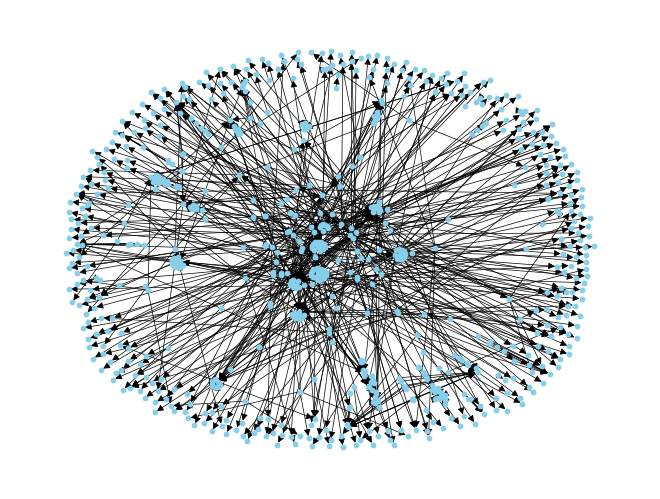

In [19]:
G = nx.DiGraph()
twolayer_edges = [edge for edge in edges if 'first_layer' in edge[3]['notes'] or 'second_layer' in edge[3]['notes']]
for edge in twolayer_edges:  # to run the full graph, use 'edges' instead of the subset
    subj_id = edge[0]['id']
    obj_id = edge[2]['id']
    rel_label = edge[1]['label']
    G.add_edge(subj_id, obj_id, label=rel_label)

pos = nx.spring_layout(G)
labels = {node: node for node in G.nodes()}
nx.draw(G, pos, with_labels=False, node_color='skyblue',
        node_size=10, edge_color='k', width=0.5)
plt.show()

**If necessary the code can be modified to use different colours for different types of nodes and edges.**

The code assumes (also based on the [*Putman et al. 2023* paper](https://pubmed.ncbi.nlm.nih.gov/38000386/)) that between any two nodes there only is one kind of relation.

![](./PIPELINE_images/monarch-sem_model.jpg)

Below we can see all labels found ahead of filtering for unique edges:

In [20]:
input_seed = ['MONDO:0007739']  # required as a list
firstLayer_nodes, firstLayer_edges, disease_id_label, disease_name_label = get_neighbours(input_seed,'first_layer')
firstLayer_seeds = [item['id'] for item in firstLayer_nodes]  # turn into a list of IDs
firstLayer_seeds = [fl_id for fl_id in firstLayer_seeds if fl_id not in input_seed]  # to avoid re-running nodes and counting them in the second layer
secondLayer_nodes, secondLayer_edges, disease_id_label, disease_name_label = get_neighbours(firstLayer_seeds,'second_layer')
nonUnique_edges = firstLayer_edges + secondLayer_edges

In [21]:
nonUnique_relation_counts = {}
for edge in nonUnique_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in nonUnique_relation_counts:
            nonUnique_relation_counts[relation] += 1
        else:
            nonUnique_relation_counts[relation] = 1
print(nonUnique_relation_counts)

{'biolink:subclass_of': 198, 'biolink:has_phenotype': 360, 'biolink:related_to': 88, 'biolink:has_mode_of_inheritance': 23, 'biolink:causes': 1, 'biolink:gene_associated_with_condition': 2, 'biolink:treats_or_applied_or_studied_to_treat': 55, 'biolink:model_of': 22, 'biolink:interacts_with': 46, 'biolink:participates_in': 42, 'biolink:orthologous_to': 5, 'biolink:active_in': 1, 'biolink:actively_involved_in': 1}


Above you can see all types of relations found. Let's then identify another ID that comes up several times, and use it as a case study:

In [22]:
nonUnique_node_counts = {}
for edge in nonUnique_edges:
    subj_id = edge[0]['id']
    obj_id = edge[2]['id']
    if subj_id in nonUnique_node_counts:
        nonUnique_node_counts[subj_id] += 1
    else:
        nonUnique_node_counts[subj_id] = 1
    if obj_id in nonUnique_node_counts:
        nonUnique_node_counts[obj_id] += 1
    else:
        nonUnique_node_counts[obj_id] = 1

threshold = 30
reference_seeds = [node for node, count in nonUnique_node_counts.items() if count > threshold]
print("Reference seeds based on threshold:")
for seed in reference_seeds:
    print(seed)

Reference seeds based on threshold:
MONDO:0007739
HP:0001272
HGNC:4851
HGNC:11007
CHEBI:16919


In [23]:
nonUnique_filtered_edges = []
for edge in nonUnique_edges:
    subj_id = edge[0]['id']
    obj_id = edge[2]['id']
    if (subj_id in input_seed and obj_id in reference_seeds) or (subj_id in reference_seeds and obj_id in input_seed):
        nonUnique_filtered_edges.append(edge)

for edge in nonUnique_filtered_edges:
    print(f"{edge}\n")
print (f"Edges' count: {len(nonUnique_filtered_edges)}")

[{'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'label': 'biolink:has_phenotype'}, {'id': 'HP:0001272', 'label': 'Cerebellar atrophy'}, {'notes': 'first_layer'}]

[{'id': 'HGNC:4851', 'label': 'HTT'}, {'label': 'biolink:causes'}, {'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'notes': 'first_layer'}]

[{'id': 'HGNC:11007', 'label': 'SLC2A3'}, {'label': 'biolink:gene_associated_with_condition'}, {'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'notes': 'first_layer'}]

[{'id': 'CHEBI:16919', 'label': 'creatine'}, {'label': 'biolink:treats_or_applied_or_studied_to_treat'}, {'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'notes': 'first_layer'}]

[{'id': 'CHEBI:16919', 'label': 'creatine'}, {'label': 'biolink:treats_or_applied_or_studied_to_treat'}, {'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'notes': 'second_layer'}]

Edges' count: 5


Above we can see all edges with node ```MONDO:0007739``` (*i.e.* the original input seed for the disease of interest) as either subject or object, and any of the most recurring nodes as the other element in the edge.

In [24]:
unique_edges = unique_elements(nonUnique_edges)

In [25]:
unique_filtered_edges = []
for edge in unique_edges:
    subj_id = edge[0]['id']
    obj_id = edge[2]['id']
    if (subj_id in input_seed and obj_id in reference_seeds) or (subj_id in reference_seeds and obj_id in input_seed):
        unique_filtered_edges.append(edge)

for edge in unique_filtered_edges:
    print(f"{edge}\n")
print (f"Edges' count: {len(unique_filtered_edges)}")

[{'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'label': 'biolink:has_phenotype'}, {'id': 'HP:0001272', 'label': 'Cerebellar atrophy'}, {'notes': 'first_layer'}]

[{'id': 'HGNC:4851', 'label': 'HTT'}, {'label': 'biolink:causes'}, {'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'notes': 'first_layer'}]

[{'id': 'HGNC:11007', 'label': 'SLC2A3'}, {'label': 'biolink:gene_associated_with_condition'}, {'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'notes': 'first_layer'}]

[{'id': 'CHEBI:16919', 'label': 'creatine'}, {'label': 'biolink:treats_or_applied_or_studied_to_treat'}, {'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'notes': 'first_layer'}]

Edges' count: 4


The results proves that at least up to the second layer –**further checks can be done when also considering the third layer**– no more than one relation is present for each couple of nodes, as the same relation will be returned twice when calling for the subject or object: edges in fact go from n to >n/2. I tested it with n=8 due to ```threshold = 30```, but also with n= 20 with ```threshold = 20``` with counts after filtering respectively 4 and 14.

By never being less than half of the original number, we can assume there never are more edges removed. **If necessary we can add a step that reports for each edge, how many are removed as non-unique.**

Below a few lines generating list objects for data analysis in **section 9**:

In [26]:
monarch_3layer_nodes = copy.deepcopy(nodes)
monarch_3layer_edges = copy.deepcopy(edges)
monarch_2layer_edges = [edge for edge in monarch_3layer_edges if 'first_layer' in edge[3]['notes'] or 'second_layer' in edge[3]['notes']]
monarch_2layer_nodes = unique_elements([edge[0] for edge in monarch_2layer_edges] + [edge[2] for edge in monarch_2layer_edges])

## 3. ```DGIdb.py```: GENE-TO-DRUG ASSOCIATIONS

This section **matches genes** in the nodes obtained from the previous steps **to drugs** via the DGIdb (*i.e* Drug-gene interaction database).

CR's original version would load the dataframe for the edges from the .csv files created in the previous step based on the current date alone –I instead changed the main ```run_dgidb()``` (input = date; output = lists of nodes and edges matched with drugs) function so that it takes both input seed and date to determine which folder to access.

The nodes list is then parsed through the ```get_genes()``` (input = full nodes list; output = gene-only nodes list) function that retrieves the list of genes only –based on the condition for URIs to contain 'HGNC:' and few other ontologies. Then the list of gene-only node is matched against the ENTREZ database (*i.e.* ```normlize_genes_to_graph()``` (input = gene-only node list; output = same list with ENTREZ ids)) to use that as a seed for DGIdb via ```hit_dgidb_api()``` (input = gene-id list; output = gene-to-drug edges list).

![](./PIPELINE_images/dgidb.png)

Finally the resulting list of edges with information from both Monarch and DGIdb APIs would be converted in a dictionary, stored as an intermediate to then make new calls to add metadata –a step which I completely skipped again as many errors would arise and such information are not necessary at this point. 

My approach focuses instead on first building the **```hit_dgidb_api()```** to make calls for one node at a time –node that belongs to category ```gene```. Therefore it would return the corresponding association edges for drugs related to that given gene.

In [27]:
def get_entrez(nonENTREZ_seed):
    """
    This function performs API calls to DGIdb to retrieve OUT and IN edges
    from a query node (i.e. gene).

    :param ENTREZ_seed: single ENTREZ ID for a gene.
    :param rows: the maximum number of results to return (integer) (default = 2000).
    :return: an api response objects.
    """

    mg = get_client('gene')

    qterm_label = nonENTREZ_seed.split(':')[1]
    namespace = nonENTREZ_seed.split(':')[0].lower()
    scopes_label = []
    
    if 'flybase' == namespace:
        scopes_label = ['flybase']
    elif 'wormbase' == namespace:
        scopes_label = ['wormbase']
    elif 'mgi' == namespace:
        qterm_label = 'MGI:' + qterm_label  # prefix required for 'MGI' IDs
        scopes_label = ['mgi']
    elif 'hgnc' == namespace:
        scopes_label = ['hgnc']
    elif 'ensembl' == namespace:
        scopes_label = ['ensembl.gene']
    elif 'zfin' == namespace:
        scopes_label = ['zfin']
    else:
        logging.info("Unsupported namespace for gene ID conversion.")
        return None
        
    try:
        ENTREZ_seed = mg.querymany(qterms = qterm_label,
                                       scopes = scopes_label,
                                       fields = 'entrezgene',
                                       size = 1)
        if ENTREZ_seed:
            return ENTREZ_seed[0]['entrezgene'] if 'entrezgene' in ENTREZ_seed[0] else None
    except Exception as e:
        logging.error(f"API call failed for {qterm_label} with error: {e}")
    
    return None


def hit_dgidb_api(ENTREZ_seed, rows = 2000, max_retries = 3):
    """
    This function performs API calls to DGIdb (v2) to retrieve OUT and IN edges
    from a query node (i.e. gene). It will perform up to 3 recalls if any 'ConnectioError',
    'HTTPError' or 'Timeout' happens.

    :param ENTREZ_seed: single ENTREZ ID for a gene.
    :param rows: the maximum number of results to return (integer) (default = 2000).
    :param max_entries: the maximum number of retries (integer) (default = 3).
    :return: an api response objects.
    """

    logging.info(f"NOW RUNNING: {current_function_name()} with seed {ENTREZ_seed})'.")

    # load strings required for path location
    global disease_name_label
    global disease_id_label
    
    dgidb_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})','dgidb')
    os.makedirs(dgidb_directory, exist_ok=True)
    
    # API address and parameters
    dgibd_link = 'https://dgidb.org/api/v2/interactions.json?'
    parameters = {'fl_excludes_evidence': False, 'rows': rows}
    
    # API call
    attempt = 0
    while attempt < max_retries:
        try:
            r_drugs = requests.get(f'{dgibd_link}{ENTREZ_seed}', params=parameters)
            logging.info(f"Drug request URL: {dgibd_link} with parameters {parameters}")
            logging.info(f"In edges response status: {r_drugs.status_code}")

            if r_drugs.ok:
                ENTREZ_new = ENTREZ_seed.split('=')
                ENTREZ_dir = ENTREZ_new[0]+'_'+ENTREZ_new[1]
                drug_seed_directory = os.path.join(dgidb_directory, ENTREZ_dir)
                os.makedirs(drug_seed_directory, exist_ok=True)
                drugs_file_path = os.path.join(drug_seed_directory, f'{ENTREZ_dir}_api_response.json')
                with open(drugs_file_path, 'w') as json_file:
                    json.dump(r_drugs.json(), json_file)
                logging.info(f"API response saved to {drugs_file_path}")
                return r_drugs
            else:
                raise ValueError(f"HTTP Error {r_drugs.status_code}: {r_drugs.reason}")

        except (requests.ConnectionError, requests.HTTPError, requests.Timeout) as e:
            logging.warning(f"Attempt {attempt + 1} failed: {e}")
            attempt += 1
            if attempt == max_retries:
                logging.error(f"All retries exhausted. Failed to fetch data for {ENTREZ_seed}.")
                raise

    raise Exception("Failed to process drug interactions after multiple retries")

Function ```hit_dgidb_api()``` has to be duplicated and modified in order to account for the **new GraphQL version** –as the older V2 version will no longer suported after June 1st 2024.

The new API **takes gene names** and **not ENTREZ**, therefore also macro-function ```run_dgidb()``` will have to be updated.

In [28]:
def hit_dgidb_api(gene_name=None, gene_id=None, max_retries=3):
    """
    This function performs API calls to DGIdb to retrieve interactions for a specific gene
    or all drugs.
    It will perform up to 3 retries if any 'ConnectionError', 'HTTPError' or 'Timeout' occurs.

    :param gene_name: Name of the gene. If None, retrieves all drugs.
    :param gene_id: ID of the gene. If None, retrieves all drugs.
    :param max_retries: The maximum number of retries (integer) (default = 3).
    :return: An API response object.
    """

    if gene_name and gene_id:
        logging.info(f"NOW RUNNING: {current_function_name()} with gene name {gene_name} and gene ID {gene_id}.")
    else:
        logging.info(f"NOW RUNNING: {current_function_name()} to retrieve all drugs in DGIdb.")

    # Load strings required for path location
    global disease_name_label
    global disease_id_label
    global base_data_directory

    dgidb_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'dgidb')
    os.makedirs(dgidb_directory, exist_ok=True)

    # GraphQL API endpoint and query
    dgidb_link = 'https://dgidb.org/api/graphql'
    
    if gene_name and gene_id:
        query = """
        {
          genes(names: ["%s"]) {
            nodes {
              interactions {
                drug {
                  name
                  conceptId
                }
                interactionScore
                interactionTypes {
                  type
                  directionality
                }
                interactionAttributes {
                  name
                  value
                }
                publications {
                  pmid
                }
                sources {
                  sourceDbName
                }
              }
            }
          }
        }
        """ % (gene_name)
    else:
        query = """
        {
          genes {
            nodes {
              name
              interactions {
                drug {
                  name
                  conceptId
                }
                interactionScore
                interactionTypes {
                  type
                  directionality
                }
                interactionAttributes {
                  name
                  value
                }
                publications {
                  pmid
                }
                sources {
                  sourceDbName
                }
              }
            }
          }
        }
        """

    headers = {'Content-Type': 'application/json'}
    attempt = 0
    timeout_seconds = 10
    while attempt < max_retries:
        try:
            response = requests.post(dgidb_link, json={'query': query}, headers=headers, timeout=timeout_seconds)
            logging.info(f"GraphQL request URL: {dgidb_link} with query {query}")
            logging.info(f"In edges response status: {response.status_code}")

            if response.ok:
                if gene_name and gene_id:
                    gene_id_string = gene_id.replace(':', '_')
                    gene_dir = os.path.join(dgidb_directory, f'{gene_id_string}')
                    drugs_file_path = os.path.join(gene_dir, f'{gene_id_string}_api_response.json')
                    os.makedirs(os.path.dirname(drugs_file_path), exist_ok=True)
                else:
                    drugs_file_path = os.path.join(dgidb_directory, 'all_drugs', f'{disease_name_label}_{date_str}_dgidb_all_drugs.json')
                    os.makedirs(os.path.dirname(drugs_file_path), exist_ok=True)

                with open(drugs_file_path, 'w') as json_file:
                    json.dump(response.json(), json_file)
                logging.info(f"API response saved to {drugs_file_path}")
                return response

            else:
                logging.warning(f"HTTP Error {response.status_code}: {response.reason}")
                if response.status_code == 504:
                    attempt += 1
                    if attempt < max_retries:
                        logging.info("Retrying due to 504 Gateway Timeout...")
                        time.sleep(5)  # Add a delay before retrying
                    else:
                        if not gene_name and not gene_id:  # If the call is for all drugs
                            file_name = "Huntington disease_2024-06-06_dgidb_all_drugs.json"
                            fallback_path = os.path.join(base_data_directory, "reference", "Huntington disease (2024-06-06)", "dgidb", "all_drugs", file_name)
                            logging.info(f"Retrieving data from fallback file: {fallback_path}")
                            with open(fallback_path, 'r') as file:
                                fallback_data = json.load(file)
                            response = json_reverse(fallback_data)
                            # save the fallback response as a JSON file
                            with open(drugs_file_path, 'w') as json_file:
                                json.dump(fallback_data, json_file)
                            logging.info(f"Fallback data saved to {drugs_file_path}")
                            return response
                        else:
                            return None
                else:
                    raise ValueError(f"HTTP Error {response.status_code}: {response.reason}")

        except (requests.ConnectionError, requests.HTTPError, requests.Timeout) as e:
            logging.warning(f"Attempt {attempt + 1} failed: {e}")
            attempt += 1
            if attempt < max_retries:
                time.sleep(5)  # Add a delay before retrying
            if attempt == max_retries:
                logging.error(f"All retries exhausted. Failed to fetch data.")
                if not gene_name and not gene_id:  # If the call is for all drugs
                    file_name = "Huntington disease_2024-06-06_dgidb_all_drugs.json"
                    fallback_path = os.path.join(base_data_directory, "reference", "Huntington disease (2024-06-06)", "dgidb", "all_drugs", file_name)
                    logging.info(f"Retrieving data from fallback file: {fallback_path}")
                    with open(fallback_path, 'r') as file:
                        fallback_data = json.load(file)
                    response = json_reverse(fallback_data)
                    # save the fallback response as a JSON file
                    drugs_file_path = os.path.join(dgidb_directory, 'all_drugs', f'{disease_name_label}_{date_str}_dgidb_all_drugs.json')
                    with open(drugs_file_path, 'w') as json_file:
                        json.dump(fallback_data, json_file)
                    logging.info(f"Fallback data saved to {drugs_file_path}")
                    return response
                else:
                    return None

    logging.warning("Failed to process drug interactions after multiple retries.")
    return None

Below a test-call for the DGIdb API:

In [29]:
seed_id = 'HGNC_4851'
seed_gene = 'HTT'
test_response = hit_dgidb_api(seed_gene, seed_id)
test_response

<Response [200]>

Again, ```<Response [200]>``` means that the API call was successful.

And below a test-call for the ENTREZ conversion both via the appropriate ```get_entrez()``` function and directly -although no longer required in V5 API:

In [30]:
node = {'id':'HGNC:18212','label':'HPCAL4'}
nonENTREZ_seed = node['id']
ENTREZ_seed = get_entrez(nonENTREZ_seed)
print(f"ENTREZ id: {ENTREZ_seed}")

ENTREZ id: 51440


In [31]:
print(get_client('gene').querymany(qterms = '18212',
                                       scopes = 'hgnc',
                                       fields = 'entrezgene',
                                       size = 1))

[{'query': '18212', '_id': '51440', '_score': 15.987598, 'entrezgene': '51440'}]


Then I developed a wrapper function **```run_dgidb()```** that based on both ```input_seed``` from the rest of the pipeline and date (object ```today``` set at the beginning) retrieves the appropriate nodes and edges list files –although here in this notebook that section will be commented out as such variables are already present in the global workspace– to then iterate through the nodes in the node list file to get all the edges between genes and drugs –after filtering within the function to extrapolate the appropriate subset of gene-only nodes, and calling for subfunction ```get_entrez()``` to retrieve the equivalent 'ENTREZ' id, each node is parsed through ```hit_dgidb_api()```.

DGIdb's new V5 API no longer requires the ```get_entrez()``` function though. It will not be in the final ```DGIdb.py``` script.

The resulting edges are appended to the existing ```edges``` object, while the ```nodes``` object is overwritten by listing all nodes in the resulting edges list: only unique edges and nodes are kept –by using the same ```get_unique()``` function from the 'Monarch.py' section.

This approach allows for a more straightforward pipeline.

In [32]:
def run_dgidb(monarch_input,date,layers = 3):
    """
    This function runs the whole DGIdb script and saves nodes and edges files.

    :param monarch_input: the input seed from the run_monarch() step.
    :param date: the date of creation of the disease graph.
    :param layers: how many layers to consider for the API calls (default = 3).
    :return: nodes and edges files in /DGIdb folder.
    """

    start_time = time.time()
    
    logging.info(f"NOW RUNNING: {current_function_name()} following 'run_monarch({monarch_input})'.")

    global nodes
    global edges

    dgidb_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'dgidb')
    
    # initialise gene-to-drug list
    drug_edges = []

    query_nodes = nodes
    query_edges = edges

    # adjust edges and nodes based on the layers parameter ('logging.critical()' just to make it explicit)
    if layers == 3:
        logging.info("All 3 layers are considered.")
        print("All 3 layers are considered.")
        pass  # use all layers, no filtering needed
    elif layers == 2:
        query_edges = [edge for edge in query_edges if 'first_layer' in edge[3]['notes'] or 'second_layer' in edge[3]['notes']]
        logging.info("Only layers 1 and 2 are considered.")
        print("Only layers 1 and 2 are considered.")
    elif layers == 1:
        query_edges = [edge for edge in query_edges if 'first_layer' in edge[3]['notes']]
        logging.info("Only layer 1 is considered.")
        print("Only layer 1 is considered.")
    else:
        raise ValueError("Invalid number of layers specified. Choose 1 or 2 –otherwise 3 by default.")
    if layers in [1, 2]:
        node_ids = set(edge[0]['id'] for edge in query_edges) | set(edge[2]['id'] for edge in query_edges)
        query_nodes = [node for node in nodes if node['id'] in node_ids]

    logging.info(f"{len(query_nodes)} nodes and {len(query_edges)} edges from 'run_monarch({monarch_input})'.")
    print(f"{len(query_nodes)} nodes and {len(query_edges)} edges from 'run_monarch({monarch_input})'.")
    
    for node in query_nodes:
        ENTREZ_id = get_entrez(node['id'])
        if ENTREZ_id:
            entrez_dir = os.path.join(dgidb_directory, f'genes_{ENTREZ_id}')
            drug_data = None  # Initialize drug_data to None

            # check if the API call for this ENTREZ ID was already done
            if os.path.exists(entrez_dir):
                drug_file_path = os.path.join(entrez_dir, f'genes_{ENTREZ_id}_api_response.json')
                with open(drug_file_path, 'r') as file:
                    drug_data = json.load(file)
                logging.info(f"Data for ENTREZ ID: {ENTREZ_id} fetched from local storage.")
            else:
                # make the API call
                try:
                    r_drugs = hit_dgidb_api(f'genes={ENTREZ_id}')
                    if r_drugs.ok:
                        drug_data = r_drugs.json()
                        os.makedirs(entrez_dir, exist_ok=True)
                        with open(os.path.join(entrez_dir, f'genes_{ENTREZ_id}_api_response.json'), 'w') as file:
                            json.dump(drug_data, file)
                    else:
                        logging.info(f"No drug data returned for ENTREZ ID: {ENTREZ_id}")
                except Exception as e:
                    logging.error(f"Failed to process drug interactions for {node['id']}: {str(e)}")

            # extrapolate the drug-to-gene associations
            if drug_data:
                for key in ['ambiguousTerms', 'matchedTerms', 'unmatchedTerms']:
                    terms = drug_data.get(key, [])
                    if isinstance(terms, list):
                        for term in terms:
                            if isinstance(term, dict):
                                interactions = term.get('interactions', [])
                                for interaction in interactions:
                                    drug_node = {'id': interaction['drugConceptId'], 'label': interaction['drugName']}
                                    relation = {'label': 'dgidb:interacts_with'}
                                    notes = {'notes': key}
                                    drug_edges.append((node, relation, drug_node, notes))

    # MERGE new edges with the existing ones
    all_edges = query_edges + drug_edges
    unique_edges = unique_elements(all_edges)  # they should already be unique

    # EXTRACT nodes from edges
    all_nodes = [edge[0] for edge in unique_edges] + [edge[2] for edge in unique_edges]
    unique_nodes = unique_elements(all_nodes)

    # also store the entire list of drugs in DGIdb
    endpoint = 'https://dgidb.org/api/v2/drugs'
    params = {
        'page': 1,
        'count': 1000
    }
    all_drugs = []
    all_drug_dir = os.path.join(dgidb_directory, 'all_drugs')
    all_drug_file = os.path.join(all_drug_dir, f'{disease_name_label}_{date_str}_dgidb_all_drugs.json')
    if os.path.exists(all_drug_file):
        with open(all_drug_file, 'r') as file:
            all_drugs = json.load(file)
        logging.info(f"Data for DGIdb network fetched from local storage.")
    else:
        os.makedirs(all_drug_dir, exist_ok=True)
        while True:
            response = requests.get(endpoint, params=params)
            if response.status_code == 200:
                data = response.json()
                all_drugs.extend(data['records'])
                if data['_meta']['current_page'] < data['_meta']['total_pages']:
                    params['page'] += 1
                else:
                    break
            else:
                print(f"Failed to retrieve data: {response.status_code}")
                break
        with open(all_drug_file, 'w') as file:
            json.dump(all_drugs, file)
    all_drugs = [{'id': drug['concept_id'], 'label': drug['name']} for drug in all_drugs if 'concept_id' in drug and 'name' in drug]
    
    # save the unique nodes and edges as CSV
    nodes_df = pd.DataFrame(unique_nodes)
    nodes_df.to_csv(os.path.join(dgidb_directory, f'{disease_name_label}_{date_str}_dgidb_nodes.csv'), index=False)
    edges_df = pd.DataFrame(unique_edges)
    edges_df.to_csv(os.path.join(dgidb_directory, f'{disease_name_label}_{date_str}_dgidb_edges.csv'), index=False)

    # save the DGIdb nodes
    all_drug_path = os.path.join(all_drug_dir, f'{disease_name_label}_{date_str}_dgidb_all_drugs.csv')
    all_drugs_df = pd.DataFrame(all_drugs)
    all_drugs_df.to_csv(all_drug_path, index=False)
    
    logging.info("CSV files saved in DGIdb directory.")

    end_time = time.time()
    duration = end_time - start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"'DGIdb.py' run finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"'DGIdb.py' run finished in {minutes} minutes and {seconds} seconds.")
    
    return unique_nodes, unique_edges, all_drugs

Below the new version of ```run_dgidb()``` adapted to the changes due to V5 API:

In [33]:
def run_dgidb(monarch_input,date,layers = 3):
    """
    This function runs the whole DGIdb script and saves nodes and edges files.

    :param monarch_input: the input seed from the run_monarch() step.
    :param date: the date of creation of the disease graph.
    :param layers: how many layers to consider for the API calls (default = 3).
    :return: nodes and edges files in /DGIdb folder.
    """

    start_time = time.time()

    with open(input_file_path, 'a') as file:
        file.write(f"Degrees of distance from the Disease ID considered for DGIdb: {layers}\n\n")
    
    logging.info(f"NOW RUNNING: {current_function_name()} following 'run_monarch({monarch_input})'.")

    global nodes
    global edges

    dgidb_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'dgidb')
    
    # initialise gene-to-drug list
    drug_edges = []

    query_nodes = nodes
    query_edges = edges

    # adjust edges and nodes based on the layers parameter ('logging.critical()' just to make it explicit)
    if layers == 3:
        logging.info("All 3 layers are considered.")
        print("All 3 layers are considered.")
        pass  # use all layers, no filtering needed
    elif layers == 2:
        query_edges = [edge for edge in query_edges if 'first_layer' in edge[3]['notes'] or 'second_layer' in edge[3]['notes']]
        logging.info("Only layers 1 and 2 are considered.")
        print("Only layers 1 and 2 are considered.")
    elif layers == 1:
        query_edges = [edge for edge in query_edges if 'first_layer' in edge[3]['notes']]
        logging.info("Only layer 1 is considered.")
        print("Only layer 1 is considered.")
    else:
        raise ValueError("Invalid number of layers specified. Choose 1 or 2 –otherwise 3 by default.")
    if layers in [1, 2]:
        node_ids = set(edge[0]['id'] for edge in query_edges) | set(edge[2]['id'] for edge in query_edges)
        query_nodes = [node for node in nodes if node['id'] in node_ids]

    logging.info(f"{len(query_nodes)} nodes and {len(query_edges)} edges from 'run_monarch({monarch_input})'.")
    print(f"{len(query_nodes)} nodes and {len(query_edges)} edges from 'run_monarch({monarch_input})'.")
    
    valid_prefixes = ['flybase:', 'wormbase:', 'mgi:', 'hgnc:', 'ensembl:', 'zfin:']

    total_nodes = len(query_nodes)
    error_count_504 = 0
    
    for node in query_nodes:
        node_name = node['label']
        node_id = node['id']
        if any(prefix in node_id.lower() for prefix in valid_prefixes):
            node_id_string = node_id.replace(':', '_')
            gene_dir = os.path.join(dgidb_directory, f'{node_id_string}')
            drug_data = None  # Initialize drug_data to None

            # check if the API call for this gene ID was already done
            if os.path.exists(gene_dir):
                drug_file_path = os.path.join(gene_dir, f'{node_id_string}_api_response.json')
                with open(drug_file_path, 'r') as file:
                    drug_data = json.load(file)
                logging.info(f"Data for {node_id} fetched from local storage.")
            else:
                # make the API call
                try:
                    r_drugs = hit_dgidb_api(node_name, node_id)
                    if r_drugs is not None:
                        drug_data = r_drugs.json()
                        os.makedirs(gene_dir, exist_ok=True)
                        with open(os.path.join(gene_dir, f'{node_id_string}_api_response.json'), 'w') as file:
                            json.dump(drug_data, file)
                    else:
                        logging.info(f"No drug data returned for {node_id}")
                        error_count_504 += 1
                        continue  # Move to the next ID
                except ValueError as e:
                    logging.error(f"HTTP Error encountered for {node_id} - {str(e)}")
                    continue  # Move to the next ID
                except Exception as e:
                    logging.error(f"Failed to process drug interactions for {node_id}: {str(e)}")
                    continue  # Move to the next ID

            # extrapolate the drug-to-gene associations
            if drug_data:
                genes_data = drug_data.get('data', {}).get('genes', {}).get('nodes', [])
                if genes_data:
                    interactions = genes_data[0].get('interactions', [])
                    for interaction in interactions:
                        drug_info = interaction.get('drug', {})
                        drug_node = {'id': drug_info.get('conceptId'), 'label': drug_info.get('name')}
                        relation = {'label': 'dgidb:interacts_with'}
                        notes = {'notes': f"interactionScore:{interaction.get('interactionScore')}"}
                        drug_edges.append((node, relation, drug_node, notes))

    # MERGE new edges with the existing ones
    all_edges = query_edges + drug_edges
    unique_edges = unique_elements(all_edges)  # they should already be unique

    # EXTRACT nodes from edges
    all_nodes = [edge[0] for edge in unique_edges] + [edge[2] for edge in unique_edges]
    unique_nodes = unique_elements(all_nodes)

    # also store the entire list of drugs in DGIdb
    all_drug_dir = os.path.join(dgidb_directory,'all_drugs')
    os.makedirs(all_drug_dir, exist_ok=True)
    all_drug_path = os.path.join(all_drug_dir, f'{disease_name_label}_{date_str}_dgidb_all_drugs.csv')
    if os.path.exists(all_drug_path):
        # fetch from locally stored files
        all_drugs_df = pd.read_csv(all_drug_path)
        all_drugs = all_drugs_df.to_dict('records')
        logging.info(f"Data for all drugs fetched from local storage.")
    else:
        # make the API call to fetch the entire list of drugs in DGIdb
        all_genes_data = hit_dgidb_api()
        if all_genes_data is not None:
            all_genes = all_genes_data.json().get('data', {}).get('genes', {}).get('nodes', [])
            all_drugs = [{'id': interaction['drug']['conceptId'], 'label': interaction['drug']['name']} for gene in all_genes for interaction in gene.get('interactions', []) if 'conceptId' in interaction['drug'] and 'name' in interaction['drug']]
        else:
            all_drugs = []
    
    # save the unique nodes and edges as CSV
    nodes_df = pd.DataFrame(unique_nodes)
    nodes_df.to_csv(os.path.join(dgidb_directory, f'{disease_name_label}_{date_str}_dgidb_nodes.csv'), index=False)
    edges_df = pd.DataFrame(unique_edges)
    edges_df.to_csv(os.path.join(dgidb_directory, f'{disease_name_label}_{date_str}_dgidb_edges.csv'), index=False)

    # save the DGIdb nodes
    all_drugs_df = pd.DataFrame(all_drugs)
    all_drugs_df.to_csv(all_drug_path, index=False)
    
    logging.info("CSV files saved in DGIdb directory.")

    end_time = time.time()
    duration = end_time - start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"'DGIdb.py' run finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"'DGIdb.py' run finished in {minutes} minutes and {seconds} seconds.")

    print(f"{error_count_504} out of a total of {total_nodes} gene nodes encountered 'HTTP Error 504: Gateway Time-out'.")
    logging.info(f"{error_count_504} out of a total of {total_nodes} gene nodes encountered 'HTTP Error 504: Gateway Time-out'.")
    
    return unique_nodes, unique_edges, all_drugs

Below a test to see the difference in size between two and three layers:

In [34]:
query_edges = [edge for edge in edges if 'first_layer' in edge[3]['notes'] or 'second_layer' in edge[3]['notes']]

node_ids = set(edge[0]['id'] for edge in query_edges) | set(edge[2]['id'] for edge in query_edges)
query_nodes = [node for node in nodes if node['id'] in node_ids]

print(f"3-layer: {len(edges)} edges and {len(nodes)} nodes.")
print(f"2-layer: {len(query_edges)} edges and {len(query_nodes)} nodes.")

3-layer: 13600 edges and 8513 nodes.
2-layer: 832 edges and 732 nodes.


In [35]:
URI_counts = {}
for node in query_nodes:
    if 'id' in node:
        URI = node['id'].split(':')[0]
        if URI in URI_counts:
            URI_counts[URI] += 1
        else:
            URI_counts[URI] = 1
print(URI_counts)

{'MONDO': 231, 'MP': 27, 'HGNC': 112, 'HP': 204, 'Reactome': 42, 'MGI': 18, 'CHEBI': 42, 'GO': 7, 'UPHENO': 28, 'UBERON': 11, 'FB': 1, 'NBO': 2, 'WB': 1, 'OBA': 2, 'RGD': 1, 'dictyBase': 1, 'ZP': 1, 'CL': 1}


Within the pipeline object names are re-used to avoid overhead, but each step is meticulously stored in .csv files so that each step can be thoroughly analysed.

In order to be able to tweak the depth of this step, parameter **```layer = 3```** is set in the function definition: by default all nodes up to the third layer will be considered for the ENTREZ and DGIdb API calls, otherwise the user can specify if they only want node up to the second layer or just the first one –although this is mostly meant just to choose between two or three layers, to save time.

I will run it both only with two degrees of distance, or the full three. The latter will be the one used in the rest of the pipeline.

In [36]:
run_layers = 2
interm_nodes, interm_edges, drug_nodes = run_dgidb(input_seed,today, layers = run_layers)
dgidb_2layer_nodes = copy.deepcopy(interm_nodes)
dgidb_2layer_edges = copy.deepcopy(interm_edges)

Only layers 1 and 2 are considered.
732 nodes and 832 edges from 'run_monarch(['MONDO:0007739'])'.
'DGIdb.py' run finished in 0 minutes and 0 seconds.
0 out of a total of 732 gene nodes encountered 'HTTP Error 504: Gateway Time-out'.


In [37]:
run_layers = 3  # toggle in Flask App is default = 3 (0), otherwise if toggled = 2 (1)
nodes, edges, drug_nodes = run_dgidb(input_seed,today, layers = run_layers)

All 3 layers are considered.
8513 nodes and 13600 edges from 'run_monarch(['MONDO:0007739'])'.
'DGIdb.py' run finished in 0 minutes and 1 seconds.
0 out of a total of 8513 gene nodes encountered 'HTTP Error 504: Gateway Time-out'.


Below how many edges and nodes are in the network after adding drug-to-gene associations –according to how many layers of the original ```run_monarch(['MONDO:0007739'])``` output are considered, therefore only the first two here.

In [38]:
len(edges)

40884

In [39]:
len(nodes)

17917

In [40]:
URI_counts = {}
for node in nodes:
    if 'id' in node:
        URI = node['id'].split(':')[0]
        if URI in URI_counts:
            URI_counts[URI] += 1
        else:
            URI_counts[URI] = 1
print(URI_counts)

{'chembl': 2674, 'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'iuphar.ligand': 2124, 'ncit': 1822, 'UBERON': 174, 'drugbank': 517, 'MP': 304, 'CL': 75, 'GO': 368, 'rxcui': 2230, 'hemonc': 13, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'wikidata': 19, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'drugsatfda.nda': 3, 'ZFA': 5, 'PR': 1, 'SO': 1, 'chemidplus': 2, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}


As a reference, the run for all three layers based on DGIdb's V2 API returned 7.426 ```chembl:``` and 50 ```wikidata:```, for a total of **42.796 edges** and **14.851 nodes** after a 114min run with already locally stored .json files from the DGIdb API calls (the ENTREZ API is still called, and it's extremely slow anyway).

That same run for three layers on DGIdb's new V5 GraphQL API instead returned 2.674 ```chembl:``` and 19 ```wikidata:```, for a total of **27.284 edges** and **9.404 nodes** after a 38min run without locally stored files. Therefore the new API is very much faster –also considering that the rather slow ```get_entrez()``` step is no longer requires– but the amount of molecules found is smalleer.

Below instead few checks on the object with ALL nodes from DGIdb:

In [41]:
len(drug_nodes)

53048

In [42]:
drug_nodes[:5]

[{'id': 'rxcui:40048', 'label': 'CARBOPLATIN'},
 {'id': 'rxcui:12574', 'label': 'GEMCITABINE'},
 {'id': 'rxcui:9060', 'label': 'QUERCETIN'},
 {'id': 'ncit:C74072', 'label': 'DACTOLISIB'},
 {'id': 'ncit:C91732', 'label': 'GEDATOLISIB'}]

In [43]:
drugtype_counts = {}
for drug_node in drug_nodes:
    if 'id' in drug_node:
        drugtype = drug_node['id'].split(':')[0]
        if drugtype in drugtype_counts:
            drugtype_counts[drugtype] += 1
        else:
            drugtype_counts[drugtype] = 1
print(drugtype_counts)

{'rxcui': 22801, 'ncit': 11031, 'drugbank': 2771, 'iuphar.ligand': 3333, 'chembl': 13015, 'hemonc': 20, 'wikidata': 56, 'drugsatfda.nda': 14, 'drugsatfda.anda': 4, 'chemidplus': 3}


The new versions of functions ```hit_dgidb_api()``` and ```run_dgidb()``` still leads to the same nodes and edges objects, therefore it can be replace without issues.

Below copies of ```edges``` and ```nodes``` for analytical steps in **section 9**:

In [44]:
dgidb_3layer_nodes = copy.deepcopy(nodes)
dgidb_3layer_edges = copy.deepcopy(edges)

## 4. ```drugsimilarity.py```: DRUG-TO-DRUG SIMILARITY

The next step is to add information on the molecular structure of the drugs in order to compute similarity scores via **SMILES notations** (*i.e.* simplified molecular-input line-entry system).

![](./PIPELINE_images/SMILES-1.png)

The original code by CR would run the output from the previous ```DGIdb.py``` script through macro-function **```run_drugsimilarity()```** (input = None; output = list of SMILES annotations for each drug matched to the gene nodes): first the drug identifiers for node with ID ```chembl:``` and ```wikidata:``` are converted into SMILES notations via function ```drug_smiles_conversion()``` (input = path location of drug nodes .csv; output = dictionary with {drug_id: SMILES strings}).

Once the drug molecular structures have been identified, a drug-to-drug similarity graph (neighbours = 10) is built via function **```create_drug_sim_graph()```** (input = dictionary of drug structures; output = graph saved to .csv) –which itself iterates through function ```calculate_internal_pairwise_similarities()``` (input = list of structures; ouput = similarity matrices) to calculate pairwise similarities between SMILES annotations.

Within function ```calculate_internal_pairwise_similarities()``` two minor functions are used to first convert SMILES to RDKit molecule objects –which is the 3D diagram corresponding to the SMILES annotation– (*i.e.* ```get_mols()``` (input = list of SMILES; output = list of RDKit molecules)) and to then to convert molecules to a fingerprint of features (*i.e.* ```get_fingerprints()``` (input = RDKit molecules, radius=2, length=4096; output = bit-vector of corresponding extended-connectivity fingerprints (*aka* ECFP)).

![](./PIPELINE_images/ecfp-1.png)

The latter specifically involves ECFP bit-vectors –encoding in each bit for the presence or absence of a certain substructural feature. **```radius = 2```** defines how many atom layers (*aka* shells) are considered –where ```radius = 0``` considers only the atom itself and any unit increase corresponds to the increase in how many bonds away to take into account– while **```length = 4096```** ($2^{12}$) determines the number of bits, and therefore how many features would be encoded.

ECFP obtained from ```radius = 2``` are called **ECFP4**, and they are suitable for chemoinformatics analyses.

In [45]:
def get_smiles(nodes):
    """
    This function performs drug ID conversion from chembl and wikidata ID to SMILES
    chemical structure notation.
    
    :param nodes: list of tuples (id, label) containing all drugs to convert.
    :return: concept dictionary (key = smiles structures: values = old ontology IDs).
    """

    logging.info(f"NOW RUNNING: {current_function_name()}.")
    
    chembl = [(id.split(':')[1], label) for id, label in nodes if 'chembl' in id.split(':')[0].lower()]
    wikidata = [(id.split(':')[1], label) for id, label in nodes if 'wikidata' in id.split(':')[0].lower()]

    concept_dct = {}

    # get SMILES for 'chembl:' drug nodes
    df_chembl = mc.querymany(qterms=[id for id, _ in chembl],
                             scopes=['chembl.molecule_chembl_id'], size=1,
                             fields=['chembl.smiles'], as_dataframe=True)
    ids_chembl = df_chembl.reset_index().copy()
    if 'chembl.smiles' in ids_chembl.columns:
         for smile, (id, label) in zip(ids_chembl['chembl.smiles'], chembl):
            concept_dct[smile] = {'id': f'chembl:{id}', 'label': label}
    else:
        logging.warning('no chembl IDs can be mapped to smiles')
    
    # get SMILES for 'wikidata:' drug nodes
    smiles2wikidata = {}
    sparql = SPARQLWrapper("https://query.wikidata.org/sparql")
    for qid, label in wikidata:
        query = f"""
        SELECT ?smiles WHERE {{
        wd:{qid} wdt:P233 ?smiles.
        }}
        """
        sparql.setQuery(query)
        sparql.setReturnFormat(JSON)
        try:
            results = sparql.query().convert()
            if results["results"]["bindings"]:
                smiles = results["results"]["bindings"][0]["smiles"]["value"]
                concept_dct[smiles] = {'id': f'wikidata:{qid}', 'label': label}
            else:
                logging.info(f'Wikidata ID {qid} cannot be mapped to smiles')
        except Exception as e:
            logging.warning('no wikidata IDs can be mapped to smiles: {e}')

    return concept_dct


def compute_similarity(smiles_dict,radius=2,length=4096):
    """
    This function computes the pairwise similarities of the provided list of SMILES
    notations, using Tanimoto coefficient.
    To achieve that, it first converts SMILES into RDKit objects, and then ECFP bitvectors.
    
    :param smiles_dict: the list of smiles.
    :param radius: ECFP fingerprint radius (default = 2, just for repetition).
    :param length: number of ECFP bits (default = 4096, just for repetition).
    :return: symmetric matrix of pairwise similarities. Diagonal is set to zero. 
    """

    logging.info(f"NOW RUNNING: {current_function_name()}.")
    
    # extrapolate actual SMILES notations from the concept dictionary
    smiles_list = list(smiles_dict.keys())

    # store IDs for the matrix
    id_list = list(smiles_dict.values())
    
    if len(smiles_list) > 10000:
        logging.warning(f'Calculating internal similarity on large set of SMILES strings ({len(smiles_list)})')
    
    # define the fingerprint generator parameters
    fingerprint_gen = rdFingerprintGenerator.GetMorganGenerator(radius=2,fpSize=4096)

    fingerprint_list = []
    
    i = 0
    while i < len(smiles_list):
        sm = smiles_list[i]
        if pd.notna(sm):
            try:
                mol = Chem.MolFromSmiles(sm)
                if mol:
                    fingerprint = fingerprint_gen.GetFingerprint(mol)
                    fingerprint_list.append(fingerprint)
                    i += 1  # only increment the index if the item is not removed
                else:
                    # if RDKit fails to create a molecule, but the SMILES is not NaN
                    smiles_list.pop(i)
                    id_list.pop(i)
            except Exception as e:
                logging.error(f"Error processing SMILES {sm}: {e}")
                smiles_list.pop(i)
                id_list.pop(i)
        else:
            # if SMILES is NaN
            logging.warning(f"Skipping NaN SMILES entry: {sm}")
            smiles_list.pop(i)
            id_list.pop(i)

    n_fingerprints = len(fingerprint_list)
    similarities = np.ones((n_fingerprints, n_fingerprints))

    for j in range(1, n_fingerprints):
        similarity = DataStructs.BulkTanimotoSimilarity(fingerprint_list[j], fingerprint_list[:j])
        similarities[j, :j] = similarity
        similarities[:j, j] = similarity

    return similarities, id_list

This version of the **```get_smiles()```** (input = list of nodes; output = list of SMILES annotations for each drug matched to the gene nodes) function extracts the nodes with ID ```chembl:``` and ```wikidata:``` to convert them in bulk into SMILES annotations –taking advantage of the ```get_client.chem.querymany()``` function.

Then instead of having subfunctions for SMILES-to-RDKit and RDKit-to-ECFP within the function that computes similarity, I made a single **```computer_similarity()```** (input = list of SMILES annotations; output = similarity matrix) that converts SMILES directly into the similarity matrix: the subfunctions were very short, never re-used and made the code less clear by having to scroll through it back and forth. Moreover, RDKit objects and ECFP bitvectors are not human readable –therefore this section should be handled directly by the code, and only show in the log.

I also fixed the section that made fetched SMILES notations for ```wikidata:``` drug nodes: there were a few errors in the original code, where the wrong df would be called. Moreover, ```get_client('chem').querymany()``` does not really work for those IDs. SPARQL instead does.

Below an example using a shorter list of drug nodes:

In [46]:
test_nodes = [
    ("chembl:CHEMBL12856", "INAMRINONE"),
    ("chembl:CHEMBL2103869", "DASOLAMPANEL"),
    ("chembl:CHEMBL1405447", "VITAMIN K3H2"),
    ("wikidata:Q4767903", "ANNAMYCIN")
]
test_smiles = get_smiles(test_nodes)
for key, value in test_smiles.items():
    print(f"{key}: {value}")

Nc1cc(-c2ccncc2)c[nH]c1=O: {'id': 'chembl:CHEMBL12856', 'label': 'INAMRINONE'}
O=C(O)[C@@H]1C[C@H]2C[C@@H](Oc3cccc(Cl)c3-c3nnn[nH]3)CC[C@H]2CN1: {'id': 'chembl:CHEMBL2103869', 'label': 'DASOLAMPANEL'}
Cc1cc(O)c2ccccc2c1O: {'id': 'chembl:CHEMBL1405447', 'label': 'VITAMIN K3H2'}
CC1C(C(C(C(O1)OC2CC(CC3=C(C4=C(C(=C23)O)C(=O)C5=CC=CC=C5C4=O)O)(C(=O)CO)O)I)O)O: {'id': 'wikidata:Q4767903', 'label': 'ANNAMYCIN'}


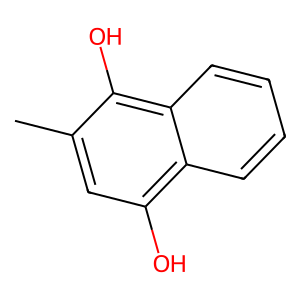

In [47]:
test_molecule = Chem.MolFromSmiles(list(test_smiles.keys())[2])
Draw.MolToImage(test_molecule)  # 2D

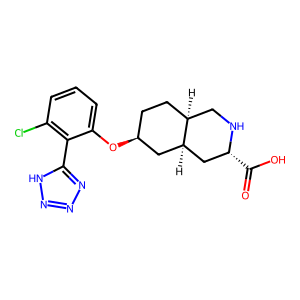

In [48]:
test_molecule = Chem.MolFromSmiles(list(test_smiles.keys())[1])
Draw.MolToImage(test_molecule)  # 2D

The original code used ```test_fingerprint = AllChem.GetMorganFingerprintAsBitVect()```, but Python returned a **```DEPRECATION WARNING: please use MorganGenerator```** –therefore the ```rdFingerprintGenerator``` package was instead used:

In [49]:
fingerprint_gen = rdFingerprintGenerator.GetMorganGenerator(radius=2, fpSize=4096)
test_fingerprint = fingerprint_gen.GetFingerprint(test_molecule)
test_bitstring = test_fingerprint.ToBitString()
print(f"Here are the first 997 characters from the ECFP bitvector: {test_bitstring[:997]}")

Here are the first 997 characters from the ECFP bitvector: 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000010000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000010010000000000000000000000000000000000000000000000000000000000000010000000000000000000000000000000000000000000000000000000000000000000

As you can see above, RDKit objects and ECFP bitvectors cannot be stored in a table in a human-readable way, therefore the subfunctions were not even required just to be able to convert them, as the conversion itself just requires one line from the ```Chem``` module. 

Here instead a test for the ```compute_similarity()``` function:

In [50]:
test_simTable, test_id = compute_similarity(test_smiles)
print(test_simTable)

[[1.         0.07792208 0.09090909 0.07142857]
 [0.07792208 1.         0.06944444 0.11214953]
 [0.09090909 0.06944444 1.         0.12      ]
 [0.07142857 0.11214953 0.12       1.        ]]


In [51]:
print(test_id)

[{'id': 'chembl:CHEMBL12856', 'label': 'INAMRINONE'}, {'id': 'chembl:CHEMBL2103869', 'label': 'DASOLAMPANEL'}, {'id': 'chembl:CHEMBL1405447', 'label': 'VITAMIN K3H2'}, {'id': 'wikidata:Q4767903', 'label': 'ANNAMYCIN'}]


In order to properly have 1 on the diagonal (self-similarity), the similarity table was initialised with ```np.ones()``` **instead of CR's ```np.zeros()```** which would lead to a misinterpretation of the results thinking that by 0 being the most similar, then scores had to be inverted by multiplying them for ```-1``` –unless CR meant to turn this into a dissimilarity matrix, but names and descriptions in the functions point to a misunderstanding instead. This was then 'fixed' by again erroneously assuming that weights should be re-multiplied by ```-1``` when buildijng the graph dataframe.

Just to be clear, the *Tanimoto coefficient* is just another application for ***Jaccard's index***, which here is the ratio between how many bits are ```1``` in both fingerprints (*i.e.* intersection ∣A∩B∣) and how many bits are ```1``` in at least one of them (*i.e.* union ∣A∪B∣).

In [52]:
def generate_drug_edges(similarity_matrix,sorted_matrix,ids,K,minimum=0.5):
    '''
    This function builds the edges object from the similarity matrix.

    :param similarity_matrix: similarity matrix from compute_similarity().
    :param sorted_matrix: result of KNN on similarity matrix .
    :param ids: list of ids from compute_similarity().
    :param K: number of top scoring drugs based on similarity.
    :param min_simil: minimum similarity score (default = 0.5, just for repetition).
    :return: drug-to-drug edges
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")
    
    similarity = []
    added_edges_count = 0
    skipped_edges_count = 0
    chunk_size = 2000
    num_chunks = (similarity_matrix.shape[0] // chunk_size) + 1

    for chunk in range(num_chunks):
        start_idx = chunk * chunk_size
        end_idx = min((chunk + 1) * chunk_size, similarity_matrix.shape[0])
        
        sub_similarity_matrix = similarity_matrix[start_idx:end_idx, :]
        sub_sorted_matrix = sorted_matrix[start_idx:end_idx, :]
        sub_ids = ids[start_idx:end_idx]

        # further update to remove all ==1 and if so, raise K+ how many times ==1
        for i in range(sub_similarity_matrix.shape[0]):
            global_i = start_idx + i  # Adjust index for the original matrix
            for j in sub_sorted_matrix[i, :K]:
                # filter results below the 'min_simil' threshold (default = 0.5)
                # and those at 0 even if 'min_simil == 0.0', as well as any isoform with == 1.0 other than identity
                if sub_similarity_matrix[i, j] >= minimum and sub_similarity_matrix[i, j] != 0 and sub_similarity_matrix[i, j] != 1:
                    new_row = [
                        {'id': ids[global_i]['id'], 'label': ids[global_i]['label']},
                        {'label': 'smiles: similar to'},
                        {'id': ids[j]['id'], 'label': ids[j]['label']},
                        {'notes': f'similarity score: {sub_similarity_matrix[i, j]}'}
                    ]
                    similarity.append(new_row)
    
    return similarity
    

def run_drugsimilarity(monarch_input,date,K=10,min_simil=None,input_radius=None,input_length=None):
    '''
    This function runs the whole drug_similarioty script and saves nodes and edges files.

    :param monarch_input: the input seed from the run_monarch() step.
    :param date: the date of creation of the disease graph.
    :param K: number of top scoring drugs based on similarity (default = 10).
    :param min_simil: any value that would override default minimum=0.5 in compute_similarity().
    :param input_radius: any value that would override default radius=2 in compute_similarity().
    :param input_length: any value that would override default length=4096 in compute_similarity().
    :return: list of edges with drug-to-drug associations.
    '''

    start_time = time.time()
    
    logging.info(f"NOW RUNNING: {current_function_name()} following 'run_dgidb({monarch_input},{today},layers={run_layers})'.")

    global nodes
    global edges
    global drug_nodes

    if not input_radius:
        input_radius = 2
    if not input_length:
        input_length = 4096
    if not min_simil:
        min_simil = 0.5

    with open(input_file_path, 'a') as file:
        file.write(f"The ({K}) top scoring drugs based on similarity are considered.\n")
        file.write(f"The minimum similarity threshold is set to: {min_simil}\n")
        file.write(f"The input radius of the ECFP ({input_length} features) is set to: {min_simil}\n\n")

    drugSimil_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'drug_similarity')
    os.makedirs(drugSimil_directory, exist_ok=True)
    
    # convert drug IDs into SMILES notations
    nodes_list = [(node['id'], node['label']) for node in nodes]
    alldrug_list = [(drug_node['id'], drug_node['label']) for drug_node in drug_nodes]
    smiles = get_smiles(nodes_list)
    alldrug_smiles = get_smiles(alldrug_list)
    
    # save SMILES notations as CSV
    smiles_data = [{'SMILES': k, 'ID': v['id'], 'Label': v['label']} for k, v in smiles.items()]
    smiles_df = pd.DataFrame(smiles_data)
    smiles_df.to_csv(os.path.join(drugSimil_directory, f'{disease_name_label}_{date}_drugSim_smiles.csv'), index=False)
    alldrugs_smiles_data = [{'SMILES': k, 'ID': v['id'], 'Label': v['label']} for k, v in alldrug_smiles.items()]
    alldrugs_smiles_df = pd.DataFrame(alldrugs_smiles_data)
    alldrugs_smiles_df.to_csv(os.path.join(drugSimil_directory, f'{disease_name_label}_{date}_alldrugSim_smiles.csv'), index=False)

    # compute similarities
    similarities, id_list = compute_similarity(smiles,radius=input_radius,length=input_length)
    alldrug_simil, alldrug_id_list = compute_similarity(alldrug_smiles,radius=input_radius,length=input_length)
    
    # save the similarity matrix as CSV
    ids = [d['id'] for d in id_list]
    similarities_df = pd.DataFrame(similarities, index=ids, columns=ids)
    similarities_df.to_csv(os.path.join(drugSimil_directory, f'{disease_name_label}_{date}_drugSim_similarityMatrix.csv'), index=True)
    alldrug_ids = [d['id'] for d in alldrug_id_list]
    alldrug_simil_df = pd.DataFrame(alldrug_simil, index=alldrug_ids, columns=alldrug_ids)
    alldrug_simil_df.to_csv(os.path.join(drugSimil_directory, f'{disease_name_label}_{date}_alldrugSim_similarityMatrix.csv'), index=True)
    
    # sort based on similarity scores (ignore identity, first element for any sorting)
    # later on remove and handle in generate_drug_edges()
    sortedSimilarities = np.argsort(-similarities, axis=1)[:, 1:K+1]
    alldrug_sorted = np.argsort(-alldrug_simil, axis=1)[:, 1:K+1]
    
    # generate drug-to-drug edges
    drug_similarity = generate_drug_edges(similarities,sortedSimilarities,id_list,K,minimum=min_simil)
    drug_edges = generate_drug_edges(alldrug_simil,alldrug_sorted,alldrug_id_list,K,minimum=min_simil)

    # MERGE new edges with the existing ones
    all_edges = edges + drug_similarity
    unique_edges = unique_elements(all_edges)
    unique_drug_edges = unique_elements(drug_edges)

    # save the unique edges as CSV
    edges_df = pd.DataFrame(unique_edges)
    edges_df.to_csv(os.path.join(drugSimil_directory, f'{disease_name_label}_{date_str}_drugSim_edges.csv'), index=False)
    drug_edges_df = pd.DataFrame(drug_edges)
    drug_edges_df.to_csv(os.path.join(drugSimil_directory, f'{disease_name_label}_{date_str}_alldrugSim_edges.csv'), index=False)
    
    logging.info("CSV files saved in drug_similarity directory.")

    end_time = time.time()
    duration = end_time - start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"'drugsimilarity.py' run finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"'drugsimilarity.py' run finished in {minutes} minutes and {seconds} seconds.")

    return unique_edges, unique_drug_edges

The macro-function **```run_drugsimilarity()```** adds a series of optional parameters that allow to change ```radius```, ```length``` (for the ECFP bitvector generation)  and ```K``` (for the Tanimoto coefficient), while still setting default parameters (*i.e.* radius = 2,length = 4096,K = 10) directly in function ```compute_similarity()``` which uses them.

This could allow for an implementation in the flaskApp that would enable competent users to set these parameters manually.

CR's original code referenced property ```CHEMINF:000481``` (*i.e.* 'similar to') which seems not to exist anymore: 

![](./PIPELINE_images/cheminf_000481-1.png)

![](./PIPELINE_images/cheminf_000481-2.png)

According to [*Fu et al. 2015*](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4500850/), ```CHEMINF:000482``` and ```CHEMINF:000483``` where meant to respectively represent 2D and 3D similarity, but I could not find informations on ```CHEMINF:000481```. Moreover, the platform that developed it seems to no longer exist –at least to that given URL.

![](./PIPELINE_images/cheminf_000481-4.png)

![](./PIPELINE_images/cheminf_000481-3.png)

More recent works such as [*Pascazio et al. 2023*](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10647085/) seem to suggest that ```CHEMINF:``` identifiers are no longer used, while also showing that SPARQL is a viable option to obtain semantic information on chemical structures –similarly to how I modified the SMILES-fetching lines for ```wikidata:``` molecules.

In the end –similarly to how ```RO:``` OWL identifiers are no longer supported by Monarch, so I had to remove them– I will ignore the ```CHEMINF:``` IDs that CR added to the edge object for drug-to-drug similarity associations and stick to a simpler ```[{'id': 'MONDO:0016621', 'label': 'juvenile Huntington disease'}, {'label': 'biolink:subclass_of'}, {'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'notes': 'second_layer'}]``` structure where each dictionary represents only **```subj,relation,obj,notes```**.

The last dictionary (*i.e.* ```notes```) will store relavant information for the edge based on the source of the data: **```Monarch.py```** populates it with the layer of the call (*i.e.* ```'first_layer'```, ```'second_layer'``` and ```'third_layer'```), **```DGIdb.py```** populates it with the 'quality' of the match (*i.e.* ```'matchedTerms'``` and ```'ambiguousTerms'```), and the current **```drug_similarity.py```** stores similarity scores in it –an information that was not reported by CR's original code, and which I instead deem to be relevant.

Below a test run of macro-function ```run_drugsimilarity()```:

In [53]:
dgidb_load_toggle = 0

# to load 'nodes', 'edges' from dataframe CSV files
# since re-running 'run_dgidb()' takes a lot of time
if dgidb_load_toggle == 1:
    dgidb_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'dgidb')
    os.makedirs(dgidb_directory, exist_ok=True)

    nodes_path = os.path.join(dgidb_directory, f'{disease_name_label}_{date_str}_dgidb_nodes.csv')
    nodes_df = pd.read_csv(nodes_path)
    nodes = nodes_df.to_dict(orient='records')

    edges_path = os.path.join(dgidb_directory, f'{disease_name_label}_{date_str}_dgidb_edges.csv')
    edges_df = pd.read_csv(edges_path)
    edges = []
    for _, row in edges_df.iterrows():
        subj = ast.literal_eval(row.iloc[0])
        rel = ast.literal_eval(row.iloc[1])
        obj = ast.literal_eval(row.iloc[2])
        notes = ast.literal_eval(row.iloc[3])
        edges.append([subj, rel, obj, notes])

    drug_nodes_path = os.path.join(dgidb_directory, 'all_drugs', f'{disease_name_label}_{date_str}_dgidb_all_drugs.csv')
    drug_nodes_df = pd.read_csv(drug_nodes_path)
    drug_nodes = drug_nodes_df.to_dict(orient='records')

Perform this step for the smaller network of only degrees of distance from the input disease:

In [54]:
nodes = copy.deepcopy(dgidb_2layer_nodes)
edges = copy.deepcopy(dgidb_2layer_edges)
run_layers = 2
nodes, edges, drug_nodes = run_dgidb(input_seed,today, layers = run_layers)
input_min_simil = 0.75
interm_edges, interm_drug_edges = run_drugsimilarity(input_seed,today,min_simil=input_min_simil)
sml_drugsimil_075_nodes = copy.deepcopy(nodes)
sml_drugsimil_075_edges = copy.deepcopy(interm_edges)

Only layers 1 and 2 are considered.
732 nodes and 832 edges from 'run_monarch(['MONDO:0007739'])'.
'DGIdb.py' run finished in 0 minutes and 0 seconds.
0 out of a total of 732 gene nodes encountered 'HTTP Error 504: Gateway Time-out'.
'drugsimilarity.py' run finished in 1 minutes and 17 seconds.


In [55]:
input_min_simil = 0.5
interm_edges, interm_drug_edges = run_drugsimilarity(input_seed,today,min_simil=input_min_simil)
sml_drugsimil_050_nodes = copy.deepcopy(nodes)
sml_drugsimil_050_edges = copy.deepcopy(interm_edges)

'drugsimilarity.py' run finished in 1 minutes and 11 seconds.


In [56]:
input_min_simil = 0.3
interm_edges, interm_drug_edges = run_drugsimilarity(input_seed,today,min_simil=input_min_simil)
sml_drugsimil_030_nodes = copy.deepcopy(nodes)
sml_drugsimil_030_edges = copy.deepcopy(interm_edges)

'drugsimilarity.py' run finished in 1 minutes and 9 seconds.


Now perform it for the correct full network:

In [57]:
nodes = copy.deepcopy(dgidb_3layer_nodes)
edges = copy.deepcopy(dgidb_3layer_edges)
run_layers = 3
nodes, edges, drug_nodes = run_dgidb(input_seed,today, layers = run_layers)
input_min_simil = 0.75
interm_edges, interm_drug_edges = run_drugsimilarity(input_seed,today,min_simil=input_min_simil)
drugsimil_075_nodes = copy.deepcopy(nodes)
drugsimil_075_edges = copy.deepcopy(interm_edges)
alldrugsimil_075_nodes = copy.deepcopy(drug_nodes)
alldrugsimil_075_edges = copy.deepcopy(interm_drug_edges)

All 3 layers are considered.
17917 nodes and 40884 edges from 'run_monarch(['MONDO:0007739'])'.
'DGIdb.py' run finished in 0 minutes and 0 seconds.
0 out of a total of 17917 gene nodes encountered 'HTTP Error 504: Gateway Time-out'.
'drugsimilarity.py' run finished in 1 minutes and 26 seconds.


In [58]:
input_min_simil = 0.5
interm_edges, interm_drug_edges = run_drugsimilarity(input_seed,today,min_simil=input_min_simil)
drugsimil_050_nodes = copy.deepcopy(nodes)
drugsimil_050_edges = copy.deepcopy(interm_edges)
alldrugsimil_050_nodes = copy.deepcopy(drug_nodes)
alldrugsimil_050_edges = copy.deepcopy(interm_drug_edges)

'drugsimilarity.py' run finished in 1 minutes and 26 seconds.


In [59]:
input_min_simil = 0.01  # if 0.00, reverts to default = 0.3
interm_edges, interm_drug_edges = run_drugsimilarity(input_seed,today,min_simil=input_min_simil)
interm_edges = unique_elements(interm_edges+interm_drug_edges)

'drugsimilarity.py' run finished in 1 minutes and 25 seconds.


33824 drug_to_drug edges out of a total of 74708 edges.


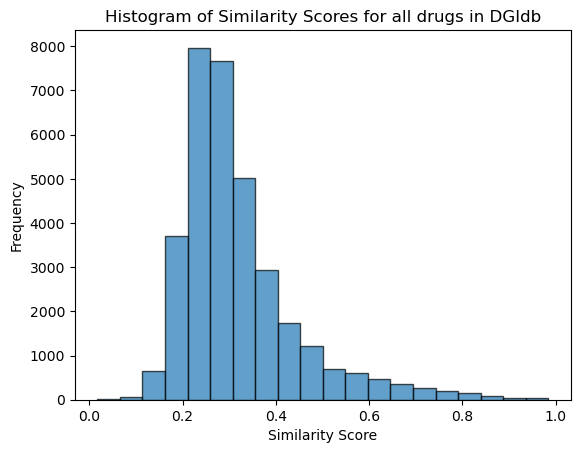

In [60]:
interm_dtd_edges = [edge for edge in interm_edges if 'smiles' in edge[1]['label']]
print(f"{len(interm_dtd_edges)} drug_to_drug edges out of a total of {len(interm_edges)} edges.")
dtd_similarity_scores = []
for edge in interm_dtd_edges:
    for item in edge:
        if 'notes' in item and 'similarity score:' in item['notes']:
            score_str = item['notes'].split(':')[-1].strip()
            score = float(score_str)
            dtd_similarity_scores.append(score)
plt.hist(dtd_similarity_scores, bins=20, edgecolor='k', alpha=0.7)
plt.title('Histogram of Similarity Scores for all drugs in DGIdb')
plt.xlabel('Similarity Score')
plt.ylabel('Frequency')
dgidb_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'dgidb')
simil_hist_plot_path = os.path.join(dgidb_directory, f'{disease_name_label}_{date_str}_similarity_distribution.png')
plt.savefig(simil_hist_plot_path, transparent=True)
plt.show()

In [61]:
simil_distr_threshold = 0.3
below_threshold = [score for score in dtd_similarity_scores if score < simil_distr_threshold]
percentage_below_threshold = (len(below_threshold) / len(dtd_similarity_scores)) * 100
print(f"Percentage of similarity scores below {simil_distr_threshold}: {percentage_below_threshold:.2f}%")
percentile_95 = np.percentile(dtd_similarity_scores, 95)
print(f"The similarity score at the 95th percentile (0.95 of the distribution) is: {percentile_95:.4f}")
average = np.percentile(dtd_similarity_scores, 50)
print(f"The average similarity score (0.5 of the distribution) is: {average:.4f}")

Percentage of similarity scores below 0.3: 56.20%
The similarity score at the 95th percentile (0.95 of the distribution) is: 0.5854
The average similarity score (0.5 of the distribution) is: 0.2857


In [62]:
input_min_simil = 0.3
edges, drug_edges = run_drugsimilarity(input_seed,today,min_simil=input_min_simil)

'drugsimilarity.py' run finished in 1 minutes and 25 seconds.


In [63]:
len(edges)

48516

In [64]:
len(nodes)

17917

The number of nodes didn't change, while the edges went **from 40.884 to 48.512** based on the run using DGIdb's new V5 API, and considering three layers. Moreover, this step in the pipeline seems to be extremely fast, as the ```get_things``` and ```SPARQL``` packages' calls can manage multiple queries –therefore only one call is done for each of them.

![](./PIPELINE_images/cheminf_000481-5.jpg)

In [65]:
rel_counts = {}
for edge in edges:
    rel = edge[1]
    if 'label' in rel:
        rel_type = rel['label']
        if rel_type in rel_counts:
            rel_counts[rel_type] += 1
        else:
            rel_counts[rel_type] = 1
print(rel_counts)

{'biolink:subclass_of': 2338, 'biolink:has_phenotype': 5452, 'biolink:related_to': 556, 'biolink:has_mode_of_inheritance': 158, 'biolink:causes': 174, 'biolink:gene_associated_with_condition': 88, 'biolink:treats_or_applied_or_studied_to_treat': 489, 'biolink:model_of': 288, 'biolink:interacts_with': 2484, 'biolink:participates_in': 685, 'biolink:orthologous_to': 238, 'biolink:active_in': 53, 'biolink:actively_involved_in': 186, 'biolink:enables': 95, 'biolink:acts_upstream_of_or_within': 27, 'biolink:expressed_in': 143, 'biolink:located_in': 60, 'biolink:part_of': 11, 'biolink:contributes_to': 17, 'biolink:is_sequence_variant_of': 55, 'biolink:associated_with_increased_likelihood_of': 2, 'biolink:genetically_associated_with': 1, 'dgidb:interacts_with': 27284, 'smiles: similar to': 7632}


Just as confirmation: **```48512 - 40884 = 7628```**, where we have 7.628 counts for ```'smiles: similar to'``` as drug-to-drug associations in the run using DGIdb's new V5 API, and considering three layers.

In [66]:
len(drug_nodes)

53048

In [67]:
len(drug_edges)

13774

Above we can see instead that the network of all the drugs from DGIdb based on similarity has **53.048 edges** with similarity of at least 30%.

In the future I would want to try implementing a version using [**Alpha Fold**'s V2 API](https://alphafold.com/api-docs), but I couldn't find any existing approach to obtain an ECFP from Alpha Fold's 3D prediction. The [new V3 version](https://golgi.sandbox.google.com) is available now –[*Abramson et al. 2023*](https://www.nature.com/articles/s41586-024-07487-w) paper is still under review as of today (May 10th 2024)– but no API is available, and the model is not open source: it's token-based, and any API probably will require an API key to couple accesses to a paid account.

Alpha Fold's V2 model though is still very viable. I will investigate on how to obtain ECFP from that.

Below yet again the snippet to report ```edges``` and ```nodes``` list for analytical steps in **section 9**:

In [68]:
drugsimil_030_nodes = copy.deepcopy(nodes)
drugsimil_030_edges = copy.deepcopy(edges)
alldrugsimil_030_nodes = copy.deepcopy(drug_nodes)
alldrugsimil_030_edges = copy.deepcopy(drug_edges)

## 5. ```combine_graphs.py```: MERGING GRAPHS

This section of CR's original code can be skipped: it was made in order to join nodes and edges obtained from each of the three previous steps (*i.e.* ```Monarch.py```, ```DGIdb.py``` and ```drugsimilarity.py```) by reading the dataframe ```.csv``` files, merging the ```pandas``` dataframes and removing non-unique nodes and edges -to then finally once again save them as ```.csv```files.

This version of the pipeline does not require that: objects ```nodes``` and ```edges``` are updated at each steps with all new nodes and edges, while intermediate version (*i.e.* Monarch, then Monarch+DGIdb, and finally Monarch+DGIdb+Similarities) are stored in ```.csv``` files for archival reasons: they can be opened and information in ```notes:``` as well as the prefix in ```relation:``` (*i.e.* ```biolink:``` for biological associations, ```dgidb:``` for gene-to-drug associations, and ```smiles:``` for drug-to-drug associations) can show which step they come from. Moreover, ```pandas``` dataframes allow for ```pd.concat([df_2, df_1, df_1]).drop_duplicates(keep=False)``` subtraction to find rows in ```df_2``` that aren't in ```df_1```.

In the end the code can easily run just by handling data also in non-dataframe formats: this pipeline easily handles **```nodes```** as a list of dictionaries where ```keys='id:','label:'``` –as in the ontology ID and name of any given biological element– and **```edges```** as lists of lists of dictionaries ```[subj,rel,obj,notes]``` where ```subj``` and ```obj``` are just nodes dictionaries in the same format described earlies, and ```rel``` and ```notes``` are dictionaries with ```key='label'``` respectively storing information on the relation type and extra information (*i.e.* layes of the Monarch call, type of gene-to-drug match, and similarity scores).

The next step involves unsupervised machine learning, **but the script does not require CR's original data structure**, as it still will only extrapolate the IDs of the nodes and the type or relation to build an RDF –all information that can also be accessed from this pipeline's data-structure. Thus all metadata added by CR's original code are ignored in the learning step, which is good as they could no longer be fetched from Monarch's V3 API –and they were manually added in the other two steps.

## 6. ```networkmodel.py```: NETWORK UNSUPERVISED LEARNING

CR's approach in file ```rdf2vec.py``` to this section was to first merge again all .csv files within macro-function **```rdf2vec_general()```** (input = symptom ID from the old ```run_monarch_symptom()``` function, date, and string with information on disease-name-date; output = None) to then create a series of data structures:
1. an **RDF graph that does not include drug-gene interactions** via ```csv_to_rdf()``` (input = path to the edges file, path to the nodes file, dictionary mapping node types to URIs; output = string RDF in turtle-format (*i.e.* .ttl file))
2. **RDF embeddings** (as vectors) **of only-gene and only-drug nodes** via ```rdf_to_vec()``` (input = path to the nodes file, path to drug similarity file, string RDFF in turtle-format, target entity type to vectorise ('gene' by default); output = dictionary with ```keys = entities``` ('gene' by default) and ```values = vector embeddings```)
3. **a list of genes of interest** associated to the input phenotype via ```get_genes_of_interest()``` (input = dataframe of Monarch edges, dataframe of Monarch nodes, symptom ID from the old ```run_monarch_symptom()``` function; output = list of gene URIs)
4. **dataframes for the training and prediction subsets of edges** via ```fuse_embeddings()```  (input = RDF embedding of genes, RDF embedding of drugs, path to drug edges file, path to graph node data, list of gene URIs; output = training dataframe, prediction dataframe)

Then function **```ml_prediction()```** (input = training dataframe, prediction dataframe, current date; output = dataframe of predicted interactions) would handle both the model training and the prediction of drugs associated to the input disease (*e.g.* ```MONDO:0007739```). These drugs are then ranked via ```drug_list_rank()``` (input = symptom ID from the old ```run_monarch_symptom()``` function, string with information on disease-name-date, the dataframe of predicted interactions, and default minimum probability score of 0.9; output = html page with the resulting predictions table).

![](./PIPELINE_images/xgboost.png)

CR's approach leads to a conceptual error: apparently this approach is not possible. When investigating I realised that package ```pyrdf2vec``` requires a version of ```torch``` that cannot be ealier than 1.8.1 or equal/later than 2.0.0 —yet versions of ```torch``` earlier than 2.0.0 are no longer supporter and especially not available on PyPi. I would then suggest NOT using them. 

Since RDFs are not required for the purpose of drug-repurposing, they will be bypassed right now and eventually re-implemented in the future along with [OWL relational ontologies](https://github.com/oborel/obo-relations) (*i.e.* ```RO:```) and chemical ontologies.

Embeddings will be created directly from the network via the **Node2Vec** algorithm in package ```node2vec``` instead.

In [69]:
nodeType_counts = {}
for node in nodes:
    if 'id' in node:
        nodeType = node['id'].split(':')[0]
        if nodeType in nodeType_counts:
            nodeType_counts[nodeType] += 1
        else:
            nodeType_counts[nodeType] = 1
print(nodeType_counts)

{'chembl': 2674, 'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'iuphar.ligand': 2124, 'ncit': 1822, 'UBERON': 174, 'drugbank': 517, 'MP': 304, 'CL': 75, 'GO': 368, 'rxcui': 2230, 'hemonc': 13, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'wikidata': 19, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'drugsatfda.nda': 3, 'ZFA': 5, 'PR': 1, 'SO': 1, 'chemidplus': 2, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}


Above the node types present in the first two layers. Function ```get_network()``` (input = list of nodes, list of edges and eventually any node type to exclude; output = networkX object) use a custom dictionary that converts URIs into nodetypes, also taking into accounts ortholog gene URI (*e.g.* ```ZFIN:```).

In [70]:
node_type_dict = {
        'disease': ['MONDO'],
        'gene': ['HGNC', 'MGI', 'GO', 'NCBIgene', 'ZFIN', 'Xenbase'],
        'phenotype': ['HP'],
        'drug': ['chembl', 'wikidata']
    }

In [71]:
def get_network(input_nodes,input_edges,exclude=None):
    '''
    This function builds a network object from lists of nodes and edges in a
    given format. Examples:
    
    NODES = [{'id': 'chembl:CHEMBL348436', 'label': 'CIRSIMARITIN'},
    {'id': 'chembl:CHEMBL1503190', 'label': 'CHEMBL1503190'},...]
    
    EDGES = [[{'id': 'MONDO:0007739', 'label': 'Huntington disease'},
    {'label': 'biolink:has_mode_of_inheritance'},
    {'id': 'HP:0000006', 'label': 'Autosomal dominant inheritance'},
    {'notes': 'first_layer'}],[{'id': 'MONDO:0007739', 'label': 'Huntington disease'},
    {'label': 'biolink:subclass_of'},
    {'id': 'MONDO:0005395', 'label': 'movement disorder'},
    {'notes': 'first_layer'}]...]
    
    It can remove a given edge type in order to build a partial network: it should be
    in the URI format (e.g. 'dgidb:'), and the formula checks if it's in the entire
    relations label.

    :param input_nodes: list of nodes.
    :param input_edges: list of edges.
    :param exclude: edge type to exclude (default = None).
    :return: networkX object.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")
    
    G = nx.DiGraph()

    global node_type_dict

    node_type_colours = {
        'disease': '#00008b',  # darkblue
        'gene': '#add8e6',     # lightblue
        'phenotype': '#0000ff',# blue
        'drug': '#ff0000',     # red
        'else': '#ffa500'      # orange
    }

    edge_type_colours = {
        'biolink': '#0000ff',  # blue
        'dgidb': '#ff0000',    # red
        'SMILES': '#ff4500',   # lightred
        'xgboost': '#00ff00'   # green 
    }
    
    # add nodes
    for node in input_nodes:
        if node is None:
            logging.warning("Encountered NoneType node, skipping...")
            continue
        node_id = node.get('id')
        label = node.get('label')
        if node_id is None or label is None:
            logging.warning(f"Encountered node with missing id or label: {node}, skipping...")
            continue
        node_type = 'else'
        
        for type_key, prefixes in node_type_dict.items():
            if any(node_id.startswith(prefix + ':') for prefix in prefixes):
                node_type = type_key
                break
                
        G.add_node(node_id, label=label, node_type=node_type, colour=node_type_colours[node_type])
    
    # add edges
    for edge in input_edges:
        subj_id = edge[0]['id']
        obj_id = edge[2]['id']
        rel_label = edge[1]['label']
        notes = edge[3]['notes']
    
        if subj_id is None or obj_id is None or rel_label is None:
            logging.warning(f"Encountered edge with missing id or label: {edge}, skipping...")
            continue
        
        if exclude is not None and exclude in rel_label:
            continue  # skip this edge if exclusion criteria match
        
        rel_type = rel_label.split(':')[0]
        colour = edge_type_colours.get(rel_type, '#000000')  # default to black if not found
        G.add_edge(subj_id, obj_id, label=rel_label, notes=notes, colour=colour)

    return G
    

# version 1
def get_embeddings(input_network,node_type_select=None):
    '''
    This function builds embeddings (vectors) for node informations -also considering
    the edges they are involved in- from a network object via Node2Vec.
    It can filter to a selected type of nodes

    :param input_network: networkX object.
    :param node_type_select: node type to focus on (default = None): used within run_network_model(), not by the user.
    :return: embedding pickle object.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")
    
    global network_directory, node_type_dict
    valid_node_types = set(node_type_dict.keys())
    
    if node_type_select and node_type_select not in valid_node_types:
        raise ValueError(f"Invalid node_type_select: {node_type_select}. Valid options are: {valid_node_types}")

    # (eventually) filter nodes
    if node_type_select:
        nodes_to_include = [node for node in input_network.nodes() if input_network.nodes[node].get('node_type') == node_type_select]
        subgraph = input_network.subgraph(nodes_to_include)
    else:
        subgraph = input_network

    # generate node embeddings using Node2Vec
    node2vec = Node2Vec(subgraph, dimensions=64, walk_length=30, num_walks=200, workers=2)
    model = node2vec.fit(window=10, min_count=1, batch_words=4)
    output_embeddings = {node: model.wv[node] for node in subgraph.nodes()}

    # save the embeddings dictionary to a PKL file
    if node_type_select is not None:
        embedding_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_embedding_dict_{node_type_select}.pkl')
    else:
        embedding_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_embedding_dict_full.pkl')
    with open(embedding_path, "wb") as file:
        pickle.dump(output_embeddings, file)

    return output_embeddings

In [72]:
# version 2 (with loading check)
def get_embeddings(input_network,emb_t,node_type_select=None):
    '''
    This function builds embeddings (vectors) for node informations -also considering
    the edges they are involved in- from a network object via Node2Vec.
    It can filter to a selected type of nodes

    :param input_network: networkX object.
    :param emb_t: 1 to look for existing embedding files to load instead of generating new ones,
        0 to ignore the loading check.
    :param node_type_select: node type to focus on (default = None): used within run_network_model(),
        not by the user.
    :return: embedding pickle object.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")
    
    global network_directory, node_type_dict
    valid_node_types = set(node_type_dict.keys())
    
    if node_type_select and node_type_select not in valid_node_types:
        raise ValueError(f"Invalid node_type_select: {node_type_select}. Valid options are: {valid_node_types}")

    # PKL file path
    if node_type_select is not None:
        embedding_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_embedding_dict_{node_type_select}.pkl')
    else:
        embedding_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_embedding_dict_full.pkl')

    # check if they already exist, if toggled
    if emb_t == 1 and os.path.exists(embedding_path):
        print(f"Loading embeddings from existing file: {embedding_path}")
        logging.info(f"Loading embeddings from existing file: {embedding_path}")
        
        with open(embedding_path, "rb") as file:
            output_embeddings = pickle.load(file)

    # otherwise compute
    else:   
        # (eventually) filter nodes
        if node_type_select:
            nodes_to_include = [node for node in input_network.nodes() if input_network.nodes[node].get('node_type') == node_type_select]
            subgraph = input_network.subgraph(nodes_to_include)
        else:
            subgraph = input_network

        # generate node embeddings using Node2Vec
        node2vec = Node2Vec(subgraph, dimensions=64, walk_length=30, num_walks=200, workers=2)
        model = node2vec.fit(window=10, min_count=1, batch_words=4)
        output_embeddings = {node: model.wv[node] for node in subgraph.nodes()}

        # save the embeddings dictionary to a PKL file
        with open(embedding_path, "wb") as file:
            pickle.dump(output_embeddings, file)
        print("PKL files saved in network directory.")
        logging.info("PKL files saved in network directory.")

    return output_embeddings

Below a test of how the new network structure and visualisation is:

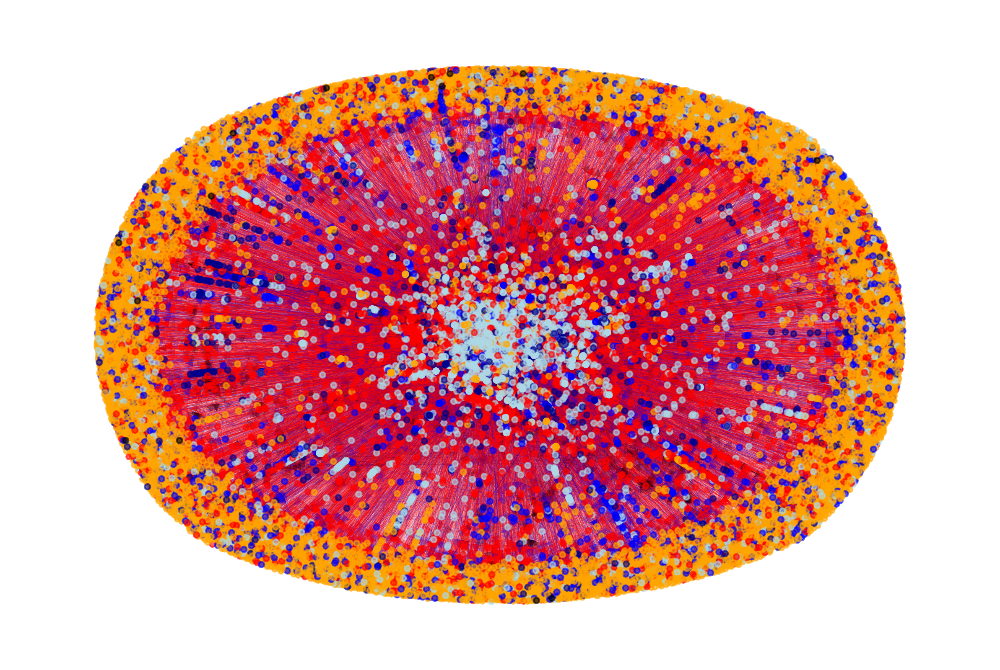

In [73]:
network_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'network')
os.makedirs(network_directory, exist_ok=True)

plot_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_network_plot.png')
plot_toggle = 1

if os.path.exists(plot_path) and plot_toggle==1:
    display(Image(filename=plot_path)) #load to save time
else:
    test_network = get_network(nodes,edges)

    pos = nx.spring_layout(test_network)
    ordered_node_colors = [test_network.nodes[node].get('colour', '#000000') for node in test_network.nodes()]
    node_sizes = [30 if node == 'MONDO:0007739' else 10 for node in test_network.nodes()]
    plt.figure(figsize=(3000/300, 2000/300))  # 300dpi
    nx.draw_networkx_nodes(test_network, pos, node_size=node_sizes, node_color=ordered_node_colors, alpha=0.6)
    edge_colors = [test_network[u][v]['colour'] for u, v in test_network.edges()]
    nx.draw_networkx_edges(test_network, pos, width=0.2, alpha=0.2, edge_color=edge_colors)
    plt.axis('off')
    plt.savefig(plot_path, format="png", dpi=300, bbox_inches='tight', pad_inches=0.1)

In [74]:
test_network = get_network(nodes,edges)
print(test_network)

DiGraph with 17917 nodes and 48516 edges


Then next the same network without edges between gene and drugs:

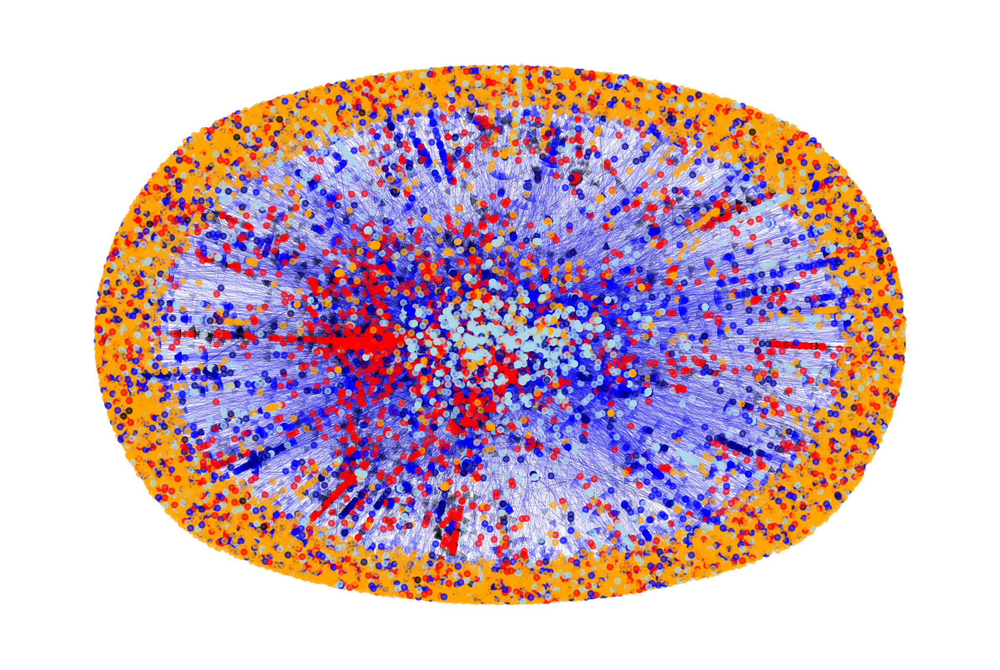

In [75]:
plot_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_network_plot_partial.png')
plot_toggle = 1

if os.path.exists(plot_path) and plot_toggle==1:
    display(Image(filename=plot_path)) #load to save time
else:
    test_network_partial = get_network(nodes,edges,exclude='dgidb')

    pos = nx.spring_layout(test_network_partial)
    ordered_node_colors = [test_network_partial.nodes[node].get('colour', '#000000') for node in test_network_partial.nodes()]
    node_sizes = [30 if node == 'MONDO:0007739' else 10 for node in test_network_partial.nodes()]
    plt.figure(figsize=(3000/300, 2000/300))  # 300dpi
    nx.draw_networkx_nodes(test_network_partial, pos, node_size=node_sizes, node_color=ordered_node_colors, alpha=0.6)
    edge_colors = [test_network_partial[u][v]['colour'] for u, v in test_network_partial.edges()]
    nx.draw_networkx_edges(test_network_partial, pos, width=0.2, alpha=0.2, edge_color=edge_colors)
    plt.axis('off')
    plt.savefig(plot_path, format="png", dpi=300, bbox_inches='tight', pad_inches=0.1)

Here instead the network of all the drugs in DGIdb: 

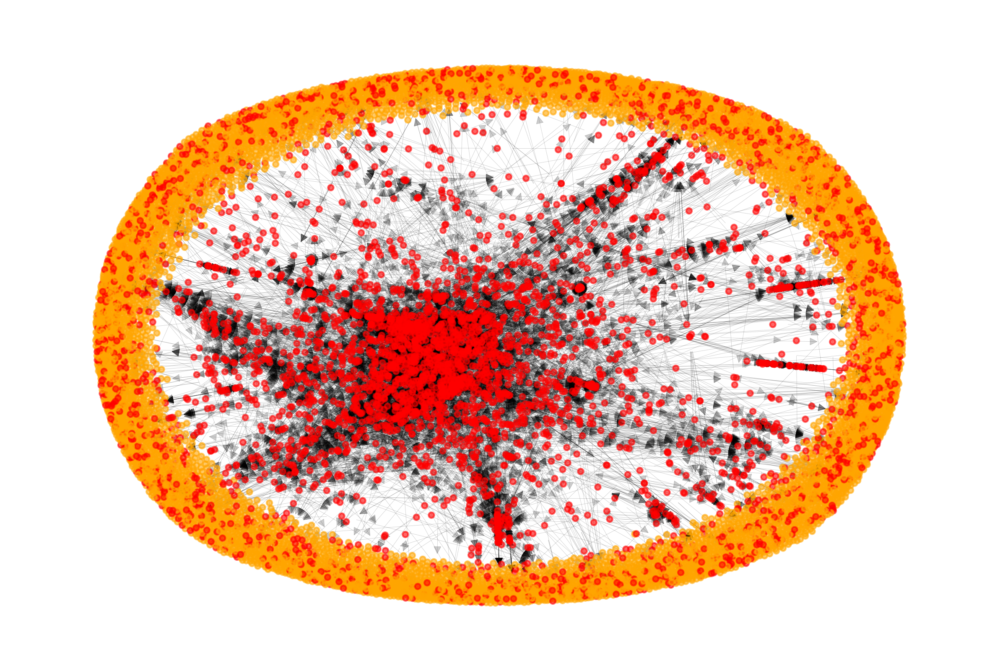

In [76]:
plot_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_network_plot_drugsonly.png')
plot_toggle = 1

if os.path.exists(plot_path) and plot_toggle==1:
    display(Image(filename=plot_path)) #load to save time
else:
    test_network_drugsonly = get_network(drug_nodes,drug_edges)

    pos = nx.spring_layout(test_network_drugsonly)
    ordered_node_colors = [test_network_drugsonly.nodes[node].get('colour', '#000000') for node in test_network_drugsonly.nodes()]
    node_sizes = [30 if node == 'MONDO:0007739' else 10 for node in test_network_drugsonly.nodes()]
    plt.figure(figsize=(3000/300, 2000/300))  # 300dpi
    nx.draw_networkx_nodes(test_network_drugsonly, pos, node_size=node_sizes, node_color=ordered_node_colors, alpha=0.6)
    edge_colors = [test_network_drugsonly[u][v]['colour'] for u, v in test_network_drugsonly.edges()]
    nx.draw_networkx_edges(test_network_drugsonly, pos, width=0.2, alpha=0.2, edge_color=edge_colors)
    plt.axis('off')
    plt.savefig(plot_path, format="png", dpi=300, bbox_inches='tight', pad_inches=0.1)

And finally the entire network of associations to ```MONDO:0007743``` and all drugs from DGIdb:

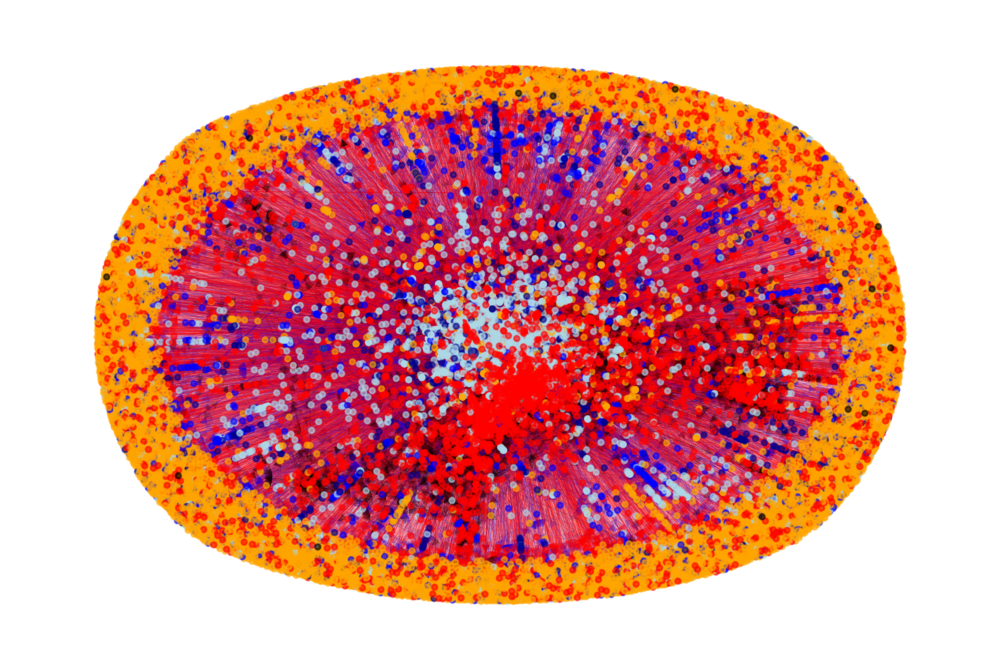

In [77]:
all_nodes = nodes + drug_nodes
all_edges = edges + drug_edges

plot_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_network_plot_entire.png')
plot_toggle = 1

if os.path.exists(plot_path) and plot_toggle==1:
    display(Image(filename=plot_path)) #load to save time
else:
    test_network_entire = get_network(all_nodes,all_edges)

    pos = nx.spring_layout(test_network_entire)
    ordered_node_colors = [test_network_entire.nodes[node].get('colour', '#000000') for node in test_network_entire.nodes()]
    node_sizes = [30 if node == 'MONDO:0007739' else 10 for node in test_network_entire.nodes()]
    plt.figure(figsize=(3000/300, 2000/300))  # 300dpi
    nx.draw_networkx_nodes(test_network_entire, pos, node_size=node_sizes, node_color=ordered_node_colors, alpha=0.6)
    edge_colors = [test_network_entire[u][v]['colour'] for u, v in test_network_entire.edges()]
    nx.draw_networkx_edges(test_network_entire, pos, width=0.2, alpha=0.2, edge_color=edge_colors)
    plt.axis('off')
    plt.savefig(plot_path, format="png", dpi=300, bbox_inches='tight', pad_inches=0.1)

Below instead the test for ```get_embeddings()``` (input = networkX object, nodetype to focus on; output = embeddings pickle object) which retrieves the embedding vector for a given network:

In [78]:
test_gene_embeddings = get_embeddings(test_network,emb_t=0,node_type_select='gene')

Generating walks (CPU: 2): 100%|██████████| 100/100 [00:00<00:00, 105.27it/s]


PKL files saved in network directory.


Below instead the **```fuse_embeddings()```** function (input = embedding dictionary for the gene nodes in the association network, embedding dictionary for the drug nodes in the association network, embedding dictionary for the drug nodes in the entire DGIdb, list of edges for drugs from the entire DGIdb based on similarity, list of nodes in the association network, list of drug nodes in the entire DGIdb; output = training dataframe, prediction dataframe) which is used to obtain the training and prediction dataframes to used in function ```ml_prediction()``` (input = training dataframe, prediction dataframe, number of cores, depth of the parameter optimisation, seed; output = dataframe of predicted edges).

In [79]:
# version 1
def fuse_embeddings(gene_embedding_dict, drug_embedding_dict, alldrug_embedding_dict, DGIdb_edges_list, nodes_list, alldrug_nodes_list):
    '''
    This function fuses the embeddings for the genes and drugs that have a known link,
    and adds additional drug-gene pairs with random non-known links for prediction.
    Structure of embedding dictionaries: {key: gene/drug, value: embedding}

    :param gene_embedding_dict: all gene embeddings associated to 'input_seed'.
    :param drug_embedding_dict: all drug embeddings associated to 'input_seed'.
    :param alldrug_embedding_dict: all drug embeddings with entire 'DGIdb'.
    :param DGIdb_edges_list: list of gene-to-drug edges from 'run_dgidb()'.
    :param nodes_list: list of nodes associated to 'input_seed'.
    :param alldrug_nodes_list: list of nodes with entire 'DGIdb'.
    :return: dataframes used to train the XGboost model, and subsequently test it.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")

    embedding_start_time = time.time()

    print('Embeddings are being fused, be patient.')
    
    array_drugs = np.array(list(drug_embedding_dict.keys()))
    array_alldrugs = np.array(list(alldrug_embedding_dict.keys()))
    array_genes = np.array(list(gene_embedding_dict.keys()))

    DGIdb_edges_df = pd.DataFrame({
        'subject_id': [edge[0]['id'] for edge in DGIdb_edges_list],
        'object_id': [edge[2]['id'] for edge in DGIdb_edges_list],
        'relation': [edge[1]['label'] for edge in DGIdb_edges_list]
    })

    def is_interaction_present(gene_id, drug_id):
        return (
            ((DGIdb_edges_df['subject_id'] == gene_id) & (DGIdb_edges_df['object_id'] == drug_id))
            | ((DGIdb_edges_df['subject_id'] == drug_id) & (DGIdb_edges_df['object_id'] == gene_id))
        ).any()

    # create gene-to-drug interaction dataframe for training
    train_rows = []

    for gene in array_genes:
        gene_emb = gene_embedding_dict[gene]
        for drug in array_drugs:
            fused_emb = np.multiply(gene_emb, drug_embedding_dict[drug])
            class_label = 1 if is_interaction_present(gene, drug) else 0
            train_rows.append({
                'gene': gene, 'drug': drug, 'fused_embedding': fused_emb, 'class': class_label
            })
    train_df = pd.DataFrame(train_rows)

    # create interaction dataframe for prediction with additional drugs
    predict_rows = []

    for gene in array_genes:
        gene_emb = gene_embedding_dict[gene]
        for drug in array_alldrugs:
            fused_emb = np.multiply(gene_emb, alldrug_embedding_dict[drug])
            predict_rows.append({
                'gene': gene, 'drug': drug, 'fused_embedding': fused_emb, 'class': np.nan
            })
    predict_df = pd.DataFrame(predict_rows)

    # save the training and prediction dataframes to CSV files
    train_df_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_training_df.csv')
    train_df.to_csv(train_df_path, index=False)
    predict_df_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_prediction_df.csv')
    predict_df.to_csv(predict_df_path, index=False)

    embedding_end_time = time.time()
    duration = embedding_end_time - embedding_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"Embedding fusion finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"Embedding fusion finished in {minutes} minutes and {seconds} seconds.")

    return train_df, predict_df

In [80]:
def is_interaction_present(gene_id, drug_id):
    return (
        ((DGIdb_edges_df['subject_id'] == gene_id) & (DGIdb_edges_df['object_id'] == drug_id))
        | ((DGIdb_edges_df['subject_id'] == drug_id) & (DGIdb_edges_df['object_id'] == gene_id))
    ).any()

# version 2 (with loading check)
def fuse_embeddings(gene_embedding_dict, drug_embedding_dict, alldrug_embedding_dict, DGIdb_edges_list, nodes_list, alldrug_nodes_list,emb_t):
    '''
    This function fuses the embeddings for the genes and drugs that have a known link,
    and adds additional drug-gene pairs with random non-known links for prediction.
    Structure of embedding dictionaries: {key: gene/drug, value: embedding}

    :param gene_embedding_dict: all gene embeddings associated to 'input_seed'.
    :param drug_embedding_dict: all drug embeddings associated to 'input_seed'.
    :param alldrug_embedding_dict: all drug embeddings with entire 'DGIdb'.
    :param DGIdb_edges_list: list of gene-to-drug edges from 'run_dgidb()'.
    :param nodes_list: list of nodes associated to 'input_seed'.
    :param alldrug_nodes_list: list of nodes with entire 'DGIdb'.
    :param emb_t: 1 to look for existing embedding files to load instead of generating new ones,
        0 to ignore the loading check.
    :return: dataframes used to train the XGboost model, and subsequently test it.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")

    embedding_start_time = time.time()

    print('Embeddings are being fused, be patient.')

    # CSV file paths
    train_df_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_training_df.csv')
    predict_df_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_prediction_df.csv')
    
    # check if already present, if toggled:
    if emb_t == 1 and os.path.exists(train_df_path) and os.path.exists(predict_df_path):
        logging.info(f"Loading training and prediction dataframes from existing files: {train_df_path} and {predict_df_path}")
        train_df = pd.read_csv(train_df_path)
        predict_df = pd.read_csv(predict_df_path)

        # Convert fused_embedding column from string to numpy array
        train_df['fused_embedding'] = train_df['fused_embedding'].apply(lambda x: np.fromstring(x.strip('[]'), sep=' '))
        predict_df['fused_embedding'] = predict_df['fused_embedding'].apply(lambda x: np.fromstring(x.strip('[]'), sep=' '))

    # otherwise fuse
    else:
        array_drugs = np.array(list(drug_embedding_dict.keys()))
        array_alldrugs = np.array(list(alldrug_embedding_dict.keys()))
        array_genes = np.array(list(gene_embedding_dict.keys()))

        DGIdb_edges_df = pd.DataFrame({
            'subject_id': [edge[0]['id'] for edge in DGIdb_edges_list],
            'object_id': [edge[2]['id'] for edge in DGIdb_edges_list],
            'relation': [edge[1]['label'] for edge in DGIdb_edges_list]
        })

        # create gene-to-drug interaction dataframe for training
        train_rows = []

        for gene in array_genes:
            gene_emb = gene_embedding_dict[gene]
            for drug in array_drugs:
                fused_emb = np.multiply(gene_emb, drug_embedding_dict[drug])
                class_label = 1 if is_interaction_present(gene, drug) else 0
                train_rows.append({
                    'gene': gene, 'drug': drug, 'fused_embedding': fused_emb, 'class': class_label
                })
        train_df = pd.DataFrame(train_rows)

        # create interaction dataframe for prediction with additional drugs
        predict_rows = []

        for gene in array_genes:
            gene_emb = gene_embedding_dict[gene]
            for drug in array_alldrugs:
                fused_emb = np.multiply(gene_emb, alldrug_embedding_dict[drug])
                predict_rows.append({
                    'gene': gene, 'drug': drug, 'fused_embedding': fused_emb, 'class': np.nan
                })
        predict_df = pd.DataFrame(predict_rows)

        # save the training and prediction dataframes to CSV files
        train_df.to_csv(train_df_path, index=False)
        predict_df.to_csv(predict_df_path, index=False)

    embedding_end_time = time.time()
    duration = embedding_end_time - embedding_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"Embedding fusion finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"Embedding fusion finished in {minutes} minutes and {seconds} seconds.")

    return train_df, predict_df

And finally the **```ml_prediction()```** function which runs the XGboost unsupervised learning model:

In [81]:
# version 1 (not fully random/controlled)
def ml_prediction(train_df, predict_df,input_jobs=(num_cores//2),depth='full',random_seed=123):
    '''
    This function builds a unsupervised learning model using as training data 
    the network of interactions between biological associations (via 'Monarch.py'),
    gene-to-drug associations (via 'DGIdb.py'), and drug-to-drug similarity (via
    'drug_similarity.py') –to then predict new interactions.
    
    :param train_df: dataframe of (gene, drug, embedding, class) used for training.
    :param predict_df: dataframe of (gene, drug, embedding, class) used for prediction.
    :param input_jobs: how many CPU cores to use ('-1' uses all available).
    :param depth: based on this, different sets of parameters, splits, repeats and iterations
        are performed (default = 'full', factor of 'full', 'light' and 'ultralight').
    :param random_seed: seed to have consistent results (default = 123).
    :return: dataframe of newly predicted interactions.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")
    
    global nodes
    global drug_nodes

    print('ML model is being trained, be patient.')
    ml_train_start_time = time.time()

    # MODEL TRAINING
    # X = embeddings (turn list of embeddings into columns)
    emb_col = train_df['fused_embedding']
    X = pd.DataFrame(emb_col.tolist())
    X = X.astype(float)
    
    # y = labels
    y = train_df['class'].astype(int)
    unique_classes = np.unique(y)

    # define parameters to be tuned, and model
    if depth == 'full':
        parameters = {
            'min_child_weight': [2, 3, 5, 8, 13, 20, 30],
            'gamma': [0, 0.2, 0.5, 0.8, 1.2, 1.6, 2.5, 4, 6],
            'reg_alpha': [0, 0.5, 1, 3, 5, 10],
            'reg_lambda': [0, 0.5, 1, 3, 5, 10],
            'subsample': uniform(0.5, 0.5),  # = uniform distribution on (0.5, 1)
            'colsample_bytree': uniform(0.2, 0.8),  # = uniform distribution on (0.2, 1)
            'max_depth': [4, 6, 8, 10, 12, 14, 16],
            'n_estimators': [35, 45, 50, 70, 80, 90, 100],
            'learning_rate': uniform(0, 0.3),
        }
        n_s = 10  # number of splits
        n_r = 5  # number of repeats
        n_i = 20  # number of iterations
    elif depth == 'light':
        parameters = {
            'min_child_weight': [3, 8, 20],
            'gamma': [0.5, 1.2, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20, 30],
            'learning_rate': [0.1],
        }
        n_s = 3  # number of splits
        n_r = 2  # number of repeats
        n_i = 5  # number of iterations
    elif depth == 'ultralight':
        parameters = {
            'min_child_weight': [5, 20],
            'gamma': [0.5, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20],
            'learning_rate': [0.1],
        }
        n_s = 2  # number of splits
        n_r = 1  # number of repeats
        n_i = 5  # number of iterations
    xgb_model_hyp = XGBClassifier(objective='multi:softmax', eval_metric='mlogloss',num_class=len(unique_classes),random_state=random_seed)

    # find the best hyperparameters using repeated stratified k-fold and randomized search
    rskf = RepeatedStratifiedKFold(n_splits=n_s, n_repeats=n_r, random_state=random_seed)
    randomized_search = RandomizedSearchCV(xgb_model_hyp, param_distributions=parameters,
                                           scoring='f1_weighted', n_iter=n_i, n_jobs=input_jobs,
                                           error_score='raise', cv=rskf.split(X, y), verbose=1,
                                           refit=True)  # refit: train with best hyperparameters found
    # make sure weights for training are added to avoid unbalanced training
    weight = class_weight.compute_sample_weight('balanced', y)
    randomized_search.fit(X, y, sample_weight=weight)

    # report best parameters and best model (scores)
    print('best found hyperparameters:', randomized_search.best_params_)
    print('score of the model:', randomized_search.best_score_)

    ml_train_end_time = time.time()
    duration = ml_train_end_time - ml_train_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"XGBoost model training finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"XGBoost model training finished in {minutes} minutes and {seconds} seconds.")
    
    print('Prediction is being made, be patient.')
    ml_predict_start_time = time.time()
    
    # INTERACTION PREDICTION
    emb_col_pred = predict_df['fused_embedding']
    X_pred = pd.DataFrame(emb_col_pred.tolist())
    X_pred = X_pred.astype(float)
    predictions = randomized_search.predict(X_pred)
    predictions_prob = randomized_search.predict_proba(X_pred)
    interaction_predictions_df = pd.DataFrame(
        {'drug': predict_df['drug'],
         'gene': predict_df['gene'],
         'predicted_interaction': predictions,
         'prob': np.max(predictions_prob, axis=1)
         })
    
    # add labels to the drugs and genes for better readability
    all_nodes = nodes + drug_nodes
    id_to_label = {node['id']: node['label'] for node in all_nodes}

    interaction_predictions_df['drug'] = interaction_predictions_df['drug'].apply(
        lambda drug_uri: f'<a href="{drug_uri}">{id_to_label.get(drug_uri, drug_uri)}</a>'
    )
    interaction_predictions_df['gene'] = interaction_predictions_df['gene'].apply(
        lambda gene_uri: f'<a href="{gene_uri}">{id_to_label.get(gene_uri, gene_uri)}</a>'
    )
    
    # save output files
    interaction_predictions_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_predicted_df.csv')
    interaction_predictions_df.to_csv(interaction_predictions_path, index=False)

    ml_predict_end_time = time.time()
    duration = ml_predict_end_time - ml_predict_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")

    return interaction_predictions_df

In [82]:
# version 2
def ml_prediction(train_df, predict_df, input_jobs=(num_cores // 2), depth='light', input_seed='random'):
    '''
    This function builds a supervised learning model using as training data 
    the network of interactions between biological associations (via 'Monarch.py'),
    gene-to-drug associations (via 'DGIdb.py'), and drug-to-drug similarity (via
    'drug_similarity.py') –to then predict new interactions.
    
    :param train_df: dataframe of (gene, drug, embedding, class) used for training.
    :param predict_df: dataframe of (gene, drug, embedding, class) used for prediction.
    :param input_jobs: how many CPU cores to use ('-1' uses all available, just for repetition).
    :param depth: based on this, different sets of parameters, splits, repeats and iterations
        are performed (default = 'full', factor of 'full', 'light' and 'ultralight', just for repetition).
    :param random_seed: seed to have consistent results (default = None, random, just for repetition).
    :return: dataframe of newly predicted interactions.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")

    global nodes
    global drug_nodes

    if input_seed == 'random':
        input_seed = np.random.randint(1, 1e6)

    with open(input_file_path, 'a') as file:
        file.write(f"The XGBoost prediction is run on ({input_jobs}) cores with seed ({input_seed}).\n")
        file.write(f"A ({depth}) parameter optimisation step is performed.\n")

    print('ML model is being trained, be patient.')
    ml_train_start_time = time.time()

    # MODEL TRAINING
    # X = embeddings (turn list of embeddings into columns)
    emb_col = train_df['fused_embedding']
    X = pd.DataFrame(emb_col.tolist())
    X = X.astype(float)

    # y = labels
    y = train_df['class'].astype(int)
    unique_classes = np.unique(y)

    # define parameters to be tuned, and model
    if depth == 'full':
        parameters = {
            'min_child_weight': [2, 3, 5, 8, 13, 20, 30],
            'gamma': [0, 0.2, 0.5, 0.8, 1.2, 1.6, 2.5, 4, 6],
            'reg_alpha': [0, 0.5, 1, 3, 5, 10],
            'reg_lambda': [0, 0.5, 1, 3, 5, 10],
            'subsample': uniform(0.5, 0.5),  # = uniform distribution on (0.5, 1)
            'colsample_bytree': uniform(0.2, 0.8),  # = uniform distribution on (0.2, 1)
            'max_depth': [4, 6, 8, 10, 12, 14, 16],
            'n_estimators': [35, 45, 50, 70, 80, 90, 100],
            'learning_rate': uniform(0, 0.3),
        }
        n_s = 10  # number of splits
        n_r = 5  # number of repeats
        n_i = 20  # number of iterations
    elif depth == 'light':
        parameters = {
            'min_child_weight': [3, 8, 20],
            'gamma': [0.5, 1.2, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20, 30],
            'learning_rate': [0.1],
        }
        n_s = 3  # number of splits
        n_r = 2  # number of repeats
        n_i = 5  # number of iterations
    elif depth == 'ultralight':
        parameters = {
            'min_child_weight': [5, 20],
            'gamma': [0.5, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20],
            'learning_rate': [0.1],
        }
        n_s = 2  # number of splits
        n_r = 1  # number of repeats
        n_i = 5  # number of iterations
    xgb_model_hyp = XGBClassifier(objective='multi:softmax', eval_metric='mlogloss', num_class=len(unique_classes), random_state=input_seed, n_jobs=input_jobs)

    params_file_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_hyperparameters.txt')

    # check if the parameters file is already present
    best_params = None
    best_score = None
    if os.path.exists(params_file_path):
        with open(params_file_path, 'r') as file:
            best_params = eval(file.read())
        xgb_model_hyp.set_params(**best_params)
        # fit the model with the loaded parameters
        xgb_model_hyp.fit(X, y)
    else:
        # find the best hyperparameters using repeated stratified k-fold and randomized search
        rskf = RepeatedStratifiedKFold(n_splits=n_s, n_repeats=n_r, random_state=input_seed)
        randomized_search = RandomizedSearchCV(xgb_model_hyp, param_distributions=parameters,
                                               scoring='f1_weighted', n_iter=n_i, n_jobs=input_jobs,
                                               error_score='raise', cv=rskf.split(X, y), verbose=1,
                                               refit=True, random_state=input_seed)  # refit: train with best hyperparameters found
        # make sure weights for training are added to avoid unbalanced training
        weight = class_weight.compute_sample_weight('balanced', y)
        randomized_search.fit(X, y, sample_weight=weight)

        # save the best parameters
        with open(params_file_path, 'w') as file:
            file.write(str(randomized_search.best_params_))

        best_params = randomized_search.best_params_
        best_score = randomized_search.best_score_
        xgb_model_hyp = randomized_search.best_estimator_

    xgb_model_hyp.set_params(**best_params)

    # report best parameters and best model (scores)
    logging.info(f'best found hyperparameters: {best_params}')
    print(f'best found hyperparameters: {best_params}')
    if best_score is not None:
        logging.info(f'score of the model: {best_score}')
        print(f'score of the model: {best_score}')
        with open(input_file_path, 'a') as file:
            file.write(f"The model with parameters ({best_params}) obtained a ({best_score}) score.\n\n")

    ml_train_end_time = time.time()
    duration = ml_train_end_time - ml_train_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"XGBoost model training finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"XGBoost model training finished in {minutes} minutes and {seconds} seconds.")

    print('Prediction is being made, be patient.')
    ml_predict_start_time = time.time()

    # INTERACTION PREDICTION
    emb_col_pred = predict_df['fused_embedding']
    X_pred = pd.DataFrame(emb_col_pred.tolist())
    X_pred = X_pred.astype(float)
    predictions = xgb_model_hyp.predict(X_pred)
    predictions_prob = xgb_model_hyp.predict_proba(X_pred)
    interaction_predictions_df = pd.DataFrame(
        {'drug': predict_df['drug'],
         'gene': predict_df['gene'],
         'predicted_interaction': predictions,
         'prob': np.max(predictions_prob, axis=1)
         })

    # add labels to the drugs and genes for better readability
    all_nodes = nodes + drug_nodes
    id_to_label = {node['id']: node['label'] for node in all_nodes}

    interaction_predictions_df['drug'] = interaction_predictions_df['drug'].apply(
        lambda drug_uri: f'<a href="{drug_uri}">{id_to_label.get(drug_uri, drug_uri)}</a>'
    )
    interaction_predictions_df['gene'] = interaction_predictions_df['gene'].apply(
        lambda gene_uri: f'<a href="{gene_uri}">{id_to_label.get(gene_uri, gene_uri)}</a>'
    )

    # save output files
    interaction_predictions_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_predicted_df.csv')
    interaction_predictions_df.to_csv(interaction_predictions_path, index=False)

    ml_predict_end_time = time.time()
    duration = ml_predict_end_time - ml_predict_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")

    return interaction_predictions_df

In [83]:
# version 3
def ml_prediction(train_df,predict_df,param_t,input_jobs=(num_cores // 2),depth='light',input_seed='random'):
    '''
    This function builds a supervised learning model using as training data 
    the network of interactions between biological associations (via 'Monarch.py'),
    gene-to-drug associations (via 'DGIdb.py'), and drug-to-drug similarity (via
    'drug_similarity.py') –to then predict new interactions.
    
    :param train_df: dataframe of (gene, drug, embedding, class) used for training.
    :param predict_df: dataframe of (gene, drug, embedding, class) used for prediction.
    :param param_t: 1 to look for existing optimised parameter file to load instead of performing
        a new parameter optimisation step, 0 to ignore the parameter check.
    :param input_jobs: how many CPU cores to use ('-1' uses all available, just for repetition).
    :param depth: based on this, different sets of parameters, splits, repeats and iterations
        are performed (default = 'full', factor of 'full', 'light' and 'ultralight', just for repetition).
    :param random_seed: seed to have consistent results (default = None, random, just for repetition).
    :return: dataframe of newly predicted interactions.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")

    global nodes
    global drug_nodes

    if input_seed == 'random':
        input_seed = np.random.randint(1, 1e6)

    with open(input_file_path, 'a') as file:
        file.write(f"The XGBoost prediction is run on ({input_jobs}) cores with seed ({input_seed}).\n")
        file.write(f"A ({depth}) parameter optimisation step is performed.\n")

    print('ML model is being trained, be patient.')
    ml_train_start_time = time.time()

    # MODEL TRAINING
    # X = embeddings (turn list of embeddings into columns)
    emb_col = train_df['fused_embedding']
    X = pd.DataFrame(emb_col.tolist())
    X = X.astype(float)

    # y = labels
    y = train_df['class'].astype(int)
    unique_classes = np.unique(y)

    # define parameters to be tuned, and model
    if depth == 'full':
        parameters = {
            'min_child_weight': [2, 3, 5, 8, 13, 20, 30],
            'gamma': [0, 0.2, 0.5, 0.8, 1.2, 1.6, 2.5, 4, 6],
            'reg_alpha': [0, 0.5, 1, 3, 5, 10],
            'reg_lambda': [0, 0.5, 1, 3, 5, 10],
            'subsample': uniform(0.5, 0.5),  # = uniform distribution on (0.5, 1)
            'colsample_bytree': uniform(0.2, 0.8),  # = uniform distribution on (0.2, 1)
            'max_depth': [4, 6, 8, 10, 12, 14, 16],
            'n_estimators': [35, 45, 50, 70, 80, 90, 100],
            'learning_rate': uniform(0, 0.3),
        }
        n_s = 10  # number of splits
        n_r = 5  # number of repeats
        n_i = 20  # number of iterations
    elif depth == 'light':
        parameters = {
            'min_child_weight': [3, 8, 20],
            'gamma': [0.5, 1.2, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20, 30],
            'learning_rate': [0.1],
        }
        n_s = 3  # number of splits
        n_r = 2  # number of repeats
        n_i = 5  # number of iterations
    elif depth == 'ultralight':
        parameters = {
            'min_child_weight': [5, 20],
            'gamma': [0.5, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20],
            'learning_rate': [0.1],
        }
        n_s = 2  # number of splits
        n_r = 1  # number of repeats
        n_i = 5  # number of iterations

    params_file_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_hyperparameters.txt')

    # check if the parameters file is already present: if so and if toggled, run with unique parameters
    if param_t==1 and os.path.exists(params_file_path):
        with open(params_file_path, 'r') as file:
            param_dict = ast.literal_eval(file.read())
        parameters = {k: [v] for k, v in param_dict.items()}
        n_s = 2  # number of splits
        n_r = 1  # number of repeats
        n_i = 1  # number of iterations
    
    xgb_model_hyp = XGBClassifier(objective='multi:softmax', eval_metric='mlogloss', num_class=len(unique_classes), random_state=input_seed, n_jobs=input_jobs)

    rskf = RepeatedStratifiedKFold(n_splits=n_s, n_repeats=n_r, random_state=input_seed)
    randomized_search = RandomizedSearchCV(xgb_model_hyp, param_distributions=parameters,
                                            scoring='f1_weighted', n_iter=n_i, n_jobs=input_jobs,
                                            error_score='raise', cv=rskf.split(X, y), verbose=1,
                                            refit=True, random_state=input_seed)  # refit: train with best hyperparameters found
    # make sure weights for training are added to avoid unbalanced training
    weight = class_weight.compute_sample_weight('balanced', y)
    randomized_search.fit(X, y, sample_weight=weight)

    # save the best parameters
    with open(params_file_path, 'w') as file:
        file.write(str(randomized_search.best_params_))

    best_params = randomized_search.best_params_
    best_score = randomized_search.best_score_
    xgb_model_hyp = randomized_search.best_estimator_
    
    xgb_model_hyp.set_params(**best_params)

    # report best parameters and best model (scores)
    logging.info(f'best found hyperparameters: {best_params}')
    print(f'best found hyperparameters: {best_params}')
    if best_score is not None:
        logging.info(f'score of the model: {best_score}')
        print(f'score of the model: {best_score}')
        with open(input_file_path, 'a') as file:
            file.write(f"The model with parameters ({best_params}) obtained a ({best_score}) score.\n\n")

    ml_train_end_time = time.time()
    duration = ml_train_end_time - ml_train_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"XGBoost model training finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"XGBoost model training finished in {minutes} minutes and {seconds} seconds.")

    print('Prediction is being made, be patient.')
    ml_predict_start_time = time.time()

    # INTERACTION PREDICTION
    emb_col_pred = predict_df['fused_embedding']
    X_pred = pd.DataFrame(emb_col_pred.tolist())
    X_pred = X_pred.astype(float)
    predictions = xgb_model_hyp.predict(X_pred)
    predictions_prob = xgb_model_hyp.predict_proba(X_pred)
    interaction_predictions_df = pd.DataFrame(
        {'drug': predict_df['drug'],
         'gene': predict_df['gene'],
         'predicted_interaction': predictions,
         'prob': np.max(predictions_prob, axis=1)
         })

    # add labels to the drugs and genes for better readability
    all_nodes = nodes + drug_nodes
    id_to_label = {node['id']: node['label'] for node in all_nodes}

    interaction_predictions_df['drug'] = interaction_predictions_df['drug'].apply(
        lambda drug_uri: f'<a href="{drug_uri}">{id_to_label.get(drug_uri, drug_uri)}</a>'
    )
    interaction_predictions_df['gene'] = interaction_predictions_df['gene'].apply(
        lambda gene_uri: f'<a href="{gene_uri}">{id_to_label.get(gene_uri, gene_uri)}</a>'
    )

    # save output files
    interaction_predictions_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_predicted_df.csv')
    interaction_predictions_df.to_csv(interaction_predictions_path, index=False)

    ml_predict_end_time = time.time()
    duration = ml_predict_end_time - ml_predict_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")

    return interaction_predictions_df

The test above for function **```ml_prediction()```** (input = dataframe to train on, dataframe to predict on, number of CPU cores to use, set of parameters to use; ouput = dataframe of predictions) is very quick and oversimplified, just to be able to process the remaining data. The full run takes instead 1000 fits, being extremely more intensive on the CPU anyway (even with just 2 cores out of 10, it overclocks them to 400% maximum vCPU).

The first test run lead to a grand total of **```708.186```** associations, which get down to ```30.024``` and ```6.815``` if we only consider those respectively with at least 65% and 70% of probability -based on the run using DGIdb's new V5 API, and considering three layers.

Below function **```filter_rank_drugs()```** (input = dataframe of predicted drug-to-gene edges, prediction probability above which edges are considered valid, proportion of minimum number of genes associated to a given drug compared to the max number of genes associated to a drug; output = list of drugs and the number of genes it is associated to, the list of new gene-to-drug edges) which replaces CR's original ```drug_list_rank()``` (input = dataframe of predicted drug-to-gene edges, prediction probability above which edges are considered valid; output = multi-index dataframe) adding a step that removes gene-to-drug associations that were already know and ranks the remaining based on node centrality (*i.e.* both the most central and the least central were tested) and prediction confidence reported in column ```prob``` of ```ml_prediction()```'s output:

In [84]:
def extract_id_label(href):
    '''
    Simple function to extrapolate 'id' and 'label' from href in 'prefict_df'.

    :param href: long string for 'id' and 'label' combined
    :return: 'id', and 'label' short strings
    '''
    
    id_match = re.search(r'<a href="([^"]+)">', href)
    label_match = re.search(r'<a href="[^"]+">([^<]+)</a>', href)
    
    if id_match and label_match:
        return id_match.group(1), label_match.group(1)
    else:
        logging.error(f"Failed to extract id and label from href: {href}")
        return None, None


def filter_rank_drugs(predict_df,prob_threshold=0.65,cluster_threshold=0.8,over_under=1):
    '''
    This function filters predicted drug-gene interactions based on probability
    and ranks drugs based on their interactions with genes.
    
    :param predict_df: dataframe containing predictions with columns 
        ['drug', 'gene', 'predicted_interaction', 'prob']
    :param prob_threshold: probability threshold for filtering predictions
    :param cluster_threshold: cluster threshold for ranking drugs
    :param over_under: toggle to filter above or below cluster_threshold
    :return: ranked list of drugs with counter, and list of predicted edges
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")
    
    global nodes
    
    # filter the dataframe
    filt_df = predict_df[(predict_df['predicted_interaction'] == 1) & (predict_df['prob'] >= prob_threshold)]
    
    # remove any drug already present in 'nodes'
    nodes_set = {node['id'] for node in nodes}
    new_df = filt_df[~filt_df['drug'].isin(nodes_set)]
    
    # rank drugs based on how many genes each drug interacts with
    drug_counts = new_df['drug'].value_counts()
    max_count = drug_counts.max()
    threshold_count = max_count * cluster_threshold
    if over_under == 1:
        ranked_drugs = drug_counts[drug_counts >= threshold_count].index.tolist()
    elif over_under == 0:
        ranked_drugs = drug_counts[drug_counts <= threshold_count].index.tolist()
    
    # create the ranked list with counts
    ranked_list = []
    for drug_href in ranked_drugs:
        drug_id, drug_label = extract_id_label(drug_href)
        if drug_id and drug_label:
            ranked_list.append({'id': drug_id, 'label': drug_label, 'count': drug_counts[drug_href]})
    
    # create a ranked dataframe
    ranked_df = new_df[new_df['drug'].isin(ranked_drugs)]
    
    # build the list of new 'edges'
    id_to_label = {node['id']: node['label'] for node in nodes}
    predict_edges = []
    for _, row in ranked_df.iterrows():
        gene_href = row['gene']
        drug_href = row['drug']
        gene_id, gene_label = extract_id_label(gene_href)
        drug_id, drug_label = extract_id_label(drug_href)
        
        edge = [
            {'id': gene_id, 'label': gene_label},
            {'label': 'xgboost:has_association'},
            {'id': drug_id, 'label': drug_label},
            {'notes': row['prob']}
        ]
        predict_edges.append(edge)
    
    return ranked_list, predict_edges

Finally below macro-function **```run_network_model()```** (input = original input, date, inputs for ml_prediction(); output = list of edges after prediction, list of nodes after prediction, list of newly repurposed drugs with the number of genes associated to it) which runs all the steps involving training the model and making predictions based on the outputs of previous steps (*i.e.* ```Monarch.py```, ```DGIdb.py``` and ```drug_similarity.py```):

In [85]:
def absolute_value(val, sizes):
    '''
    This function is used in the probability proportion pie chart within 'run_network_model()'.

    :param val: numerical value.
    :param sizes: list of sizes for pie chart segments.
    :return: formatted string.
    '''
    
    total = sum(sizes)
    absolute = int(val / 100. * total)
    
    return f'{absolute}\n({val:.1f}%)'


def run_network_model(monarch_input,date,run_jobs=None,run_depth=None,run_seed=None,prob_input=None,clust_input=None,emb_toggle=1,param_toggle=1,ou_toggle=1):
    '''
    This function runs the entire network_model script and saves nodes and edges files
    after a prediction made via XGBoost.

    :param monarch_input: the input seed from the run_monarch() step.
    :param date: the date of creation of the disease graph.
    :param run_jobs: any value that would override default input_jobs=(num_cores//2) in 
        ml_prediction().
    :param run_depth: any value that would override default depth='full' in ml_prediction().
    :param run_seed: any value that would override default random_seed=123 in ml_prediction().
    :param prob_input: any value that would override default prob_threshold=0.65 in filter_rank_drugs().
    :param clust_input: any value that would override default cluster_threshold=0.8 in filter_rank_drugs().
    :param emb_toggle: 1 to look for existing embedding files to load instead of generating new ones,
        0 to ignore the loading check in get_embeddings() and fuse_embeddings().
    :param param_toggle: 1 to look for existing optimised parameter file to load instead of performing
        a new parameter optimisation step, 0 to ignore the parameter check in ml_prediction().
    :param out_toggle: 1 to consider over clust_input, 0 to consider under clust_input in filter_rank_drugs().
    :return: list of edges after the prediction, list of nodes after the prediction, list of newly
        repurposed drugs found by the prediction.
    '''

    start_time = time.time()
    
    logging.info(f"NOW RUNNING: {current_function_name()} following 'drug_similarity({monarch_input},{today},min_simil={input_min_simil})'.")
    
    global nodes, edges, drug_nodes, drug_edges

    node_type_dict = {
        'disease': ['MONDO'],
        'gene': ['HGNC', 'MGI', 'GO', 'NCBIgene', 'ZFIN', 'Xenbase'],
        'phenotype': ['HP'],
        'drug': ['chembl', 'wikidata']
    }
    
    network_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'network')
    os.makedirs(network_directory, exist_ok=True)

    # generate networks for biological associations and drug database
    embedding_start_time = time.time()
    print('Embeddings are being generated, be patient.')
    
    full_network = get_network(nodes,edges)
    partial_alldrug_network = get_network(drug_nodes,drug_edges,exclude='dgidb:')
    
    drug_embeddings = get_embeddings(full_network,emb_toggle,node_type_select='drug')
    alldrug_embeddings = get_embeddings(partial_alldrug_network,emb_toggle,node_type_select='drug')
    gene_embeddings = get_embeddings(full_network,emb_toggle,node_type_select='gene')

    embedding_end_time = time.time()
    duration = embedding_end_time - embedding_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"Embedding generation finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"Embedding generation finished in {minutes} minutes and {seconds} seconds.")

    DGIdb_edges = [edge for edge in edges if 'dgidb' in edge[1]['label']]
    training_df, prediction_df = fuse_embeddings(gene_embeddings,drug_embeddings,alldrug_embeddings,DGIdb_edges,nodes,drug_nodes,emb_toggle)

    # train the model and make the predictions
    if not run_seed:
        run_seed = 'random'
    if not run_depth:
        run_depth = 'light'
    if not run_jobs:
        run_jobs = (num_cores//2)
    predicted_df = ml_prediction(training_df,prediction_df,param_toggle,input_jobs=run_jobs,depth=run_depth,input_seed=run_seed)

    # generate prediction outcome proportion plot
    num_ones = (predicted_df['predicted_interaction'] == 1).sum()
    num_zeros = (predicted_df['predicted_interaction'] == 0).sum()
    plt.figure(figsize=(8, 8))
    labels = 'Predicted Interactions (1)', 'No Interactions (0)'
    sizes = [num_ones, num_zeros]
    colors = ['#ff9999', '#66b3ff']
    explode = (0.1, 0)
    plt.pie(sizes, explode=explode, labels=labels, colors=colors,
            autopct=lambda val: absolute_value(val, sizes), shadow=True, startangle=90)
    plt.axis('equal')
    pie_chart_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_interaction_pie_chart.png')
    plt.savefig(pie_chart_path, transparent=True)
    plt.close()
    
    # generate prediction probability distribution plot
    interaction_df = predicted_df[predicted_df['predicted_interaction'] == 1]
    interaction_probs = interaction_df['prob']
    plt.figure(figsize=(10, 6))
    plt.hist(interaction_probs, bins=30, edgecolor='k', alpha=0.7)
    plt.title('Distribution of Probabilities for Predicted Interactions')
    plt.xlabel('Probability')
    plt.ylabel('Frequency')
    plt.grid(True)
    hist_plot_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_probability_distribution.png')
    plt.savefig(hist_plot_path, transparent=True)
    plt.close()

    plot_paths = [pie_chart_path, hist_plot_path]

    # rank newly found / re-purposed drugs (from prediction)
    if not prob_input:
        prob_input = 0.65
    if not clust_input:
        clust_input = 0.8
    ranked_drug_list, predicted_edges = filter_rank_drugs(predicted_df,prob_threshold=prob_input,cluster_threshold=clust_input,over_under=ou_toggle)
    for ranked_drug_elem in ranked_drug_list:
        logging.info(f"{ranked_drug_elem['count']} new edge(s) for drug {ranked_drug_elem['id']}.")
        print(f"{ranked_drug_elem['count']} new edge(s) for drug {ranked_drug_elem['id']}.")
    
    full_edges = edges + drug_edges + predicted_edges
    full_nodes = [edge[0] for edge in full_edges] + [edge[2] for edge in full_edges]
    full_nodes = unique_elements(full_nodes)

    # save nodes and edges as CSV
    full_edges_df = pd.DataFrame(full_edges)
    full_edges_df.to_csv(os.path.join(network_directory, f'{disease_name_label}_{date_str}_fullnetwork_edges.csv'), index=False)
    full_nodes_df = pd.DataFrame(full_nodes)
    full_nodes_df.to_csv(os.path.join(network_directory, f'{disease_name_label}_{date_str}_fullnetwork_nodes.csv'), index=False)
    
    logging.info("CSV files saved in network directory.")

    end_time = time.time()
    duration = end_time - start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"'network_model.py' run finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"'network_model.py' run finished in {minutes} minutes and {seconds} seconds.")
    
    return full_edges, full_nodes, ranked_drug_list, plot_paths

In [86]:
num_jobs = 4
depth_input = 'ultralight'
seed_input = 1345
network_edges, network_nodes, ranked_drugs, plots = run_network_model(input_seed,today,run_jobs=num_jobs,run_depth=depth_input, run_seed=seed_input)
# also 'prob_input' and 'clust_input' can eventually be added as parameters

Embeddings are being generated, be patient.
Loading embeddings from existing file: /Users/ncmbianchi/DrugRepurposing/NOT_TO_PUSH/NICCOLOs/PIPELINE/drugapp/data/2024-07-31/Huntington disease (2024-07-31)/network/Huntington disease_2024-07-31_embedding_dict_drug.pkl
Loading embeddings from existing file: /Users/ncmbianchi/DrugRepurposing/NOT_TO_PUSH/NICCOLOs/PIPELINE/drugapp/data/2024-07-31/Huntington disease (2024-07-31)/network/Huntington disease_2024-07-31_embedding_dict_drug.pkl
Loading embeddings from existing file: /Users/ncmbianchi/DrugRepurposing/NOT_TO_PUSH/NICCOLOs/PIPELINE/drugapp/data/2024-07-31/Huntington disease (2024-07-31)/network/Huntington disease_2024-07-31_embedding_dict_gene.pkl
Embedding generation finished in 0 minutes and 0 seconds.
Embeddings are being fused, be patient.
Embedding fusion finished in 6 minutes and 7 seconds.
ML model is being trained, be patient.
Fitting 2 folds for each of 1 candidates, totalling 2 fits
best found hyperparameters: {'subsample': 0

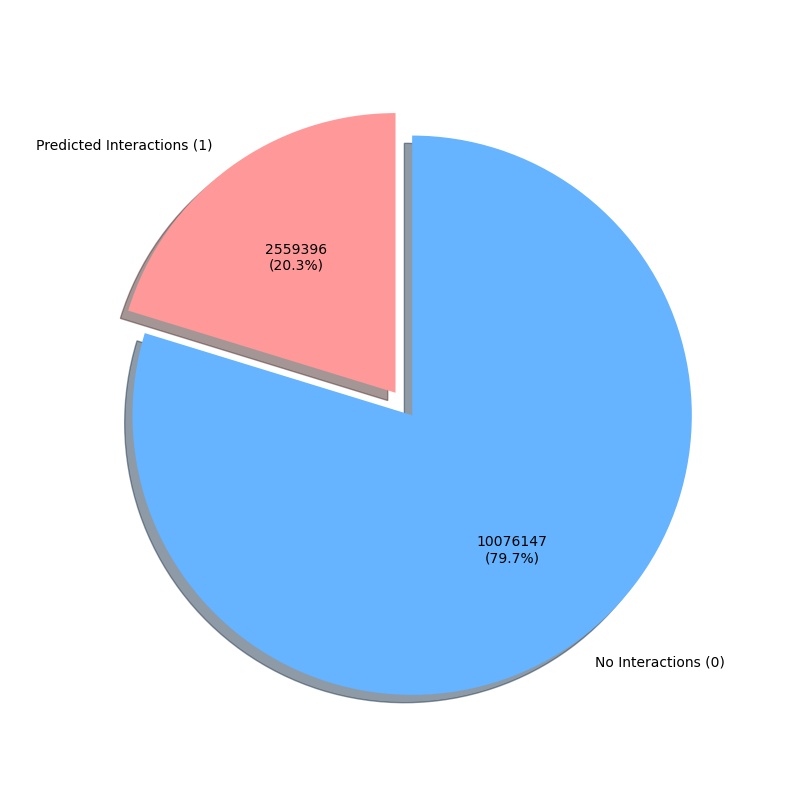

In [87]:
display(Image(plots[0]))

The pie chart above show that the model predicted **_______ positive links**, and **_______ negative links**.

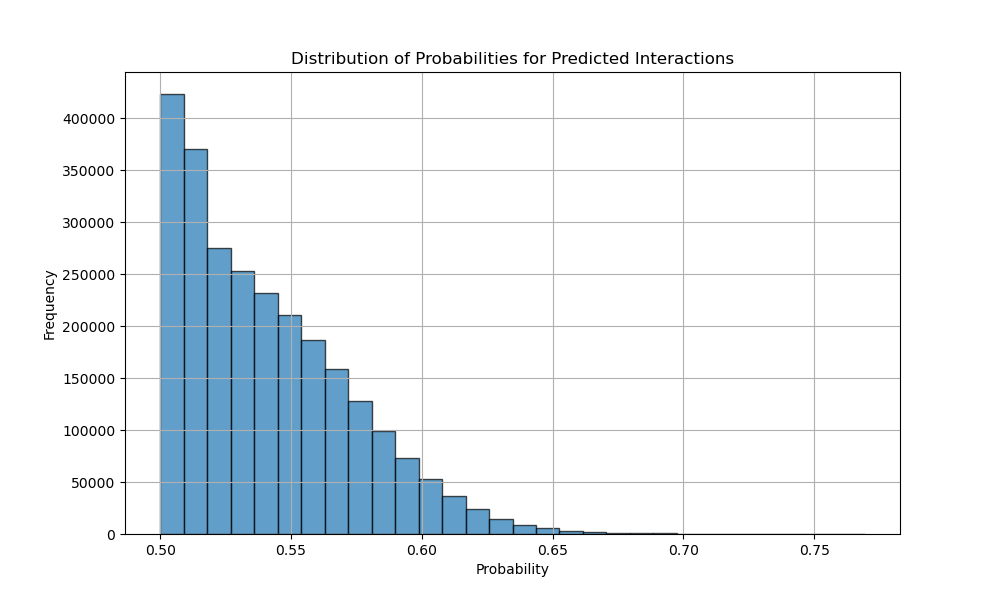

In [88]:
display(Image(plots[1]))

The bar plot instead shows the distribution of probability of any prediction. Consider that function ```filter_rank_drugs()``` only consider prediction with a probability equal or above a certain threshold (```0.65``` by default). 

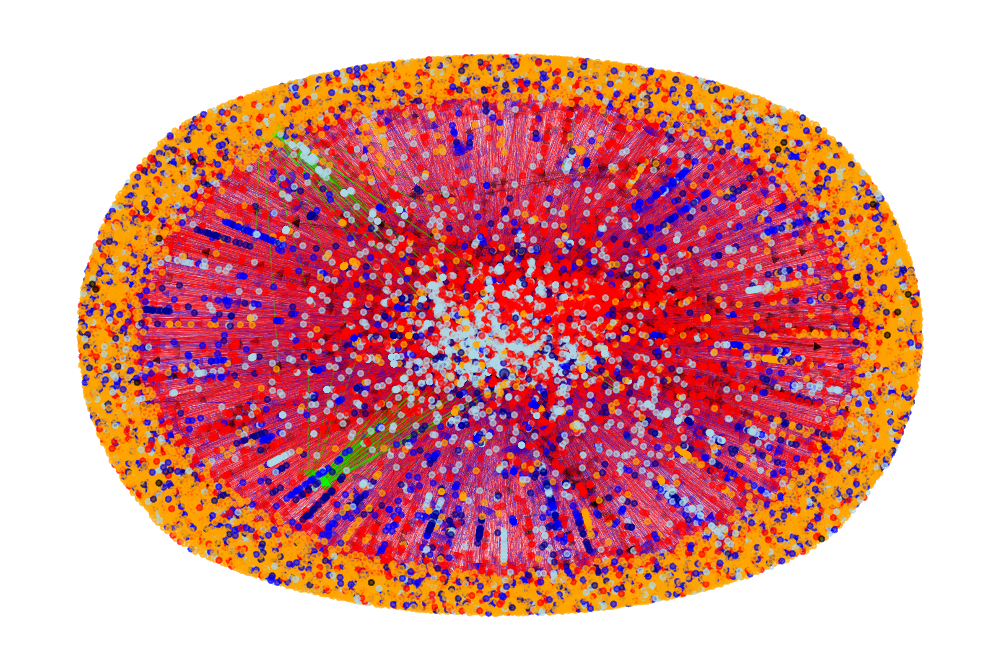

In [89]:
plot_path = os.path.join(network_directory, f'{disease_name_label}_{date_str}_full_network_plot.png')
plot_toggle = 1

if os.path.exists(plot_path) and plot_toggle==1:
    display(Image(filename=plot_path)) #load to save time
else:
    full_network = get_network(network_nodes,network_edges)

    pos = nx.spring_layout(full_network)
    ordered_node_colors = [full_network.nodes[node].get('colour', '#000000') for node in full_network.nodes()]
    node_sizes = [30 if node == 'MONDO:0007739' else 10 for node in full_network.nodes()]
    plt.figure(figsize=(3000/300, 2000/300))  # 300dpi
    nx.draw_networkx_nodes(full_network, pos, node_size=node_sizes, node_color=ordered_node_colors, alpha=0.6)
    for u, v, data in full_network.edges(data=True):
        edge_color = data['colour']
        if edge_color == '#00ff00':  
            nx.draw_networkx_edges(full_network, pos, edgelist=[(u, v)], width=0.8, alpha=0.5, edge_color=edge_color)
        else:  # default properties for other edges
            nx.draw_networkx_edges(full_network, pos, edgelist=[(u, v)], width=0.2, alpha=0.2, edge_color=edge_color)
    plt.axis('off')
    plt.savefig(plot_path, format="png", dpi=300, bbox_inches='tight', pad_inches=0.1, transparent=True)

The unsupervised learning run with a network built with all three layers and DGIdb's new V5 API, and with 'light' parameter optimisation, took about 20 hours (with embeddings fusion, only 30min with embeddings loading), and returned **5 drugs**.

Below some analysis of the composition of edges, to determine how many gene associations per drug, prediction probability distribution and how many drugs were discarded because below the threshold:

In [90]:
pred_network_edges = [edge for edge in network_edges if edge[1]['label'] == 'xgboost:has_association']

unique_genes = {edge[0]['id'] for edge in pred_network_edges}
num_unique_genes = len(unique_genes)
print(f"Number of unique genes: {num_unique_genes}")

unique_drugs = {edge[2]['id'] for edge in pred_network_edges}
num_unique_drugs = len(unique_drugs)
print(f"Number of unique drugs: {num_unique_drugs}")

drug_gene_counts = {}
for edge in pred_network_edges:
    drug_id = edge[2]['id']
    if drug_id in drug_gene_counts:
        drug_gene_counts[drug_id] += 1
    else:
        drug_gene_counts[drug_id] = 1
print("Counts of genes associated with each drug:")
for drug, count in drug_gene_counts.items():
    print(f"{drug}: {count}")

average_genes_per_drug = sum(drug_gene_counts.values()) / len(drug_gene_counts)
print(f"Average number of genes per drug: {average_genes_per_drug:.2f}")

probabilities = [edge[3]['notes'] for edge in pred_network_edges]
total_probability = sum(probabilities)
average_probability = total_probability / len(pred_network_edges)
print(f"Average probability: {average_probability:.4f}")

highest_probability = max(probabilities)
print(f"Highest probability: {highest_probability:.4f}")

Number of unique genes: 224
Number of unique drugs: 5
Counts of genes associated with each drug:
chembl:CHEMBL531401: 80
chembl:CHEMBL592316: 85
chembl:CHEMBL1214407: 75
chembl:CHEMBL301735: 79
chembl:CHEMBL1688243: 80
Average number of genes per drug: 79.80
Average probability: 0.6773
Highest probability: 0.7472


Here's a short code snippet to make a copy of nodes and edges in the network without negative samples, as well as a copy of ranked drugs:

In [91]:
NSless_network_nodes = copy.deepcopy(network_nodes)
NSless_network_edges = copy.deepcopy(network_edges)
NSless_network_drugs = copy.deepcopy(ranked_drugs)

## 7. DATA ANALYSIS: comparison to CR's work

Below a few code snippets to **extrapolate information** from the very few datasets made available by CR: most of them are lost and not available as her original version of the code had a removal step which might make sense when implementing a functional tool –in order to save storage– but which is not great when making a data analysis and a publication.

First let's check the node composition of the first layer in her Monarch API call, as well as how many nodes and edges in total she had:

In [92]:
CR_directory = os.path.join(base_data_directory, 'reference','Huntington disease (2022-06-27)','monarch')

CR_nodes_path = os.path.join(CR_directory, 'monarch_nodes_disease_v2022-06-27.csv')
CR_nodes_df = pd.read_csv(CR_nodes_path)
CR_nodes = CR_nodes_df.to_dict(orient='records')

CR_edges_path = os.path.join(CR_directory, 'monarch_edges_disease_v2022-06-27.csv')
CR_edges_df = pd.read_csv(CR_edges_path)
CR_edges = CR_edges_df.to_dict(orient='records')

In [93]:
CR_URI_counts = {}
for node in CR_nodes:
    if 'id' in node:
        URI = node['id'].split(':')[0]
        if URI in CR_URI_counts:
            CR_URI_counts[URI] += 1
        else:
            CR_URI_counts[URI] = 1
print(CR_URI_counts)

{'MGI': 84, 'MONDO': 2, 'HGNC': 17, 'HP': 68, 'dbSNPIndividual': 9, 'ClinVarVariant': 3, 'REACT': 1, 'dbSNP': 22, 'ENSEMBL': 4, 'WormBase': 2, 'ZFIN': 4, 'FlyBase': 2}


Then let's simulate with the new V5 API the second layer for CR's call based only on one of the ```HP:``` nodes:

In [94]:
seed = 'HP:0001251'  # for Ataxia
rows = 2000
biolink = 'https://api-v3.monarchinitiative.org/v3/api/association'
seed_new = seed.split(':')
seed_call = seed_new[0] + '%3A' + seed_new[1]
parameters = {'fl_excludes_evidence': False, 'rows': rows}
out_url = f'{biolink}?subject={seed_call}'
r_out = requests.get(out_url, params=parameters)
in_url = f'{biolink}?object={seed_call}'
r_in = requests.get(in_url, params=parameters)
CR_out = r_out.json()
CR_in = r_in.json()

CR_edges_list = []
CR_nodes_list = []
for associations in [CR_out['items'], CR_in['items']]:
    for association in associations:
        subj = {'id': association['subject'], 'label': association['subject_label']}
        rel = {'label': association['predicate']}
        obj = {'id': association['object'], 'label': association['object_label']}
        notes = {'notes': 'CR_second_layer'}
        association_elem = [subj, rel, obj, notes]
        CR_edges_list.append(association_elem)
        CR_nodes_list.append(subj)
        CR_nodes_list.append(obj)

CR_nodes_2 = unique_elements(CR_nodes_list)
CR_edges_2 = unique_elements(CR_edges_list)

In [95]:
CR_URI_counts = {}
for node in CR_nodes_2:
    if 'id' in node:
        URI = node['id'].split(':')[0]
        if URI in CR_URI_counts:
            CR_URI_counts[URI] += 1
        else:
            CR_URI_counts[URI] = 1
print(CR_URI_counts)

{'UBERON': 2, 'HGNC': 7, 'HP': 15, 'UPHENO': 2, 'NBO': 1}


In [96]:
print(f"Total number of nodes in CR dataset: {len(CR_nodes_2)+len(CR_nodes)}")
print(f"Total number of edges in CR dataset: {len(CR_edges_2)+len(CR_edges)}")

Total number of nodes in CR dataset: 245
Total number of edges in CR dataset: 628


In [97]:
CR_URI_counts = {}
CR_nodes_total = CR_nodes_2 + CR_nodes
for node in CR_nodes_total:
    if 'id' in node:
        URI = node['id'].split(':')[0]
        if URI in CR_URI_counts:
            CR_URI_counts[URI] += 1
        else:
            CR_URI_counts[URI] = 1
print(CR_URI_counts)

{'UBERON': 2, 'HGNC': 24, 'HP': 83, 'UPHENO': 2, 'NBO': 1, 'MGI': 84, 'MONDO': 2, 'dbSNPIndividual': 9, 'ClinVarVariant': 3, 'REACT': 1, 'dbSNP': 22, 'ENSEMBL': 4, 'WormBase': 2, 'ZFIN': 4, 'FlyBase': 2}


## 8. NEGATIVE LINKS IN ```network_model.py``` (updated)

![](./PIPELINE_images/hubert_et_al-1.png)

Following having solved all the issues with CR's faulty tool, I proceed to **add the 'negative links' step** in the pipeline –based on [Hubert et al. 2024](https://link.springer.com/chapter/10.1007/978-3-031-60626-7_2) ([**github** repository](https://github.com/nicolas-hbt/semantic-lossfunc)) and enrichment of loss of function via embedding in RDFs.

I specifically focused on Hubert's code in files ```neg_freebase.py``` and ```neg_dbpedia.py``` -both of which focus on how to generate negative triples that are both semantically valid, and sementically invalid (*i.e.* the latter also know as **dumb** triples).

The idea is to add a step meant to **discriminate between valid and invalid negative triples**. Hubert's approach is to consider as valid any triple that is semantically valid: therefore anything were each of the elements are in the a specific realm.

Therefore for example given positive triple ```Macron - president - France```:
- triple ```Obama - president - France``` would be considered a semantically valid negative triple, since ```Obama``` is a human;
- while triple ```bread - president - France``` would be considered a semantically invalid negative triple.

![](./PIPELINE_images/negative_samples-5.jpg)

This approach is correct, but also generalised and rather wide in what it accepts as sementically valid. Due to the fact that the pipeline above already encompasses for only finding new links within the ```gene - associated to - drug``` triple structure, considering all links with that same structure as a valid negative link would introduce no change in the model.

We could instead consider a more stringent approach, one where for example given the same ```Macron - president - France``` positive triple:
- triple ```Obama - president - France``` would be considered as invalid as ```bread - president - France```, since Obama is human and a politician, but he's not French;
- while instead **```Le Pen - president - France```** would be considered valid, as she's a French politician, so she could actually potentially become France's president -let's omit any political commentary on that;
- finally ```Depardieu - president - France``` would also be considered invalid as although being French, he's not in politics at the moment –yet conditions for his candidacy are more easily reachable. This introduces yet another distinction between valid and invalid, but this is not necessary for the purpose of this work. 

![](./PIPELINE_images/negative_samples-4.jpg)

Based on this, the idea is to only recognise as a valid negative link a ```gene - associated to - drug``` triple where:
- the subject ```gene``` is a gene node at **```max_distance = 1```** (hardcoded) from a gene in a given positive link triple –therefore either the gene node itself or one of it direct neighbours;
- the object ```drug``` is a drug node directly connected to the drug node in that same given positive link, with **```similarity_score > X```** (user-input, default = 0.9) –therefore again that drug node itself, or one of the most closely resembling drugs according to feature fingerprint ECFP.

In [98]:
# due to issues with Monarch, I tested this section with the edges and nodes from previous runs:
bypass = 0  # (1) to bypass, (0) to use current run
if bypass == 1:
    file_name = "Huntington disease_2024-06-06_drugSim_edges.csv"
    previous_run_path = os.path.join(base_data_directory, "reference", "Huntington disease (2024-06-06)", "drug_similarity", file_name)
    edges_df = pd.read_csv(previous_run_path)
    edges_df = edges_df.map(ast.literal_eval)  # back to dictionaries
    edges = edges_df.apply(lambda row: [row.iloc[0], row.iloc[1], row.iloc[2], row.iloc[3]], axis=1).tolist()
print(edges[:1])

[[{'id': 'MONDO:0007739', 'label': 'Huntington disease'}, {'label': 'biolink:subclass_of'}, {'id': 'MONDO:0005395', 'label': 'movement disorder'}, {'notes': 'first_layer'}]]


In [99]:
node_type_dict = {
        'disease': ['MONDO'],
        'gene': ['HGNC', 'MGI', 'GO', 'NCBIgene', 'ZFIN', 'Xenbase'],
        'phenotype': ['HP'],
        'drug': ['chembl', 'wikidata']
    }

In [100]:
def generate_negative_samples(positive_edges, similarity_threshold=0.90):
    """
    Generate valid negative samples based on the existing edges in the network.

    :param positive_edges: list of edges.
    :param similarity_threshold: minimum similarity score for drug-to-drug subnetwork.
    :return: list of valid negative gene-to-drug edges.
    """

    node_type_dict = {
        'disease': ['MONDO'],
        'gene': ['HGNC', 'MGI', 'GO', 'NCBIgene', 'ZFIN', 'Xenbase'],
        'phenotype': ['HP'],
        'drug': ['chembl', 'wikidata']
    }
    
    gene_to_drug_edges = [edge for edge in positive_edges if 'dgidb:' in edge[1]['label']]
    gene_to_gene_edges = [edge for edge in positive_edges if 'biolink:' in edge[1]['label'] and edge[0]['id'].split(':')[0] in node_type_dict['gene'] and edge[2]['id'].split(':')[0] in node_type_dict['gene']]
    drug_to_drug_edges = [edge for edge in positive_edges if 'smiles:' in edge[1]['label']]
    val_neg_edges = []

    all_genes = []
    all_drugs = []
    for edge in gene_to_gene_edges:
        all_genes.append(edge[0])
        all_genes.append(edge[2])
    for edge in drug_to_drug_edges:
        all_drugs.append(edge[0])
        all_drugs.append(edge[2])
    all_genes = unique_elements(all_genes)
    all_drugs = unique_elements(all_drugs)

    print(f"Total genes: {len(all_genes)}")  # Debugging print
    print(f"Total drugs: {len(all_drugs)}")  # Debugging print

    if not all_genes or not all_drugs:
        print("No genes or drugs found to generate negative samples.")
        return []

    # iterate through gene-to-drug edges to generate valid negative samples
    for edge in gene_to_drug_edges:
        gene = edge[0]
        drug = edge[2]

        # subnetwork of genes
        subnetwork_genes = [gene]
        for g2g_edge in gene_to_gene_edges:
            if g2g_edge[0]['id'] == gene['id']:
                subnetwork_genes.append(g2g_edge[2])
            if g2g_edge[2]['id'] == gene['id']:
                subnetwork_genes.append(g2g_edge[0])
        subnetwork_genes = unique_elements(subnetwork_genes)
        
        # subnetwork of drugs
        subnetwork_drugs = [drug]
        for d2d_edge in drug_to_drug_edges:
            if d2d_edge[0]['id'] == drug['id'] or d2d_edge[2]['id'] == drug['id']:
                similarity_score = float(d2d_edge[3]['notes'].split('similarity score: ')[1])
                if similarity_score >= similarity_threshold:
                    subnetwork_drugs.append(d2d_edge[0])
                    subnetwork_drugs.append(d2d_edge[2])
        subnetwork_drugs = unique_elements(subnetwork_drugs)

        # generate valid negative edges from subnetworks
        for sub_gene in subnetwork_genes:
            for sub_drug in subnetwork_drugs:
                if sub_gene['id'] != gene['id'] or sub_drug['id'] != drug['id']:
                    valid_edge = ([sub_gene,
                                   {'label': 'biolink:valid_negative_association'},
                                   sub_drug,
                                   {'notes': f'related to: {gene["id"]}-{drug["id"]}'}])
                    if valid_edge not in val_neg_edges and valid_edge not in positive_edges:
                        val_neg_edges.append(valid_edge)

    val_neg_edges = unique_elements(val_neg_edges)

    # Compute the total number of possible gene-to-drug combinations
    all_gene_drug_combinations = len(all_genes) * len(all_drugs)
    num_positive_edges = len(gene_to_drug_edges)
    num_valid_negative_edges = len(val_neg_edges)
    num_invalid_negative_edges = all_gene_drug_combinations - num_positive_edges - num_valid_negative_edges

    ## TEMPORARY DEBUGGING
    print(f"Number of valid negative edges: {num_valid_negative_edges}")
    print(f"Number of gene-to-drug edges: {num_positive_edges}")
    print(f"Number of invalid negative edges (calculated): {num_invalid_negative_edges}")
    print(f"Number of negative edges: {num_valid_negative_edges + num_invalid_negative_edges}")

    return val_neg_edges

In [101]:
valid_negative_edges = generate_negative_samples(edges,similarity_threshold=0.90)

Total genes: 2347
Total drugs: 2056
Number of valid negative edges: 66996
Number of gene-to-drug edges: 27284
Number of invalid negative edges (calculated): 4731152
Number of negative edges: 4798148


In [102]:
valid_negative_edges = generate_negative_samples(edges,similarity_threshold=0.75)

Total genes: 2347
Total drugs: 2056
Number of valid negative edges: 68789
Number of gene-to-drug edges: 27284
Number of invalid negative edges (calculated): 4729359
Number of negative edges: 4798148


In [103]:
valid_negative_edges = generate_negative_samples(edges,similarity_threshold=0.5)

Total genes: 2347
Total drugs: 2056
Number of valid negative edges: 82599
Number of gene-to-drug edges: 27284
Number of invalid negative edges (calculated): 4715549
Number of negative edges: 4798148


In [104]:
gene_to_drug_edges = [edge for edge in edges if 'dgidb:' in edge[1]['label']]
gene_to_drug_edges[:2]

[({'id': 'HGNC:5024', 'label': 'HNF4A'},
  {'label': 'dgidb:interacts_with'},
  {'id': 'ncit:C225', 'label': 'RECOMBINANT INTERFERON ALFA'},
  {'notes': 'interactionScore:1.093909817410302'}),
 ({'id': 'HGNC:5024', 'label': 'HNF4A'},
  {'label': 'dgidb:interacts_with'},
  {'id': 'rxcui:84108', 'label': 'ROSIGLITAZONE'},
  {'notes': 'interactionScore:0.2983390411119005'})]

In [105]:
gene_to_gene_edges = [edge for edge in edges if 'biolink:' in edge[1]['label'] and edge[0]['id'].split(':')[0] in node_type_dict['gene'] and edge[2]['id'].split(':')[0] in node_type_dict['gene']]
gene_to_gene_edges[:2]

[[{'id': 'HGNC:3312', 'label': 'ELAVL1'},
  {'label': 'biolink:interacts_with'},
  {'id': 'HGNC:11007', 'label': 'SLC2A3'},
  {'notes': 'second_layer'}],
 [{'id': 'HGNC:18301', 'label': 'SLC2A14'},
  {'label': 'biolink:interacts_with'},
  {'id': 'HGNC:11007', 'label': 'SLC2A3'},
  {'notes': 'second_layer'}]]

In [106]:
gene_to_gene_edges = [edge for edge in edges if 'biolink:' in edge[1]['label']]
gene_to_gene_edges[:2]

[[{'id': 'MONDO:0007739', 'label': 'Huntington disease'},
  {'label': 'biolink:subclass_of'},
  {'id': 'MONDO:0005395', 'label': 'movement disorder'},
  {'notes': 'first_layer'}],
 [{'id': 'MONDO:0007739', 'label': 'Huntington disease'},
  {'label': 'biolink:subclass_of'},
  {'id': 'MONDO:0000167', 'label': 'Huntington disease and related disorders'},
  {'notes': 'first_layer'}]]

In [107]:
drug_to_drug_edges = [edge for edge in edges if 'smiles:' in edge[1]['label']]
drug_to_drug_edges[:2]

[[{'id': 'chembl:CHEMBL272682', 'label': 'CHEMBL:CHEMBL272682'},
  {'label': 'smiles: similar to'},
  {'id': 'chembl:CHEMBL273103', 'label': 'CHEMBL:CHEMBL273103'},
  {'notes': 'similarity score: 0.7714285714285715'}],
 [{'id': 'chembl:CHEMBL272682', 'label': 'CHEMBL:CHEMBL272682'},
  {'label': 'smiles: similar to'},
  {'id': 'chembl:CHEMBL242172', 'label': 'CHEMBL:CHEMBL242172'},
  {'notes': 'similarity score: 0.7027027027027027'}]]

Pipeline runs made after June 30th for some reason return networks without gene nodes.

Let's first assess what's the composition of nodes of such networks at different steps (the following functions will NOT be the docker files: they are only meant for data analysis):

In [108]:
def report_composition(edges_object):
    all_nodes = [edge[0] for edge in edges_object] + [edge[2] for edge in edges_object]
    unique_nodes = unique_elements(all_nodes) # eventually turn into a function (since run_dgidb_api())
    URI_counts = {}
    for node in unique_nodes:
        if 'id' in node:
            URI = node['id'].split(':')[0]
            if URI in URI_counts:
                URI_counts[URI] += 1
            else:
                URI_counts[URI] = 1
    gtg_edges = [edge for edge in edges_object if 'biolink:' in edge[1]['label'] and edge[0]['id'].split(':')[0] in node_type_dict['gene'] and edge[2]['id'].split(':')[0] in node_type_dict['gene']]
    print(f"This is the composition of nodes: {URI_counts}")
    print(f"Out of {len(unique_nodes)} nodes, interconnected by {len(edges_object)} edges. {len(gtg_edges)} of these are gene-to-gene edges ({len(gtg_edges)/len(edges_object)*100}%).")

In [109]:
report_composition(edges)

This is the composition of nodes: {'chembl': 2674, 'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'iuphar.ligand': 2124, 'ncit': 1822, 'UBERON': 174, 'drugbank': 517, 'MP': 304, 'CL': 75, 'GO': 368, 'rxcui': 2230, 'hemonc': 13, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'wikidata': 19, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'drugsatfda.nda': 3, 'ZFA': 5, 'PR': 1, 'SO': 1, 'chemidplus': 2, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}
Out of 17917 nodes, interconnected by 48516 edges. 2910 of these are gene-to-gene edges (5.998021271333168%).


In [110]:
def load_edges(file_path):
    edges_df = pd.read_csv(file_path)
    edges_df = edges_df.map(ast.literal_eval)  # back to dictionaries
    edges = edges_df.apply(lambda row: [row.iloc[0], row.iloc[1], row.iloc[2], row.iloc[3]], axis=1).tolist()
    return edges

In [111]:
file_name = "Huntington disease_2024-06-06_drugSim_edges.csv"
_20240606_run_path = os.path.join(base_data_directory, "reference", "Huntington disease (2024-06-06)", "drug_similarity", file_name)
_20240606_edges = load_edges(_20240606_run_path)
report_composition(_20240606_edges)

This is the composition of nodes: {'drugbank': 101, 'ZFIN': 1, 'MONDO': 160, 'ncit': 380, 'chembl': 515, 'rxcui': 609, 'HGNC': 166, 'FB': 1, 'GO': 4, 'HP': 181, 'iuphar.ligand': 143, 'UPHENO': 30, 'Reactome': 34, 'NBO': 6, 'RGD': 2, 'CHEBI': 34, 'MP': 6, 'OBA': 1, 'wikidata': 3, 'MGI': 5, 'WB': 1, 'BFO': 1, 'UBERON': 3, 'ZP': 2, 'ZFA': 1}
Out of 2390 nodes, interconnected by 3706 edges. 43 of these are gene-to-gene edges (1.1602806260118728%).


In [112]:
file_name = "Huntington disease_2024-06-05_drugSim_edges.csv"
_20240605_run_path = os.path.join(base_data_directory, "reference", "Huntington disease (2024-06-05)", "drug_similarity", file_name)
_20240605_edges = load_edges(_20240605_run_path)
report_composition(_20240605_edges)

This is the composition of nodes: {'drugbank': 101, 'ZFIN': 1, 'MONDO': 160, 'ncit': 380, 'chembl': 515, 'rxcui': 607, 'HGNC': 166, 'FB': 1, 'GO': 4, 'HP': 181, 'iuphar.ligand': 143, 'UPHENO': 30, 'Reactome': 34, 'NBO': 6, 'RGD': 2, 'CHEBI': 34, 'MP': 6, 'OBA': 1, 'wikidata': 3, 'MGI': 5, 'WB': 1, 'BFO': 1, 'UBERON': 3, 'ZP': 2, 'ZFA': 1}
Out of 2388 nodes, interconnected by 3706 edges. 43 of these are gene-to-gene edges (1.1602806260118728%).


In [113]:
file_name = "Huntington disease_2024-07-23_drugSim_edges.csv"
_20240723_run_path = os.path.join(base_data_directory, "reference", "Huntington disease (2024-07-23)", "drug_similarity", file_name)
_20240723_edges = load_edges(_20240723_run_path)
report_composition(_20240723_edges)

This is the composition of nodes: {'MONDO': 834, 'HGNC': 1401, 'HP': 1693, 'ncit': 1449, 'MP': 675, 'UBERON': 186, 'chembl': 2112, 'MGI': 1059, 'drugbank': 422, 'CL': 85, 'UPHENO': 264, 'iuphar.ligand': 1893, 'GO': 280, 'rxcui': 1882, 'EMAPA': 63, 'dictyBase': 17, 'CHEBI': 22, 'ZFIN': 29, 'WB': 21, 'CLINVAR': 26, 'TS': 9, 'PomBase': 11, 'RGD': 33, 'NCBIGene': 6, 'Xenbase': 16, 'FB': 33, 'SGD': 11, 'hemonc': 7, 'NBO': 21, 'OBA': 3, 'drugsatfda.nda': 2, 'PR': 1, 'wikidata': 11, 'SO': 1, 'ZFA': 4, 'chemidplus': 2, 'RO': 1, 'PATO': 3, 'NCBITaxon': 1}
Out of 14589 nodes, interconnected by 35011 edges. 1435 of these are gene-to-gene edges (4.098711833423781%).


Below the new functions to run the network model that takes into account 3 conditions (+1,0,-1) instead of 2 (1,0):

In [114]:
def get_embeddings_with_NS(input_network,emb_t,node_type_select=None):
    '''
    This function builds embeddings (vectors) for node informations -also considering
    the edges they are involved in- from a network object via Node2Vec.
    It can filter to a selected type of nodes

    :param input_network: networkX object.
    :param emb_t: 1 to look for existing embedding files to load instead of generating new ones,
        0 to ignore the loading check.
    :param node_type_select: node type to focus on (default = None): used within run_network_model(),
        not by the user.
    :return: embedding pickle object.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")
    
    global node_type_dict
    valid_node_types = set(node_type_dict.keys())
    
    if node_type_select and node_type_select not in valid_node_types:
        raise ValueError(f"Invalid node_type_select: {node_type_select}. Valid options are: {valid_node_types}")

    # PKL file path
    if node_type_select is not None:
        embedding_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_embedding_dict_NS_{node_type_select}.pkl')
    else:
        embedding_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_embedding_dict_NS_full.pkl')

    # check if they already exist, if toggled
    if emb_t == 1 and os.path.exists(embedding_path):
        print(f"Loading embeddings from existing file: {embedding_path}")
        logging.info(f"Loading embeddings from existing file: {embedding_path}")
        
        with open(embedding_path, "rb") as file:
            output_embeddings = pickle.load(file)

    # otherwise compute
    else:   
        # (eventually) filter nodes
        if node_type_select:
            nodes_to_include = [node for node in input_network.nodes() if input_network.nodes[node].get('node_type') == node_type_select]
            subgraph = input_network.subgraph(nodes_to_include)
        else:
            subgraph = input_network

        # generate node embeddings using Node2Vec
        node2vec = Node2Vec(subgraph, dimensions=64, walk_length=30, num_walks=200, workers=2)
        model = node2vec.fit(window=10, min_count=1, batch_words=4)
        output_embeddings = {node: model.wv[node] for node in subgraph.nodes()}

        # save the embeddings dictionary to a PKL file
        with open(embedding_path, "wb") as file:
            pickle.dump(output_embeddings, file)
        print("PKL files saved in network directory.")
        logging.info("PKL files saved in network directory.")

    return output_embeddings

In [115]:
def is_interaction_present_with_NS(gene_id, drug_id, edges_df):
    # check if the interaction is present and determine the type of interaction
    positive_interaction = (
        ((edges_df['subject_id'] == gene_id) & (edges_df['object_id'] == drug_id) & (edges_df['relation'] != 'biolink:valid_negative_association'))
        | ((edges_df['subject_id'] == drug_id) & (edges_df['object_id'] == gene_id) & (edges_df['relation'] != 'biolink:valid_negative_association'))
    ).any()
    
    valid_negative_interaction = (
        ((edges_df['subject_id'] == gene_id) & (edges_df['object_id'] == drug_id) & (edges_df['relation'] == 'biolink:valid_negative_association'))
        | ((edges_df['subject_id'] == drug_id) & (edges_df['object_id'] == gene_id) & (edges_df['relation'] == 'biolink:valid_negative_association'))
    ).any()
    
    if positive_interaction:
        return 1
    elif valid_negative_interaction:
        return 0
    else:
        return -1
        

def fuse_embeddings_with_NS(gene_embedding_dict, drug_embedding_dict, alldrug_embedding_dict, DGIdb_edges_list, nodes_list, alldrug_nodes_list, emb_t):
    '''
    This function fuses the embeddings for the genes and drugs that have a known link,
    and adds additional drug-gene pairs with random non-known links for prediction.
    Structure of embedding dictionaries: {key: gene/drug, value: embedding}

    :param gene_embedding_dict: all gene embeddings associated with 'input_seed'.
    :param drug_embedding_dict: all drug embeddings associated with 'input_seed'.
    :param alldrug_embedding_dict: all drug embeddings with entire 'DGIdb'.
    :param DGIdb_edges_list: list of gene-to-drug edges from 'run_dgidb()'.
    :param nodes_list: list of nodes associated with 'input_seed'.
    :param alldrug_nodes_list: list of nodes with entire 'DGIdb'.
    :param emb_t: 1 to look for existing embedding files to load instead of generating new ones,
        0 to ignore the loading check.
    :return: dataframes used to train the XGboost model, and subsequently test it.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")

    embedding_start_time = time.time()

    print('Embeddings are being fused, be patient.')

    # CSV file paths
    train_df_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_training_df_with_NS.csv')
    predict_df_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_prediction_df_with_NS.csv')
    
    # check if already present, if toggled:
    if emb_t == 1 and os.path.exists(train_df_path) and os.path.exists(predict_df_path):
        logging.info(f"Loading training and prediction dataframes from existing files: {train_df_path} and {predict_df_path}")
        train_df = pd.read_csv(train_df_path)
        predict_df = pd.read_csv(predict_df_path)

        # Convert fused_embedding column from string to numpy array
        train_df['fused_embedding'] = train_df['fused_embedding'].apply(lambda x: np.fromstring(x.strip('[]'), sep=' '))
        predict_df['fused_embedding'] = predict_df['fused_embedding'].apply(lambda x: np.fromstring(x.strip('[]'), sep=' '))

    # otherwise fuse
    else:
        array_drugs = np.array(list(drug_embedding_dict.keys()))
        array_alldrugs = np.array(list(alldrug_embedding_dict.keys()))
        array_genes = np.array(list(gene_embedding_dict.keys()))

        DGIdb_edges_df = pd.DataFrame({
            'subject_id': [edge[0]['id'] for edge in DGIdb_edges_list],
            'object_id': [edge[2]['id'] for edge in DGIdb_edges_list],
            'relation': [edge[1]['label'] for edge in DGIdb_edges_list]
        })

        # create gene-to-drug interaction dataframe for training
        train_rows = []

        for gene in array_genes:
            gene_emb = gene_embedding_dict[gene]
            for drug in array_drugs:
                fused_emb = np.multiply(gene_emb, drug_embedding_dict[drug])
                class_label = is_interaction_present_with_NS(gene, drug, DGIdb_edges_df)
                train_rows.append({
                    'gene': gene, 'drug': drug, 'fused_embedding': fused_emb, 'class': class_label
                })
        train_df = pd.DataFrame(train_rows)

        # create interaction dataframe for prediction with additional drugs
        predict_rows = []

        for gene in array_genes:
            gene_emb = gene_embedding_dict[gene]
            for drug in array_alldrugs:
                fused_emb = np.multiply(gene_emb, alldrug_embedding_dict[drug])
                predict_rows.append({
                    'gene': gene, 'drug': drug, 'fused_embedding': fused_emb, 'class': np.nan
                })
        predict_df = pd.DataFrame(predict_rows)

        # save the training and prediction dataframes to CSV files
        train_df.to_csv(train_df_path, index=False)
        predict_df.to_csv(predict_df_path, index=False)

    embedding_end_time = time.time()
    duration = embedding_end_time - embedding_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"Embedding fusion finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"Embedding fusion finished in {minutes} minutes and {seconds} seconds.")

    return train_df, predict_df

In [116]:
## version 1, without correctly handling conversion from 3 labels to 2
def ml_prediction_with_NS(train_df,predict_df,param_t,input_jobs=(num_cores // 2),depth='light',input_seed='random'):
    '''
    This function builds a supervised learning model using as training data 
    the network of interactions between biological associations (via 'Monarch.py'),
    gene-to-drug associations (via 'DGIdb.py'), and drug-to-drug similarity (via
    'drug_similarity.py') –to then predict new interactions.
    
    :param train_df: dataframe of (gene, drug, embedding, class) used for training.
    :param predict_df: dataframe of (gene, drug, embedding, class) used for prediction.
    :param param_t: 1 to look for existing optimised parameter file to load instead of performing
        a new parameter optimisation step, 0 to ignore the parameter check.
    :param input_jobs: how many CPU cores to use ('-1' uses all available, just for repetition).
    :param depth: based on this, different sets of parameters, splits, repeats and iterations
        are performed (default = 'full', factor of 'full', 'light' and 'ultralight', just for repetition).
    :param random_seed: seed to have consistent results (default = None, random, just for repetition).
    :return: dataframe of newly predicted interactions.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")

    global nodes
    global drug_nodes

    if input_seed == 'random':
        input_seed = np.random.randint(1, 1e6)

    with open(input_file_path, 'a') as file:
        file.write(f"The XGBoost prediction is run on ({input_jobs}) cores with seed ({input_seed}).\n")
        file.write(f"A ({depth}) parameter optimization step is performed.\n")

    print('ML model is being trained, be patient.')
    ml_train_start_time = time.time()

    # MODEL TRAINING
    # X = embeddings (turn list of embeddings into columns)
    emb_col = train_df['fused_embedding']
    X = pd.DataFrame(emb_col.tolist())
    X = X.astype(float)

    # y = labels
    y = train_df['class'].astype(int)
    unique_classes = np.unique(y)

    # define parameters to be tuned, and model
    if depth == 'full':
        parameters = {
            'min_child_weight': [2, 3, 5, 8, 13, 20, 30],
            'gamma': [0, 0.2, 0.5, 0.8, 1.2, 1.6, 2.5, 4, 6],
            'reg_alpha': [0, 0.5, 1, 3, 5, 10],
            'reg_lambda': [0, 0.5, 1, 3, 5, 10],
            'subsample': uniform(0.5, 0.5),
            'colsample_bytree': uniform(0.2, 0.8),
            'max_depth': [4, 6, 8, 10, 12, 14, 16],
            'n_estimators': [35, 45, 50, 70, 80, 90, 100],
            'learning_rate': uniform(0, 0.3),
        }
        n_s = 10
        n_r = 5
        n_i = 20
    elif depth == 'light':
        parameters = {
            'min_child_weight': [3, 8, 20],
            'gamma': [0.5, 1.2, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20, 30],
            'learning_rate': [0.1],
        }
        n_s = 3
        n_r = 2
        n_i = 5
    elif depth == 'ultralight':
        parameters = {
            'min_child_weight': [5, 20],
            'gamma': [0.5, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20],
            'learning_rate': [0.1],
        }
        n_s = 2
        n_r = 1
        n_i = 5

    params_file_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_hyperparameters.txt')

    # check if the parameters file is already present: if so and if toggled, run with unique parameters
    if param_t==1 and os.path.exists(params_file_path):
        with open(params_file_path, 'r') as file:
            param_dict = ast.literal_eval(file.read())
        parameters = {k: [v] for k, v in param_dict.items()}
        n_s = 2
        n_r = 1
        n_i = 1

    xgb_model_hyp = XGBClassifier(objective='multi:softmax', eval_metric='mlogloss', num_class=len(unique_classes), random_state=input_seed, n_jobs=input_jobs)

    rskf = RepeatedStratifiedKFold(n_splits=n_s, n_repeats=n_r, random_state=input_seed)
    randomized_search = RandomizedSearchCV(xgb_model_hyp, param_distributions=parameters,
                                            scoring='f1_weighted', n_iter=n_i, n_jobs=input_jobs,
                                            error_score='raise', cv=rskf.split(X, y), verbose=1,
                                            refit=True, random_state=input_seed)  # refit: train with best hyperparameters found
    # make sure weights for training are added to avoid unbalanced training
    weight = class_weight.compute_sample_weight('balanced', y)
    randomized_search.fit(X, y, sample_weight=weight)

    # save the best parameters
    best_params = randomized_search.best_params_
    best_score = randomized_search.best_score_
    xgb_model_hyp = randomized_search.best_estimator_
    
    xgb_model_hyp.set_params(**best_params)

    # report best parameters and best model (scores)
    logging.info(f'best found hyperparameters: {best_params}')
    print(f'best found hyperparameters: {best_params}')
    if best_score is not None:
        logging.info(f'score of the model: {best_score}')
        print(f'score of the model: {best_score}')
        with open(input_file_path, 'a') as file:
            file.write(f"The model with parameters ({best_params}) obtained a ({best_score}) score.\n\n")

    ml_train_end_time = time.time()
    duration = ml_train_end_time - ml_train_start_time
    minutes = int(duration // 60)
    seconds = int(duration % 60)
    print(f"XGBoost model training finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"XGBoost model training finished in {minutes} minutes and {seconds} seconds.")

    print('Prediction is being made, be patient.')
    ml_predict_start_time = time.time()

    # remove -1 labels from predict_df
    predict_df_filtered = predict_df[predict_df['class'] != -1]

    # INTERACTION PREDICTION
    emb_col_pred = predict_df_filtered['fused_embedding']
    X_pred = pd.DataFrame(emb_col_pred.tolist())
    X_pred = X_pred.astype(float)
    predictions = xgb_model_hyp.predict(X_pred)
    predictions_prob = xgb_model_hyp.predict_proba(X_pred)
    interaction_predictions_df = pd.DataFrame(
        {'drug': predict_df_filtered['drug'],
         'gene': predict_df_filtered['gene'],
         'predicted_interaction': predictions,
         'prob': np.max(predictions_prob, axis=1)
         })

    # add labels to the drugs and genes for better readability
    all_nodes = nodes + drug_nodes
    id_to_label = {node['id']: node['label'] for node in all_nodes}

    interaction_predictions_df['drug'] = interaction_predictions_df['drug'].apply(
        lambda drug_uri: f'<a href="{drug_uri}">{id_to_label.get(drug_uri, drug_uri)}</a>'
    )
    interaction_predictions_df['gene'] = interaction_predictions_df['gene'].apply(
        lambda gene_uri: f'<a href="{gene_uri}">{id_to_label.get(gene_uri, gene_uri)}</a>'
    )

    # save output files
    interaction_predictions_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_predicted_df.csv')
    interaction_predictions_df.to_csv(interaction_predictions_path, index=False)

    ml_predict_end_time = time.time()
    duration = ml_predict_end_time - ml_predict_start_time
    minutes = int(duration // 60)
    seconds = int(duration % 60)
    print(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")

    return interaction_predictions_df

In [117]:
## version 2, with averaged prediction
def ml_prediction_with_NS(train_df, predict_df, param_t, input_jobs=(num_cores // 2), depth='light', input_seed='random'):
    '''
    This function builds a supervised learning model using as training data 
    the network of interactions between biological associations (via 'Monarch.py'),
    gene-to-drug associations (via 'DGIdb.py'), and drug-to-drug similarity (via
    'drug_similarity.py') –to then predict new interactions.
    
    :param train_df: dataframe of (gene, drug, embedding, class) used for training.
    :param predict_df: dataframe of (gene, drug, embedding, class) used for prediction.
    :param param_t: 1 to look for existing optimised parameter file to load instead of performing
        a new parameter optimisation step, 0 to ignore the parameter check.
    :param input_jobs: how many CPU cores to use ('-1' uses all available, just for repetition).
    :param depth: based on this, different sets of parameters, splits, repeats and iterations
        are performed (default = 'full', factor of 'full', 'light' and 'ultralight', just for repetition).
    :param random_seed: seed to have consistent results (default = None, random, just for repetition).
    :return: dataframe of newly predicted interactions.
    '''

    logging.info(f"NOW RUNNING: {current_function_name()}.")

    global nodes
    global drug_nodes

    if input_seed == 'random':
        input_seed = np.random.randint(1, 1e6)

    with open(input_file_path, 'a') as file:
        file.write(f"The XGBoost prediction is run on ({input_jobs}) cores with seed ({input_seed}).\n")
        file.write(f"A ({depth}) parameter optimization step is performed.\n")

    print('ML model is being trained, be patient.')
    ml_train_start_time = time.time()

    # MODEL TRAINING
    # X = embeddings (turn list of embeddings into columns)
    emb_col = train_df['fused_embedding']
    X = pd.DataFrame(emb_col.tolist())
    X = X.astype(float)

    # y_1: Convert `0` to `1` and `-1` to `0` in train_df (valid negative as positive)
    print('The training dataframe is being converted: "valid negative" to "positive".')
    y_1_start_time = time.time()
    y_1 = train_df['class'].replace({0: 1, -1: 0}).astype(int)
    y_1_end_time = time.time()
    duration = y_1_end_time - y_1_start_time
    minutes = int(duration // 60)
    seconds = int(duration % 60)
    print(f"Conversion finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"Conversion finished in {minutes} minutes and {seconds} seconds.")

    # y_2: Convert only `-1` to `0` in train_df (valid negative as negative)
    print('The training dataframe is being converted: "valid negative" to "negative".')
    y_2_start_time = time.time()
    y_2 = train_df['class'].replace({-1: 0}).astype(int)
    y_2_end_time = time.time()
    duration = y_2_end_time - y_2_start_time
    minutes = int(duration // 60)
    seconds = int(duration % 60)
    print(f"Conversion finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"Conversion finished in {minutes} minutes and {seconds} seconds.")

    # define parameters to be tuned, and model
    if depth == 'full':
        parameters = {
            'min_child_weight': [2, 3, 5, 8, 13, 20, 30],
            'gamma': [0, 0.2, 0.5, 0.8, 1.2, 1.6, 2.5, 4, 6],
            'reg_alpha': [0, 0.5, 1, 3, 5, 10],
            'reg_lambda': [0, 0.5, 1, 3, 5, 10],
            'subsample': uniform(0.5, 0.5),
            'colsample_bytree': uniform(0.2, 0.8),
            'max_depth': [4, 6, 8, 10, 12, 14, 16],
            'n_estimators': [35, 45, 50, 70, 80, 90, 100],
            'learning_rate': uniform(0, 0.3),
        }
        n_s = 10
        n_r = 5
        n_i = 20
    elif depth == 'light':
        parameters = {
            'min_child_weight': [3, 8, 20],
            'gamma': [0.5, 1.2, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20, 30],
            'learning_rate': [0.1],
        }
        n_s = 3
        n_r = 2
        n_i = 5
    elif depth == 'ultralight':
        parameters = {
            'min_child_weight': [5, 20],
            'gamma': [0.5, 2.5],
            'reg_alpha': [1, 5],
            'reg_lambda': [1, 5],
            'subsample': [0.5],
            'colsample_bytree': [0.7],
            'max_depth': [3, 5],
            'n_estimators': [10, 20],
            'learning_rate': [0.1],
        }
        n_s = 2
        n_r = 1
        n_i = 5

    params_file_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_hyperparameters.txt')

    # check if the parameters file is already present: if so and if toggled, run with unique parameters
    if param_t == 1 and os.path.exists(params_file_path):
        with open(params_file_path, 'r') as file:
            param_dict = ast.literal_eval(file.read())
        parameters = {k: [v] for k, v in param_dict.items()}
        n_s = 2
        n_r = 1
        n_i = 1

    # define and train model on y_1
    xgb_model_hyp_1 = XGBClassifier(objective='multi:softmax', eval_metric='mlogloss', num_class=2, random_state=input_seed, n_jobs=input_jobs)
    rskf_1 = RepeatedStratifiedKFold(n_splits=n_s, n_repeats=n_r, random_state=input_seed)
    randomized_search_1 = RandomizedSearchCV(xgb_model_hyp_1, param_distributions=parameters,
                                             scoring='f1_weighted', n_iter=n_i, n_jobs=input_jobs,
                                             error_score='raise', cv=rskf_1.split(X, y_1), verbose=1,
                                             refit=True, random_state=input_seed)
    weight_1 = class_weight.compute_sample_weight('balanced', y_1)
    randomized_search_1.fit(X, y_1, sample_weight=weight_1)
    best_model_1 = randomized_search_1.best_estimator_

    # define and train model on y_2
    xgb_model_hyp_2 = XGBClassifier(objective='multi:softmax', eval_metric='mlogloss', num_class=2, random_state=input_seed, n_jobs=input_jobs)
    rskf_2 = RepeatedStratifiedKFold(n_splits=n_s, n_repeats=n_r, random_state=input_seed)
    randomized_search_2 = RandomizedSearchCV(xgb_model_hyp_2, param_distributions=parameters,
                                             scoring='f1_weighted', n_iter=n_i, n_jobs=input_jobs,
                                             error_score='raise', cv=rskf_2.split(X, y_2), verbose=1,
                                             refit=True, random_state=input_seed)
    weight_2 = class_weight.compute_sample_weight('balanced', y_2)
    randomized_search_2.fit(X, y_2, sample_weight=weight_2)
    best_model_2 = randomized_search_2.best_estimator_

    # prediction and averaging the results
    print('Prediction is being made, be patient.')
    ml_predict_start_time = time.time()

    # INTERACTION PREDICTION
    predict_df_filtered = predict_df.copy()
    emb_col_pred = predict_df_filtered['fused_embedding']
    X_pred = pd.DataFrame(emb_col_pred.tolist())
    X_pred = X_pred.astype(float)

    predictions_1 = best_model_1.predict(X_pred)
    predictions_prob_1 = best_model_1.predict_proba(X_pred)

    predictions_2 = best_model_2.predict(X_pred)
    predictions_prob_2 = best_model_2.predict_proba(X_pred)

    # logical 'OR' for predictions: 1 if either model predicts 1
    final_predictions = (predictions_1 | predictions_2)

    # AVERAGE the prediction probabilities
    averaged_predictions_prob = (predictions_prob_1 + predictions_prob_2) / 2

    interaction_predictions_df = pd.DataFrame(
        {'drug': predict_df_filtered['drug'],
         'gene': predict_df_filtered['gene'],
         'predicted_interaction': final_predictions,
         'prob': np.max(averaged_predictions_prob, axis=1)
         })

    # add labels to the drugs and genes for better readability
    all_nodes = nodes + drug_nodes
    id_to_label = {node['id']: node['label'] for node in all_nodes}

    interaction_predictions_df['drug'] = interaction_predictions_df['drug'].apply(
        lambda drug_uri: f'<a href="{drug_uri}">{id_to_label.get(drug_uri, drug_uri)}</a>'
    )
    interaction_predictions_df['gene'] = interaction_predictions_df['gene'].apply(
        lambda gene_uri: f'<a href="{gene_uri}">{id_to_label.get(gene_uri, gene_uri)}</a>'
    )

    # save output files
    interaction_predictions_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_predicted_df.csv')
    interaction_predictions_df.to_csv(interaction_predictions_path, index=False)

    ml_predict_end_time = time.time()
    duration = ml_predict_end_time - ml_predict_start_time
    minutes = int(duration // 60)
    seconds = int(duration % 60)
    print(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"XGBoost model prediction finished in {minutes} minutes and {seconds} seconds.")

    return interaction_predictions_df

In [118]:
def run_network_model_with_NS(monarch_input,date,run_jobs=None,run_depth=None,run_seed=None,prob_input=None,clust_input=None,emb_toggle=1,param_toggle=1,ou_toggle=1):
    '''
    This function runs the entire network_model script and saves nodes and edges files
    after a prediction made via XGBoost.

    :param monarch_input: the input seed from the run_monarch() step.
    :param date: the date of creation of the disease graph.
    :param run_jobs: any value that would override default input_jobs=(num_cores//2) in 
        ml_prediction().
    :param run_depth: any value that would override default depth='full' in ml_prediction_with_NS().
    :param run_seed: any value that would override default random_seed=123 in ml_prediction_with_NS().
    :param prob_input: any value that would override default prob_threshold=0.65 in filter_rank_drugs().
    :param clust_input: any value that would override default cluster_threshold=0.8 in filter_rank_drugs().
    :param emb_toggle: 1 to look for existing embedding files to load instead of generating new ones,
        0 to ignore the loading check in get_embeddings_with_NS() and fuse_embeddings_with_NS().
    :param param_toggle: 1 to look for existing optimised parameter file to load instead of performing
        a new parameter optimisation step, 0 to ignore the parameter check in ml_prediction_with_NS().
    :param out_toggle: 1 to consider over clust_input, 0 to consider under clust_input in filter_rank_drugs().
    :return: list of edges after the prediction, list of nodes after the prediction, list of newly
        repurposed drugs found by the prediction.
    '''

    start_time = time.time()
    
    logging.info(f"NOW RUNNING: {current_function_name()} following 'drug_similarity({monarch_input},{today},min_simil={input_min_simil})'.")
    
    global nodes, edges, drug_nodes, drug_edges

    node_type_dict = {
        'disease': ['MONDO'],
        'gene': ['HGNC', 'MGI', 'GO', 'NCBIgene', 'ZFIN', 'Xenbase'],
        'phenotype': ['HP'],
        'drug': ['chembl', 'wikidata']
    }
    
    network_with_NS_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'network_with_NS')
    os.makedirs(network_with_NS_directory, exist_ok=True)

    # generate networks for biological associations and drug database
    embedding_start_time = time.time()
    print('Embeddings are being generated, be patient.')
    
    full_network = get_network(nodes,edges)
    partial_alldrug_network = get_network(drug_nodes,drug_edges,exclude='dgidb:')
    
    drug_embeddings = get_embeddings_with_NS(full_network,emb_toggle,node_type_select='drug')
    alldrug_embeddings = get_embeddings_with_NS(partial_alldrug_network,emb_toggle,node_type_select='drug')
    gene_embeddings = get_embeddings_with_NS(full_network,emb_toggle,node_type_select='gene')

    embedding_end_time = time.time()
    duration = embedding_end_time - embedding_start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"Embedding generation finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"Embedding generation finished in {minutes} minutes and {seconds} seconds.")

    DGIdb_edges = [edge for edge in edges if 'dgidb' in edge[1]['label']]
    training_df, prediction_df = fuse_embeddings_with_NS(gene_embeddings,drug_embeddings,alldrug_embeddings,DGIdb_edges,nodes,drug_nodes,emb_toggle)

    # train the model and make the predictions
    if not run_seed:
        run_seed = 'random'
    if not run_depth:
        run_depth = 'light'
    if not run_jobs:
        run_jobs = (num_cores//2)
    predicted_df = ml_prediction_with_NS(training_df,prediction_df,param_toggle,input_jobs=run_jobs,depth=run_depth,input_seed=run_seed)

    # report the total number of predicted edges ahead of filtering and ranking
    total_predicted_edges = len(predicted_df)
    print(f"Total number of predicted edges (both positive and negative): {total_predicted_edges}")
    logging.info(f"Total number of predicted edges (both positive and negative): {total_predicted_edges}")
    
    # generate prediction outcome proportion plot (BEFORE)
    num_ones = (predicted_df['predicted_interaction'] == 1).sum()
    num_zeros = (predicted_df['predicted_interaction'] == 0).sum()
    plt.figure(figsize=(8, 8))
    labels = 'Predicted Positive Interactions (1)', 'Predicted Negative Interactions (0)'
    sizes = [num_ones, num_zeros]
    colors = ['#ff9999', '#66b3ff']
    explode = (0.1, 0)
    plt.pie(sizes, explode=explode, labels=labels, colors=colors,
            autopct=lambda val: absolute_value(val, sizes), shadow=True, startangle=90)
    plt.axis('equal')
    pie_chart_path_1 = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_interaction_pie_chart-1.png')
    plt.savefig(pie_chart_path_1, transparent=True)
    plt.close()
    
    # generate prediction probability distribution plot (BEFORE)
    interaction_df = predicted_df[predicted_df['predicted_interaction'] == 1]
    interaction_probs = interaction_df['prob']
    plt.figure(figsize=(10, 6))
    plt.hist(interaction_probs, bins=30, edgecolor='k', alpha=0.7)
    plt.title('Distribution of Probabilities for Predicted Interactions (ahead of filtering)')
    plt.xlabel('Probability')
    plt.ylabel('Frequency')
    plt.grid(True)
    hist_plot_path_1 = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_probability_distribution-1.png')
    plt.savefig(hist_plot_path_1, transparent=True)
    plt.close()

    # generate a distribution plot for how many genes per drug (BEFORE)
    nodes_set = {node['id'] for node in nodes}
    prefiltered_df = predicted_df[(predicted_df['predicted_interaction'] == 1) & (~predicted_df['drug'].isin(nodes_set))]
    gene_counts_per_drug = prefiltered_df['drug'].value_counts()
    plt.figure(figsize=(10, 6))
    plt.hist(gene_counts_per_drug, bins=30, edgecolor='k', alpha=0.7)
    plt.title('Distribution of Gene Counts per Drug (ahead of filtering)')
    plt.xlabel('Number of Genes per Drug')
    plt.ylabel('Frequency')
    plt.grid(True)
    gene_count_hist_plot_path_1 = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_gene_counts_per_drug-1.png')
    plt.savefig(gene_count_hist_plot_path_1, transparent=True)
    plt.close()

    plot_paths = [pie_chart_path_1, hist_plot_path_1, gene_count_hist_plot_path_1]

    # rank newly found / re-purposed drugs (from prediction)
    if not prob_input:
        prob_input = 0.65
    if not clust_input:
        clust_input = 0.8
    ranked_drug_list, predicted_edges = filter_rank_drugs(predicted_df,prob_threshold=prob_input,cluster_threshold=clust_input,over_under=ou_toggle)
    
    # generate prediction outcome proportion plot (AFTER)
    filtered_num_ones = len(predicted_edges)
    filtered_num_zeros = num_ones - filtered_num_ones
    plt.figure(figsize=(8, 8))
    labels = 'Filtered Out Positive Interactions (1)', 'Predicted Positive Interactions (1)', 'Predicted Negative Interactions (0)'
    sizes = [filtered_num_zeros, filtered_num_ones, num_zeros]
    colors = ['#ff9999', '#66b3ff', '#999999']
    explode = (0.1, 0, 0)
    plt.pie(sizes, explode=explode, labels=labels, colors=colors,
            autopct=lambda val: absolute_value(val, sizes), shadow=True, startangle=90)
    plt.axis('equal')
    pie_chart_path_2 = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_interaction_pie_chart-2.png')
    plt.savefig(pie_chart_path_2, transparent=True)
    plt.close()

    # generate prediction probability distribution plot (AFTER)
    filtered_probs = pd.Series([edge[3]['notes'] for edge in predicted_edges])
    plt.figure(figsize=(10, 6))
    plt.hist(filtered_probs, bins=30, edgecolor='k', alpha=0.7)
    plt.title('Distribution of Probabilities for Predicted Interactions (after filtering)')
    plt.xlabel('Probability')
    plt.ylabel('Frequency')
    plt.grid(True)
    hist_plot_path_2 = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_probability_distribution-2.png')
    plt.savefig(hist_plot_path_2, transparent=True)
    plt.close()

    # generate a distribution plot for how many genes per drug (AFTER)
    filtered_df = pd.DataFrame(predicted_edges)
    filtered_gene_counts_per_drug = filtered_df[2].value_counts()
    plt.figure(figsize=(10, 6))
    plt.hist(filtered_gene_counts_per_drug, bins=30, edgecolor='k', alpha=0.7)
    plt.title('Distribution of Gene Counts per Drug (after filtering)')
    plt.xlabel('Number of Genes per Drug')
    plt.ylabel('Frequency')
    plt.grid(True)
    gene_count_hist_plot_path_2 = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_gene_counts_per_drug-2.png')
    plt.savefig(gene_count_hist_plot_path_2, transparent=True)
    plt.close()

    plot_paths.extend([pie_chart_path_2, hist_plot_path_2, gene_count_hist_plot_path_2])
    
    for ranked_drug_elem in ranked_drug_list:
        logging.info(f"{ranked_drug_elem['count']} new edge(s) for drug {ranked_drug_elem['id']}.")
        print(f"{ranked_drug_elem['count']} new edge(s) for drug {ranked_drug_elem['id']}.")
    
    full_edges = edges + drug_edges + predicted_edges
    full_nodes = [edge[0] for edge in full_edges] + [edge[2] for edge in full_edges]
    full_nodes = unique_elements(full_nodes)

    # save nodes and edges as CSV
    full_edges_df = pd.DataFrame(full_edges)
    full_edges_df.to_csv(os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_fullnetwork_edges.csv'), index=False)
    full_nodes_df = pd.DataFrame(full_nodes)
    full_nodes_df.to_csv(os.path.join(network_directory, f'{disease_name_label}_{date_str}_fullnetwork_nodes.csv'), index=False)
    
    logging.info("CSV files saved in network directory.")

    end_time = time.time()
    duration = end_time - start_time  # calculate duration in seconds
    minutes = int(duration // 60)  # convert seconds to whole minutes
    seconds = int(duration % 60)  # get the remaining seconds
    print(f"'network_model.py' run finished in {minutes} minutes and {seconds} seconds.")
    logging.info(f"'network_model.py' run finished in {minutes} minutes and {seconds} seconds.")
    
    return full_edges, full_nodes, ranked_drug_list, plot_paths

In [119]:
predict_df_toggle = 0
if predict_df_toggle == 1:
    network_with_NS_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'network_with_NS')
    predict_df_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_prediction_df_with_NS.csv')
    full_network = get_network(nodes,edges)
    partial_alldrug_network = get_network(drug_nodes,drug_edges,exclude='dgidb:')
    print('Networks generated.')
    emb_toggle = 1
    alldrug_embedding_dict = get_embeddings_with_NS(partial_alldrug_network,emb_toggle,node_type_select='drug')
    gene_embedding_dict = get_embeddings_with_NS(full_network,emb_toggle,node_type_select='gene')
    print('All embeddings loaded.')
    DGIdb_edges = [edge for edge in edges if 'dgidb' in edge[1]['label']]
    DGIdb_edges_df = pd.DataFrame({
        'subject_id': [edge[0]['id'] for edge in DGIdb_edges],
        'object_id': [edge[2]['id'] for edge in DGIdb_edges],
        'relation': [edge[1]['label'] for edge in DGIdb_edges]
    })
    predict_rows = []
    array_genes = np.array(list(gene_embedding_dict.keys()))
    array_alldrugs = np.array(list(alldrug_embedding_dict.keys()))
    for gene in array_genes:
        gene_emb = gene_embedding_dict[gene]
        for drug in array_alldrugs:
            fused_emb = np.multiply(gene_emb, alldrug_embedding_dict[drug])
            predict_rows.append({
                'gene': gene, 
                'drug': drug, 
                'fused_embedding': fused_emb, 
                'class': np.nan
            })
    predict_df = pd.DataFrame(predict_rows)
    predict_df.to_csv(predict_df_path, index=False)

And finally a prediction run also with valid negative samples:

In [120]:
#valid_negative_edges = generate_negative_samples(edges,similarity_threshold=0.90)
network_with_NS_directory = os.path.join(today_directory, f'{disease_name_label} ({date_str})', 'network_with_NS')
edges = edges + valid_negative_edges
edges = unique_elements(edges)

network_edges, network_nodes, ranked_drugs, plots = run_network_model_with_NS(input_seed,today,run_jobs=num_jobs,run_depth=depth_input,run_seed=seed_input)

Embeddings are being generated, be patient.
Loading embeddings from existing file: /Users/ncmbianchi/DrugRepurposing/NOT_TO_PUSH/NICCOLOs/PIPELINE/drugapp/data/2024-07-31/Huntington disease (2024-07-31)/network_with_NS/Huntington disease_2024-07-31_embedding_dict_NS_drug.pkl
Loading embeddings from existing file: /Users/ncmbianchi/DrugRepurposing/NOT_TO_PUSH/NICCOLOs/PIPELINE/drugapp/data/2024-07-31/Huntington disease (2024-07-31)/network_with_NS/Huntington disease_2024-07-31_embedding_dict_NS_drug.pkl
Loading embeddings from existing file: /Users/ncmbianchi/DrugRepurposing/NOT_TO_PUSH/NICCOLOs/PIPELINE/drugapp/data/2024-07-31/Huntington disease (2024-07-31)/network_with_NS/Huntington disease_2024-07-31_embedding_dict_NS_gene.pkl
Embedding generation finished in 0 minutes and 0 seconds.
Embeddings are being fused, be patient.
Embedding fusion finished in 8 minutes and 45 seconds.
ML model is being trained, be patient.
The training dataframe is being converted: "valid negative" to "posi

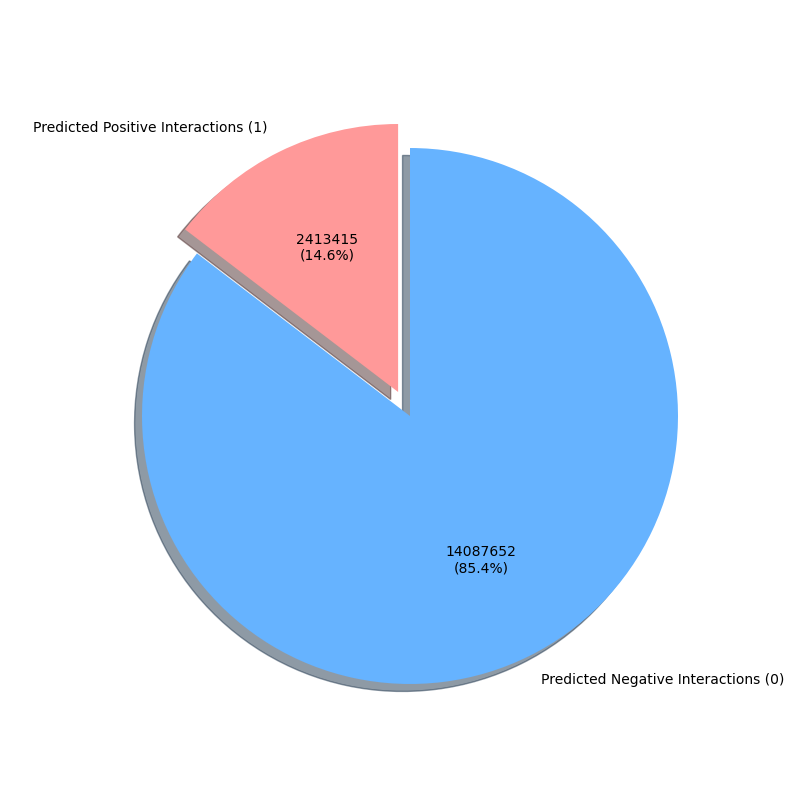

In [121]:
display(Image(plots[0]))

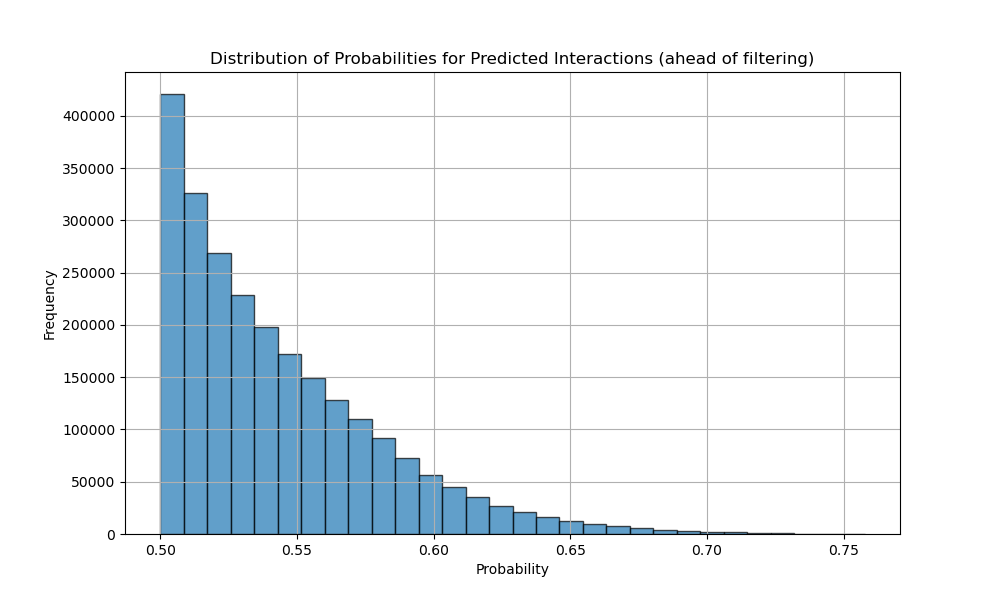

In [122]:
display(Image(plots[1]))

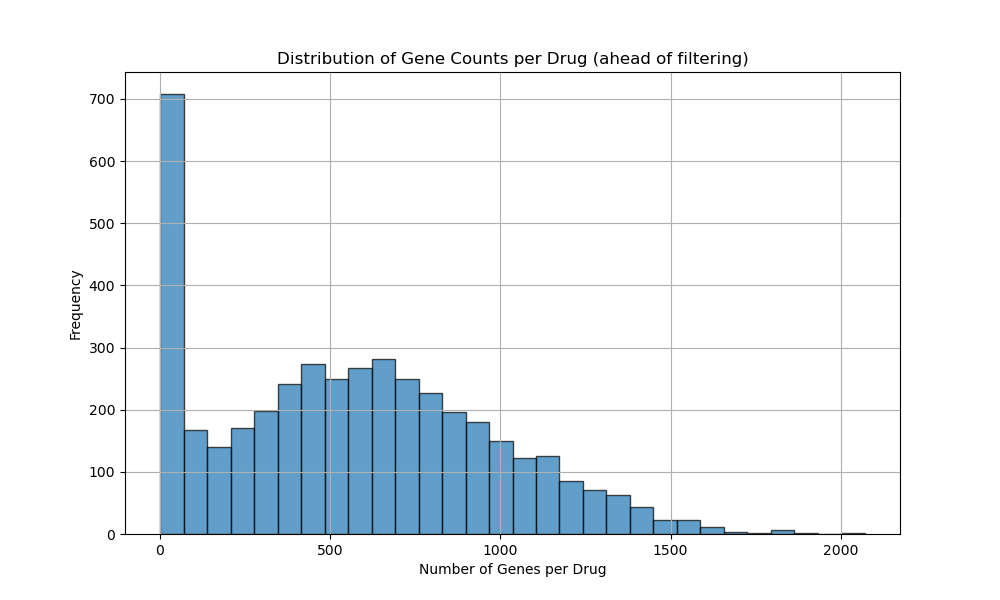

In [123]:
display(Image(plots[2]))

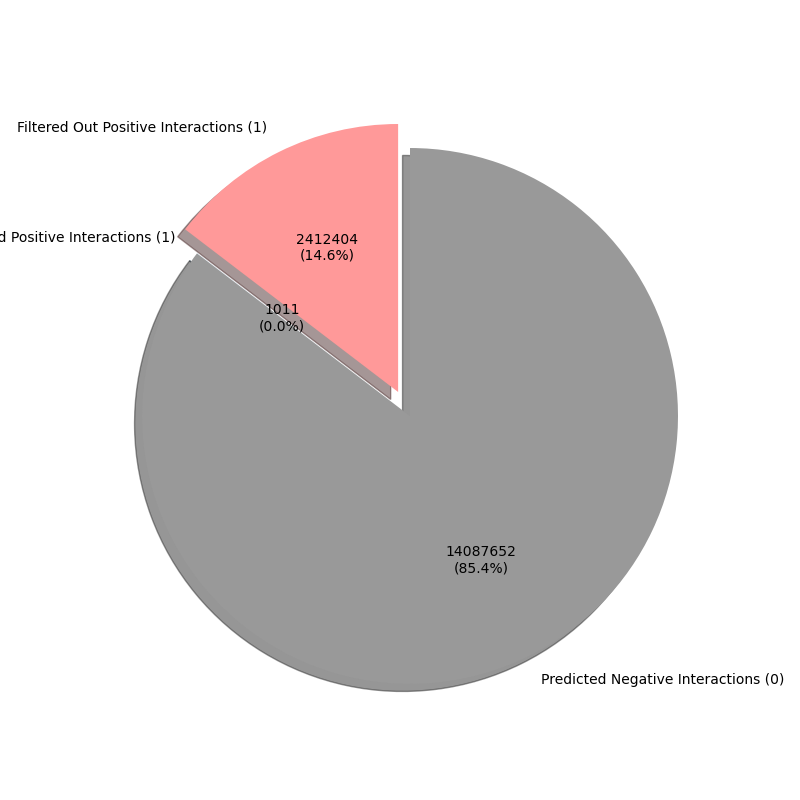

In [124]:
display(Image(plots[3]))

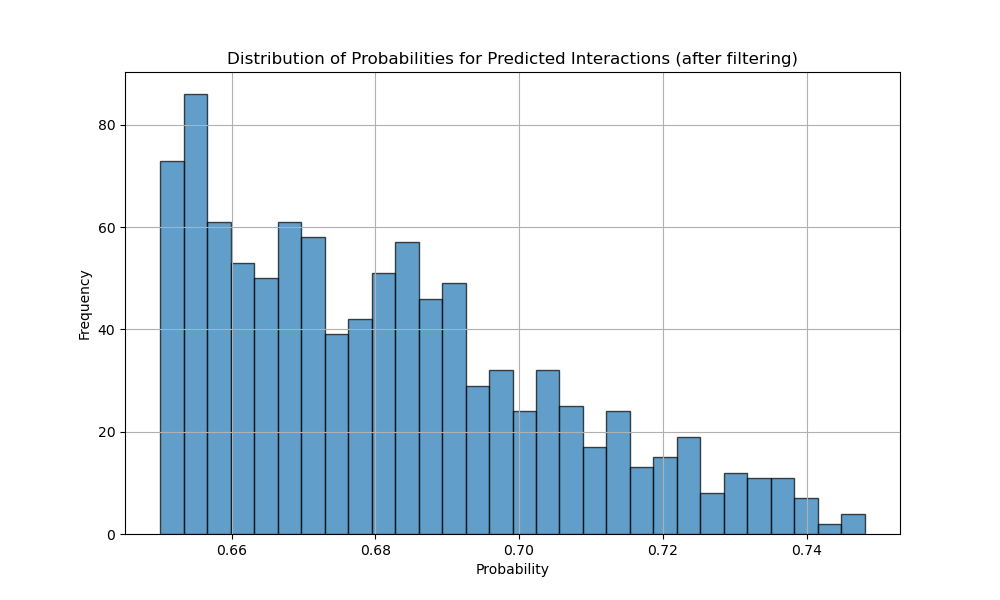

In [125]:
display(Image(plots[4]))

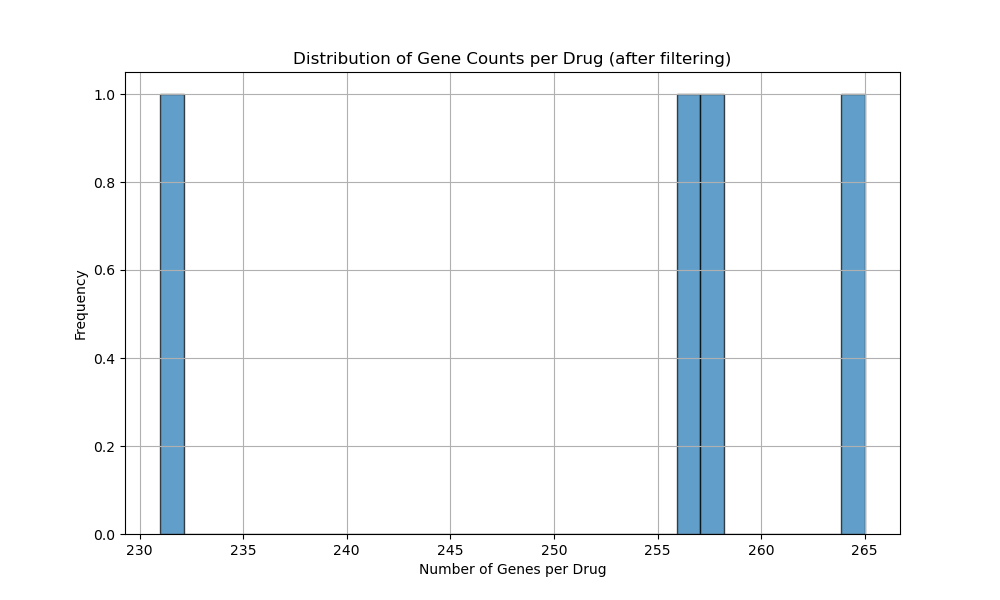

In [126]:
display(Image(plots[5]))

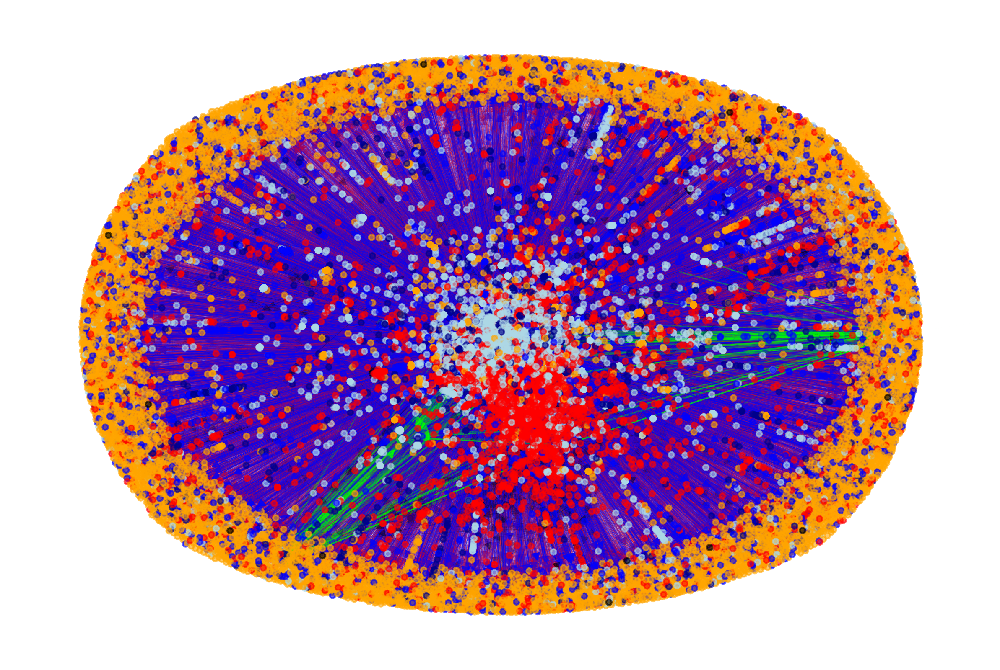

In [127]:
plot_path = os.path.join(network_with_NS_directory, f'{disease_name_label}_{date_str}_full_network_plot_with_NS.png')
plot_toggle = 1

if os.path.exists(plot_path) and plot_toggle==1:
    display(Image(filename=plot_path)) #load to save time
else:
    full_network = get_network(network_nodes,network_edges)

    pos = nx.spring_layout(full_network)
    ordered_node_colors = [full_network.nodes[node].get('colour', '#000000') for node in full_network.nodes()]
    node_sizes = [30 if node == 'MONDO:0007739' else 10 for node in full_network.nodes()]
    plt.figure(figsize=(3000/300, 2000/300))  # 300dpi
    nx.draw_networkx_nodes(full_network, pos, node_size=node_sizes, node_color=ordered_node_colors, alpha=0.6)
    for u, v, data in full_network.edges(data=True):
        edge_color = data['colour']
        if edge_color == '#00ff00':  
            nx.draw_networkx_edges(full_network, pos, edgelist=[(u, v)], width=0.8, alpha=0.5, edge_color=edge_color)
        else:  # default properties for other edges
            nx.draw_networkx_edges(full_network, pos, edgelist=[(u, v)], width=0.2, alpha=0.2, edge_color=edge_color)
    plt.axis('off')
    plt.savefig(plot_path, format="png", dpi=300, bbox_inches='tight', pad_inches=0.1, transparent=True)

In [128]:
pred_network_edges = [edge for edge in network_edges if edge[1]['label'] == 'xgboost:has_association']

unique_genes = {edge[0]['id'] for edge in pred_network_edges}
num_unique_genes = len(unique_genes)
print(f"Number of unique genes: {num_unique_genes}")

unique_drugs = {edge[2]['id'] for edge in pred_network_edges}
num_unique_drugs = len(unique_drugs)
print(f"Number of unique drugs: {num_unique_drugs}")

drug_gene_counts = {}
for edge in pred_network_edges:
    drug_id = edge[2]['id']
    if drug_id in drug_gene_counts:
        drug_gene_counts[drug_id] += 1
    else:
        drug_gene_counts[drug_id] = 1
print("Counts of genes associated with each drug:")
for drug, count in drug_gene_counts.items():
    print(f"{drug}: {count}")

average_genes_per_drug = sum(drug_gene_counts.values()) / len(drug_gene_counts)
print(f"Average number of genes per drug: {average_genes_per_drug:.2f}")

probabilities = [edge[3]['notes'] for edge in pred_network_edges]
total_probability = sum(probabilities)
average_probability = total_probability / len(pred_network_edges)
print(f"Average probability: {average_probability:.4f}")

highest_probability = max(probabilities)
print(f"Highest probability: {highest_probability:.4f}")

Number of unique genes: 507
Number of unique drugs: 4
Counts of genes associated with each drug:
chembl:CHEMBL535051: 258
chembl:CHEMBL1256995: 257
chembl:CHEMBL531451: 231
chembl:CHEMBL60796: 265
Average number of genes per drug: 252.75
Average probability: 0.6816
Highest probability: 0.7481


Here's the same code snippet as before, to report nodes, edges and drugs **with negative samples**:

In [129]:
NS_network_nodes = copy.deepcopy(network_nodes)
NS_network_edges = copy.deepcopy(network_edges)
NS_network_drugs = copy.deepcopy(ranked_drugs)

Below, a custom script to generate a simpler network graph only comprising the subnetwork of disease input, predicted drug, associated genes and the few nodes in between genes and disease input:

In [130]:
## I have to finish writing this: might help have a more easily readable graph
# also, fix the location of the network graph and of pkl files FIXED
# ADD module just for location name generation, to avoid issues

## 9. DATA ANALYSIS: final remarks

Here's the composition of nodes and edges in the **Monarch Initiative network (3 degrees of distance)**:

In [131]:
print(f"The final network is made up of {len(monarch_3layer_nodes)} nodes and {len(monarch_3layer_edges)} edges.\n")

node_type_counts = {}
for node in monarch_3layer_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'monarch_3layer_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in monarch_3layer_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'monarch_3layer_edges': \n{edge_type_counts}")

The final network is made up of 8513 nodes and 13600 edges.

Here are the node types in 'monarch_3layer_nodes': 
{'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'UBERON': 174, 'MP': 304, 'CL': 75, 'GO': 368, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'ZFA': 5, 'PR': 1, 'SO': 1, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}

Here are the edge types in 'monarch_3layer_edges': 
{'biolink:subclass_of': 2338, 'biolink:has_phenotype': 5452, 'biolink:related_to': 556, 'biolink:has_mode_of_inheritance': 158, 'biolink:causes': 174, 'biolink:gene_associated_with_condition': 88, 'biolink:treats_or_applied_or_studied_to_treat': 489, 'biolink:model_of': 288, 'biolink:interacts_with': 2484, 'biolink:participates_in': 685, 'biolink:orthologous_to': 238, 'biolink:active_i

Here's the composition of nodes and edges in the **Monarch Initiative network (2 degrees of distance)**:

In [132]:
print(f"The final network is made up of {len(monarch_2layer_nodes)} nodes and {len(monarch_2layer_edges)} edges.\n")

node_type_counts = {}
for node in monarch_2layer_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'monarch_2layer_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in monarch_2layer_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'monarch_2layer_edges': \n{edge_type_counts}")

The final network is made up of 732 nodes and 832 edges.

Here are the node types in 'monarch_2layer_nodes': 
{'GO': 7, 'HP': 204, 'UBERON': 11, 'MONDO': 231, 'Reactome': 42, 'UPHENO': 28, 'MP': 27, 'HGNC': 112, 'FB': 1, 'CHEBI': 42, 'MGI': 18, 'OBA': 2, 'RGD': 1, 'CL': 1, 'dictyBase': 1, 'NBO': 2, 'WB': 1, 'ZP': 1}

Here are the edge types in 'monarch_2layer_edges': 
{'biolink:subclass_of': 196, 'biolink:has_phenotype': 359, 'biolink:related_to': 87, 'biolink:has_mode_of_inheritance': 22, 'biolink:causes': 1, 'biolink:gene_associated_with_condition': 2, 'biolink:treats_or_applied_or_studied_to_treat': 53, 'biolink:model_of': 17, 'biolink:interacts_with': 46, 'biolink:participates_in': 42, 'biolink:orthologous_to': 5, 'biolink:active_in': 1, 'biolink:actively_involved_in': 1}


Here's the composition of nodes and edges in the **DGIdb network (3 degrees of distance)**:

In [133]:
print(f"The final network is made up of {len(dgidb_3layer_nodes)} nodes and {len(dgidb_3layer_edges)} edges.\n")

node_type_counts = {}
for node in dgidb_3layer_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'dgidb_3layer_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in dgidb_3layer_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'dgidb_3layer_edges': \n{edge_type_counts}")

The final network is made up of 17917 nodes and 40884 edges.

Here are the node types in 'dgidb_3layer_nodes': 
{'chembl': 2674, 'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'iuphar.ligand': 2124, 'ncit': 1822, 'UBERON': 174, 'drugbank': 517, 'MP': 304, 'CL': 75, 'GO': 368, 'rxcui': 2230, 'hemonc': 13, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'wikidata': 19, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'drugsatfda.nda': 3, 'ZFA': 5, 'PR': 1, 'SO': 1, 'chemidplus': 2, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}

Here are the edge types in 'dgidb_3layer_edges': 
{'biolink:subclass_of': 2338, 'biolink:has_phenotype': 5452, 'biolink:related_to': 556, 'biolink:has_mode_of_inheritance': 158, 'biolink:causes': 174, 'biolink:gene_associated_with_condition': 88, 'biolink:treats_or_applied_or_studied_to_

Here's the composition of nodes and edges in the **DGIdb network (2 degrees of distance)**:

In [134]:
print(f"The final network is made up of {len(dgidb_2layer_nodes)} nodes and {len(dgidb_2layer_edges)} edges.\n")

node_type_counts = {}
for node in dgidb_2layer_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'dgidb_2layer_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in dgidb_2layer_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'dgidb_2layer_edges': \n{edge_type_counts}")

The final network is made up of 1826 nodes and 2420 edges.

Here are the node types in 'dgidb_2layer_nodes': 
{'drugbank': 59, 'rxcui': 368, 'MONDO': 231, 'MP': 27, 'ncit': 224, 'HP': 204, 'chembl': 318, 'HGNC': 112, 'FB': 1, 'GO': 7, 'iuphar.ligand': 122, 'Reactome': 42, 'UPHENO': 28, 'CHEBI': 42, 'OBA': 2, 'UBERON': 11, 'hemonc': 1, 'MGI': 18, 'WB': 1, 'wikidata': 2, 'NBO': 2, 'RGD': 1, 'dictyBase': 1, 'ZP': 1, 'CL': 1}

Here are the edge types in 'dgidb_2layer_edges': 
{'biolink:subclass_of': 196, 'biolink:has_phenotype': 359, 'biolink:related_to': 87, 'biolink:has_mode_of_inheritance': 22, 'biolink:causes': 1, 'biolink:gene_associated_with_condition': 2, 'biolink:treats_or_applied_or_studied_to_treat': 53, 'biolink:model_of': 17, 'biolink:interacts_with': 46, 'biolink:participates_in': 42, 'biolink:orthologous_to': 5, 'biolink:active_in': 1, 'biolink:actively_involved_in': 1, 'dgidb:interacts_with': 1588}


Here's the composition of nodes and edges in the **drugs-only network from DGIdb**:

In [135]:
print(f"The final network is made up of {len(drug_nodes)} nodes and 0 edges.\n")

node_type_counts = {}
for node in drug_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'drug_nodes': \n{node_type_counts}\n")

The final network is made up of 53048 nodes and 0 edges.

Here are the node types in 'drug_nodes': 
{'rxcui': 22801, 'ncit': 11031, 'drugbank': 2771, 'iuphar.ligand': 3333, 'chembl': 13015, 'hemonc': 20, 'wikidata': 56, 'drugsatfda.nda': 14, 'drugsatfda.anda': 4, 'chemidplus': 3}



Here's the composition of nodes and edges in the **drug similarity network (3 degrees of distance), with 0.75 threshold**:

In [136]:
print(f"The final network is made up of {len(drugsimil_075_nodes)} nodes and {len(drugsimil_075_edges)} edges.\n")

node_type_counts = {}
for node in drugsimil_075_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'drugsimil_075_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in drugsimil_075_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'drugsimil_075_edges': \n{edge_type_counts}")

The final network is made up of 17917 nodes and 41199 edges.

Here are the node types in 'drugsimil_075_nodes': 
{'chembl': 2674, 'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'iuphar.ligand': 2124, 'ncit': 1822, 'UBERON': 174, 'drugbank': 517, 'MP': 304, 'CL': 75, 'GO': 368, 'rxcui': 2230, 'hemonc': 13, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'wikidata': 19, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'drugsatfda.nda': 3, 'ZFA': 5, 'PR': 1, 'SO': 1, 'chemidplus': 2, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}

Here are the edge types in 'drugsimil_075_edges': 
{'biolink:subclass_of': 2338, 'biolink:has_phenotype': 5452, 'biolink:related_to': 556, 'biolink:has_mode_of_inheritance': 158, 'biolink:causes': 174, 'biolink:gene_associated_with_condition': 88, 'biolink:treats_or_applied_or_studied_t

Here's the composition of nodes and edges in the **drug similarity network (2 degrees of distance), with 0.75 threshold**:

In [137]:
print(f"The final network is made up of {len(sml_drugsimil_075_nodes)} nodes and {len(sml_drugsimil_075_edges)} edges.\n")

node_type_counts = {}
for node in sml_drugsimil_075_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'sml_drugsimil_075_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in sml_drugsimil_075_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'sml_drugsimil_075_edges': \n{edge_type_counts}")

The final network is made up of 1826 nodes and 2435 edges.

Here are the node types in 'sml_drugsimil_075_nodes': 
{'drugbank': 59, 'rxcui': 368, 'MONDO': 231, 'MP': 27, 'ncit': 224, 'HP': 204, 'chembl': 318, 'HGNC': 112, 'FB': 1, 'GO': 7, 'iuphar.ligand': 122, 'Reactome': 42, 'UPHENO': 28, 'CHEBI': 42, 'OBA': 2, 'UBERON': 11, 'hemonc': 1, 'MGI': 18, 'WB': 1, 'wikidata': 2, 'NBO': 2, 'RGD': 1, 'dictyBase': 1, 'ZP': 1, 'CL': 1}

Here are the edge types in 'sml_drugsimil_075_edges': 
{'biolink:subclass_of': 196, 'biolink:has_phenotype': 359, 'biolink:related_to': 87, 'biolink:has_mode_of_inheritance': 22, 'biolink:causes': 1, 'biolink:gene_associated_with_condition': 2, 'biolink:treats_or_applied_or_studied_to_treat': 53, 'biolink:model_of': 17, 'biolink:interacts_with': 46, 'biolink:participates_in': 42, 'biolink:orthologous_to': 5, 'biolink:active_in': 1, 'biolink:actively_involved_in': 1, 'dgidb:interacts_with': 1588, 'smiles: similar to': 15}


Here's the composition of nodes and edges in the **drug similarity network (drugs-only), with 0.75 threshold**:

In [138]:
print(f"The final network is made up of {len(alldrugsimil_075_nodes)} nodes and {len(alldrugsimil_075_edges)} edges.\n")

node_type_counts = {}
for node in alldrugsimil_075_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'alldrugsimil_075_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in alldrugsimil_075_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'alldrugsimil_075_edges': \n{edge_type_counts}")

The final network is made up of 53048 nodes and 475 edges.

Here are the node types in 'alldrugsimil_075_nodes': 
{'rxcui': 22801, 'ncit': 11031, 'drugbank': 2771, 'iuphar.ligand': 3333, 'chembl': 13015, 'hemonc': 20, 'wikidata': 56, 'drugsatfda.nda': 14, 'drugsatfda.anda': 4, 'chemidplus': 3}

Here are the edge types in 'alldrugsimil_075_edges': 
{'smiles: similar to': 475}


Here's the composition of nodes and edges in the **drug similarity network (3 degrees of distance), with 0.5 threshold**:

In [139]:
print(f"The final network is made up of {len(drugsimil_050_nodes)} nodes and {len(drugsimil_050_edges)} edges.\n")

node_type_counts = {}
for node in drugsimil_050_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'drugsimil_050_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in drugsimil_050_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'drugsimil_050_edges': \n{edge_type_counts}")

The final network is made up of 17917 nodes and 42590 edges.

Here are the node types in 'drugsimil_050_nodes': 
{'chembl': 2674, 'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'iuphar.ligand': 2124, 'ncit': 1822, 'UBERON': 174, 'drugbank': 517, 'MP': 304, 'CL': 75, 'GO': 368, 'rxcui': 2230, 'hemonc': 13, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'wikidata': 19, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'drugsatfda.nda': 3, 'ZFA': 5, 'PR': 1, 'SO': 1, 'chemidplus': 2, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}

Here are the edge types in 'drugsimil_050_edges': 
{'biolink:subclass_of': 2338, 'biolink:has_phenotype': 5452, 'biolink:related_to': 556, 'biolink:has_mode_of_inheritance': 158, 'biolink:causes': 174, 'biolink:gene_associated_with_condition': 88, 'biolink:treats_or_applied_or_studied_t

Here's the composition of nodes and edges in the **drug similarity network (2 degrees of distance), with 0.5 threshold**:

In [140]:
print(f"The final network is made up of {len(sml_drugsimil_050_nodes)} nodes and {len(sml_drugsimil_050_edges)} edges.\n")

node_type_counts = {}
for node in sml_drugsimil_050_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'sml_drugsimil_050_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in sml_drugsimil_050_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'sml_drugsimil_050_edges': \n{edge_type_counts}")

The final network is made up of 1826 nodes and 2466 edges.

Here are the node types in 'sml_drugsimil_050_nodes': 
{'drugbank': 59, 'rxcui': 368, 'MONDO': 231, 'MP': 27, 'ncit': 224, 'HP': 204, 'chembl': 318, 'HGNC': 112, 'FB': 1, 'GO': 7, 'iuphar.ligand': 122, 'Reactome': 42, 'UPHENO': 28, 'CHEBI': 42, 'OBA': 2, 'UBERON': 11, 'hemonc': 1, 'MGI': 18, 'WB': 1, 'wikidata': 2, 'NBO': 2, 'RGD': 1, 'dictyBase': 1, 'ZP': 1, 'CL': 1}

Here are the edge types in 'sml_drugsimil_050_edges': 
{'biolink:subclass_of': 196, 'biolink:has_phenotype': 359, 'biolink:related_to': 87, 'biolink:has_mode_of_inheritance': 22, 'biolink:causes': 1, 'biolink:gene_associated_with_condition': 2, 'biolink:treats_or_applied_or_studied_to_treat': 53, 'biolink:model_of': 17, 'biolink:interacts_with': 46, 'biolink:participates_in': 42, 'biolink:orthologous_to': 5, 'biolink:active_in': 1, 'biolink:actively_involved_in': 1, 'dgidb:interacts_with': 1588, 'smiles: similar to': 46}


Here's the composition of nodes and edges in the **drug similarity network (drugs-only), with 0.5 threshold**:

In [141]:
print(f"The final network is made up of {len(alldrugsimil_050_nodes)} nodes and {len(alldrugsimil_050_edges)} edges.\n")

node_type_counts = {}
for node in alldrugsimil_050_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'alldrugsimil_050_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in alldrugsimil_050_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'alldrugsimil_050_edges': \n{edge_type_counts}")

The final network is made up of 53048 nodes and 3037 edges.

Here are the node types in 'alldrugsimil_050_nodes': 
{'rxcui': 22801, 'ncit': 11031, 'drugbank': 2771, 'iuphar.ligand': 3333, 'chembl': 13015, 'hemonc': 20, 'wikidata': 56, 'drugsatfda.nda': 14, 'drugsatfda.anda': 4, 'chemidplus': 3}

Here are the edge types in 'alldrugsimil_050_edges': 
{'smiles: similar to': 3037}


Here's the composition of nodes and edges in the **drug similarity network (3 degrees of distance), with 0.3 threshold**:

In [142]:
print(f"The final network is made up of {len(drugsimil_030_nodes)} nodes and {len(drugsimil_030_edges)} edges.\n")

node_type_counts = {}
for node in drugsimil_030_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'drugsimil_030_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in drugsimil_030_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'drugsimil_030_edges': \n{edge_type_counts}")

The final network is made up of 17917 nodes and 48516 edges.

Here are the node types in 'drugsimil_030_nodes': 
{'chembl': 2674, 'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'iuphar.ligand': 2124, 'ncit': 1822, 'UBERON': 174, 'drugbank': 517, 'MP': 304, 'CL': 75, 'GO': 368, 'rxcui': 2230, 'hemonc': 13, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'wikidata': 19, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'drugsatfda.nda': 3, 'ZFA': 5, 'PR': 1, 'SO': 1, 'chemidplus': 2, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}

Here are the edge types in 'drugsimil_030_edges': 
{'biolink:subclass_of': 2338, 'biolink:has_phenotype': 5452, 'biolink:related_to': 556, 'biolink:has_mode_of_inheritance': 158, 'biolink:causes': 174, 'biolink:gene_associated_with_condition': 88, 'biolink:treats_or_applied_or_studied_t

Here's the composition of nodes and edges in the **drug similarity network (2 degrees of distance), with 0.3 threshold**:

In [143]:
print(f"The final network is made up of {len(sml_drugsimil_030_nodes)} nodes and {len(sml_drugsimil_030_edges)} edges.\n")

node_type_counts = {}
for node in sml_drugsimil_030_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'sml_drugsimil_030_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in sml_drugsimil_030_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'sml_drugsimil_030_edges': \n{edge_type_counts}")

The final network is made up of 1826 nodes and 2622 edges.

Here are the node types in 'sml_drugsimil_030_nodes': 
{'drugbank': 59, 'rxcui': 368, 'MONDO': 231, 'MP': 27, 'ncit': 224, 'HP': 204, 'chembl': 318, 'HGNC': 112, 'FB': 1, 'GO': 7, 'iuphar.ligand': 122, 'Reactome': 42, 'UPHENO': 28, 'CHEBI': 42, 'OBA': 2, 'UBERON': 11, 'hemonc': 1, 'MGI': 18, 'WB': 1, 'wikidata': 2, 'NBO': 2, 'RGD': 1, 'dictyBase': 1, 'ZP': 1, 'CL': 1}

Here are the edge types in 'sml_drugsimil_030_edges': 
{'biolink:subclass_of': 196, 'biolink:has_phenotype': 359, 'biolink:related_to': 87, 'biolink:has_mode_of_inheritance': 22, 'biolink:causes': 1, 'biolink:gene_associated_with_condition': 2, 'biolink:treats_or_applied_or_studied_to_treat': 53, 'biolink:model_of': 17, 'biolink:interacts_with': 46, 'biolink:participates_in': 42, 'biolink:orthologous_to': 5, 'biolink:active_in': 1, 'biolink:actively_involved_in': 1, 'dgidb:interacts_with': 1588, 'smiles: similar to': 202}


Here's the composition of nodes and edges in the **drug similarity network (drugs-only), with 0.3 threshold**:

In [144]:
print(f"The final network is made up of {len(alldrugsimil_030_nodes)} nodes and {len(alldrugsimil_030_edges)} edges.\n")

node_type_counts = {}
for node in alldrugsimil_030_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'alldrugsimil_030_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in alldrugsimil_030_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'alldrugsimil_030_edges': \n{edge_type_counts}")

The final network is made up of 53048 nodes and 13774 edges.

Here are the node types in 'alldrugsimil_030_nodes': 
{'rxcui': 22801, 'ncit': 11031, 'drugbank': 2771, 'iuphar.ligand': 3333, 'chembl': 13015, 'hemonc': 20, 'wikidata': 56, 'drugsatfda.nda': 14, 'drugsatfda.anda': 4, 'chemidplus': 3}

Here are the edge types in 'alldrugsimil_030_edges': 
{'smiles: similar to': 13774}


Here's the composition of nodes and edges in the **final network** without negative samples, along with the predicted drugs:

In [145]:
print(f"The final network is made up of {len(NSless_network_nodes)} nodes and {len(NSless_network_edges)} edges.\n")

node_type_counts = {}
for node in NSless_network_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'NSless_network_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in NSless_network_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'NSless_network_edges': \n{edge_type_counts}")

print(f"These are the predicted drugs: \n{NSless_network_drugs}")

The final network is made up of 19095 nodes and 62689 edges.

Here are the node types in 'NSless_network_nodes': 
{'chembl': 3851, 'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'iuphar.ligand': 2124, 'ncit': 1822, 'UBERON': 174, 'drugbank': 517, 'MP': 304, 'CL': 75, 'GO': 368, 'rxcui': 2230, 'hemonc': 13, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'wikidata': 20, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'drugsatfda.nda': 3, 'ZFA': 5, 'PR': 1, 'SO': 1, 'chemidplus': 2, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}

Here are the edge types in 'NSless_network_edges': 
{'biolink:subclass_of': 2338, 'biolink:has_phenotype': 5452, 'biolink:related_to': 556, 'biolink:has_mode_of_inheritance': 158, 'biolink:causes': 174, 'biolink:gene_associated_with_condition': 88, 'biolink:treats_or_applied_or_studied

Here's the composition of nodes and edges in the **final network with negative samples**, along with the predicted drugs:

In [146]:
print(f"The final network is made up of {len(NS_network_nodes)} nodes and {len(NS_network_edges)} edges.\n")

node_type_counts = {}
for node in NS_network_nodes:
    if 'id' in node:
        node_type = node['id'].split(':')[0]
        if node_type in node_type_counts:
            node_type_counts[node_type] += 1
        else:
            node_type_counts[node_type] = 1
print(f"Here are the node types in 'NS_network_nodes': \n{node_type_counts}\n")

edge_type_counts = {}
for edge in NS_network_edges:
    relation_dict = edge[1]
    if 'label' in relation_dict:
        relation = relation_dict['label']
        if relation in edge_type_counts:
            edge_type_counts[relation] += 1
        else:
            edge_type_counts[relation] = 1
print(f"Here are the edge types in 'NS_network_edges': \n{edge_type_counts}")

print(f"These are the predicted drugs: \n{NS_network_drugs}")

The final network is made up of 19094 nodes and 142629 edges.

Here are the node types in 'NS_network_nodes': 
{'chembl': 3850, 'MONDO': 1169, 'HGNC': 2386, 'HP': 1824, 'iuphar.ligand': 2124, 'ncit': 1822, 'UBERON': 174, 'drugbank': 517, 'MP': 304, 'CL': 75, 'GO': 368, 'rxcui': 2230, 'hemonc': 13, 'CHEBI': 483, 'EMAPA': 63, 'MGI': 768, 'Xenbase': 27, 'ZFIN': 88, 'dictyBase': 24, 'RGD': 94, 'NCBIGene': 84, 'WB': 53, 'UPHENO': 187, 'OBA': 32, 'Reactome': 77, 'CLINVAR': 73, 'SGD': 19, 'TS': 9, 'FB': 77, 'PomBase': 16, 'wikidata': 20, 'FBbt': 3, 'NBO': 16, 'CA2586970245': 1, 'drugsatfda.nda': 3, 'ZFA': 5, 'PR': 1, 'SO': 1, 'chemidplus': 2, 'NCBITaxon': 3, 'RO': 1, 'BFO': 1, 'PATO': 4, 'ECTO': 1, 'ZP': 2}

Here are the edge types in 'NS_network_edges': 
{'biolink:subclass_of': 2338, 'biolink:has_phenotype': 5452, 'biolink:related_to': 556, 'biolink:has_mode_of_inheritance': 158, 'biolink:causes': 174, 'biolink:gene_associated_with_condition': 88, 'biolink:treats_or_applied_or_studied_to_tre

In [147]:
predicted_edges = [edge for edge in NS_network_edges if 'xgboost' in edge[1]['label']]
predicted_edges[1]

[{'id': 'HGNC:5434', 'label': 'IFNB1'},
 {'label': 'xgboost:has_association'},
 {'id': 'chembl:CHEMBL535051', 'label': 'CHEMBL:CHEMBL535051'},
 {'notes': 0.652572512626648}]

## 10. ```routes.py```: DOCKER IMAGE / FLASK APP

Lastly:
- place the HTML sections in file ```routes.py```, not in single function files
- define which **parameters** would be set in the FlaskApp (*e.g.* seed, how many layers...)

Below the code snippet checking for the entire duration of the pipeline to this point:

In [148]:
overall_end_time = time.time()
overall_duration = overall_end_time - overall_start_time  # calculate duration in seconds
minutes = int(overall_duration // 60)  # convert seconds to whole minutes
seconds = int(overall_duration % 60)  # get the remaining seconds
print(f"PIPELINE run finished in {minutes} minutes and {seconds} seconds.")
logging.info(f"PIPELINE run finished in {minutes} minutes and {seconds} seconds.")

PIPELINE run finished in 124 minutes and 49 seconds.
